### Dependencies

In [1]:
import nbformat as nbf
from glob import glob

import uuid
def get_cell_id(id_length=8):
    return uuid.uuid4().hex[:id_length]

# your notebook name/keyword
nb_name = 'my_notebook'
notebooks = list(filter(lambda x: nb_name in x, glob("./*.ipynb", recursive=True)))

# iterate over notebooks
for ipath in sorted(notebooks):
    # load notebook
    ntbk = nbf.read(ipath, nbf.NO_CONVERT)
    
    cell_ids = []
    for cell in ntbk.cells:
        cell_ids.append(cell['id'])

    # reset cell ids if there are duplicates
    if not len(cell_ids) == len(set(cell_ids)): 
        for cell in ntbk.cells:
            cell['id'] = get_cell_id()

        nbf.write(ntbk, ipath)

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
#sns.set_style('ticks')
sns.set_style('white')
import os
import math
import shutil
from mldeconv.cells_calculation import predict
from scipy.stats import mannwhitneyu, gmean, gaussian_kde, zscore
from tqdm import tqdm_notebook
from sklearn.metrics import roc_auc_score
from mldeconv.cells_plotting import print_cell
import warnings
from pathlib import Path
from IPython.display import display
from tqdm import tqdm_notebook

warnings.filterwarnings('ignore')

%config InlineBackend.figure_format = 'retina'
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', -1)

import bioreactor
from bioreactor.plotting import *
from bioreactor.use_colors import *
from bioreactor.annotation import *
from bioreactor.utils import *
from bioreactor.gsea import *
from bioreactor.graphs import *
from bioreactor.gsea import *
from bioreactor.pathway_scoring import *
from bioreactor.mutations import *
from bioreactor.ssgsea import *
from bioreactor.lollipop import *
from bioreactor.clustering import *
from bioreactor.expression import  *
from bioreactor.survival import  *
from bioreactor.pub_classify import *
from bioreactor.oncoplot2 import *
from bioreactor.cna import *
from bioreactor.qc import *
from bioreactor.cohort_data import *
bioreactor.__version__


'0.1.78'

In [3]:
from bioreactor.plotting import axis_matras, line_palette_annotation_plot, lin_colors, patch_plot

In [4]:
import mldeconv
from mldeconv.cells_calculation import predict_cells_by_xgb
from mldeconv.data_loading import read_expressions

In [5]:
from mldeconv.models.tumor_model import TumorModel
import yaml

model = TumorModel.load('/uftp/Deconvolution/product/new_models/blood_cd4mem_v1')

In [6]:
def get_gspread(table, sheet, index_col='Sample', path_to_json=None): 
    """
    Access Google Sheets via python
    
    :param path_to_json: absolute path to JSON containing creditials for Google API
    :param table: Annotation calculated, for instance
    :param sheet: Blood, for instance
    :param index_col: column number
    :return: pandas DataFrame
    """
    from oauth2client.service_account import ServiceAccountCredentials
    import gspread
    
    if path_to_json == None:
        path_to_json = '/uftp/Blood/google_secret.json'

    credentials = ServiceAccountCredentials.from_json_keyfile_name(
        path_to_json)  # Your json file here
    gc = gspread.authorize(credentials)

    # open table
    wks = gc.open(table)
    # select sheet
    sheet = wks.worksheet(sheet)
    data = pd.DataFrame(sheet.get_all_records())
    data = data.set_index(index_col)
    return data

In [7]:
import rpy2.robjects as ro 
from rpy2.robjects import pandas2ri
from rpy2.robjects.conversion import localconverter

def edgeR_DE(df, ranges):
    """
    Run edgeR for DE
    :param df: pd.concat([group1, group2], axis=1), expression should be in counts
    :param ranges: string, like '21x24'
    """
    
    pandas2ri.activate()
    try:
        run_edgeR_DE = ro.r(
        """
        function(df, ranges) {
            
            library(edgeR)

            # Extract the experimental design
            design = unlist(strsplit(ranges, 'x'))

            # Find the desing counts.
            cond1_num = as.integer(design[1])
            cond2_num = as.integer(design[2])

            # Set up the conditions based on the experimental setup.
            cond_1 = rep("cond1", cond1_num)
            cond_2 = rep("cond2", cond2_num)

            # Read the input table.
            counts = df

            # Create the groups.
            group=c(cond_1, cond_2)

            dge <- DGEList(counts=counts, group=group)
            dis <- estimateCommonDisp(dge)
            tag <- estimateTagwiseDisp(dis)

            # This performs a pairwise comparison.
            etx <- exactTest(tag)
            etp <- topTags(etx, n=100000, sort.by="p.value")

            result = etp$table

            return(result)
        }""")

        edgeR_DE_result = run_edgeR_DE(df, ranges)

        with localconverter(ro.default_converter + pandas2ri.converter):
            pd_from_r_df = ro.conversion.rpy2py(edgeR_DE_result)

        return edgeR_DE_result
    finally:
        pandas2ri.deactivate()

In [8]:
def read_renorm_expressions(expr):
    
    genes_in_expressions = read_dataset('/uftp/Deconvolution/product/training/genes/genes_v2.tsv')
    genes = list(set(expr.index) & set(genes_in_expressions.index))
    renormed_expr = expr.loc[genes].div(expr.loc[genes].sum(axis=0),
                                        axis='columns') * 1e6
    return renormed_expr

In [9]:
# проверка на то, что у каждого сампла есть экспрессия
def compare_df_annotation_with_df_expression(df_annotation, df_expression):
    idx = df_expression.columns.intersection(df_annotation.index)
    df_expression = df_expression[idx]
    df_annotation = df_annotation.loc[idx]
    return (df_annotation, df_expression)

In [10]:
# обычный юз edgeR, ток функцией
def calculate_diff_expr_between_two_group(df_expression, group_control, group_interest, interesting_genes):
    len_group = 'x'.join([str(len(list(group_control))), str(len(list(group_interest)))])
    df_res = edgeR_DE(df_expression.loc[:, list(group_control) + list(group_interest)], len_group)
    return df_res

In [11]:
# из полного листа edgeR рисуется строчка из генов и их значений logFC и статистической значимости для каждой из сравнительных пар
# то, что я в эксель обычно пихаю вручную
def draw_logFC_stat(df_DE, list_gene, size_needed, p_value=True, FDR=False):
    df_DE['stat'] = str()
    if p_value:
        for gene in list_gene:
            if df_DE.loc[gene,'PValue'] < 0.05:
                df_DE.loc[gene,'stat'] = 'statistical significance'
            else:
                df_DE.loc[gene,'stat'] = 'non statistical significance'
    if FDR:
        for gene in list_gene:
            if df_DE.loc[gene,'FDR'] > 0.1:
                df_DE.loc[gene,'stat'] = 'non statistical significance'
    
    patch_plot(lin_colors(df_DE.loc[list_gene,'stat']), legend_right=True, 
           vertical=True, h=6, show_ticks=True)
    plt.figure(figsize=size_needed)
    
    af = axis_matras([.3, 2], x_len=size_needed[0])
    line_palette_annotation_plot(df_DE.loc[list_gene,'stat'], ax=next(af), 
                                     palette=lin_colors(df_DE.loc[list_gene,'stat']))
    
    sns.heatmap(df_DE.loc[list_gene,['logFC']].T, annot = True, vmin=-4, vmax=4, center =0,
                    cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True,
                cbar=False, ax=next(af))

In [12]:
# способ проверки сортировки клеток. показывает долю каких-то популяций в образцах (а образцы поделены на группы)
# отдельно подается лист с экспрессиями на каждую группу
# мне этим нет смысла пользоваться никакого, так как в модели деконволюции лишь 4 вида B клеток
def plot_most_big_cell_type(model_1, list_df_expr, list_name, n, list_cell_interest=None):
    colors=sns.color_palette('hls', len(list_df_expr))
    plt.figure(figsize=(10,5))
    bw = 0.1
    #find common cells with big populations
    list_df_cell_fraction_sorted = []
    list_common_cells = []
    for df_expr in list_df_expr:
        cell_fraction_1 = model_1.predict(df_expr)
        list_cells = list(set(list(cell_fraction_1.index)))
        m = np.zeros((len(list_cells), df_expr.shape[1]))
        cell_fraction = pd.DataFrame(m)
        cell_fraction.index = list_cells
        cell_fraction.columns = df_expr.columns
        for cell in cell_fraction.index:
            for sample in cell_fraction.columns:
                l = []
                if cell in cell_fraction_1.index:
                    l.append(cell_fraction_1.loc[cell, sample])
                cell_fraction.loc[cell, sample] = np.mean(l)
        cell_fraction_sorted = cell_fraction.mean(axis=1).sort_values(ascending=False)
        list_common_cells += list(cell_fraction_sorted.index[:n])
        list_df_cell_fraction_sorted.append(cell_fraction_sorted)
    list_common_cells = list(set(list_common_cells + list_cell_interest))
    index = np.arange(len(list_common_cells))
    dict_c =  {}
    for (name, cell_fraction_sorted, color, i) in zip(list_name, list_df_cell_fraction_sorted, 
                                                      colors, range(len(list_name))):
        
        dict_c[name] = cell_fraction_sorted
        plt.bar(index + i *bw, cell_fraction_sorted.loc[list_common_cells], bw , color=color, label=name)
    plt.xticks(index+(len(list_name)//2)*bw, list_common_cells, rotation=-90, fontsize='large')
    plt.ylabel('TPM', fontsize='large')
    plt.legend(fontsize='large', 
               bbox_to_anchor=(1.05, 0), loc=3, borderaxespad=0)
    plt.plot()
    return dict_c

In [13]:
def signature_analysis(data1, data2, label1 = 'activated', label2 = 'healthy', s=7, order = ['healthy', 'activated']):
    an = axis_net(2, 1, y_len=6, x_len = 5)

    for sign in gmt:
        
        results = {'Signature': []}
        genes = gmt[sign]

        expr_healthy = data2.loc[genes] + 1
        expr_activated = data1.loc[genes] + 1

        scores_healthy = gmean(expr_healthy)
        scores_activated = gmean(expr_activated)

        scores_activated = pd.concat([
            pd.Series(scores_activated, index=expr_activated.columns,
                      name='Score'),
            pd.Series([label1 for i in range(len(expr_activated.columns))],
                      index=expr_activated.columns,
                      name='Cohort')
        ],
                                     axis=1)

        scores_healthy = pd.concat([
            pd.Series(scores_healthy, index=expr_healthy.columns, name='Score'),
            pd.Series([label2 for i in range(len(expr_healthy.columns))],
                      index=expr_healthy.columns,
                      name='Cohort')
        ],
                                   axis=1)
        scores = pd.concat([scores_healthy, scores_activated])
        boxplot_with_pvalue(scores.Score,
                            grouping=scores.Cohort,
                            ax=next(an),
                            title=sign, stars = False,
                           s=s, order = order)

In [14]:
def my_median(sample):
    n = len(sample)
    index = n // 2
    # Sample with an odd number of observations
    if n % 2:
        return sorted(sample)[index]
    # Sample with an even number of observations
    return sum(sorted(sample)[index - 1:index + 1]) / 2

# searching datasets

In [15]:
cells = get_gspread('Tissues', 'Tissues')
cells

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX3086611,SRR5926241,GSE102511,Lung,Atypical_adenomatous_hyperplasia,Lung,Without_stimulation,No_data,FFPE,Lung_Adenocarcinoma,GSM2739817,,sum(SNORA) > 500k TPM,,AllPrep DNA/RNA FFPE Kit (Qiagen),Ion AmpliSeq™ Transcriptome Human Gene Expression Kit (Ion Torrent),,1,M,70,,28951454,total RNA,SINGLE,6497286,,,,4,,,,15707,11264,26972,26971,,,,,,,,IA,,,,,
SRX3086613,SRR5926243,GSE102511,Tumor_tissue,Lung_adenocarcinoma,Lung,Without_stimulation,No_data,FFPE,Lung_Adenocarcinoma,GSM2739819,,sum(SNORA) > 500k TPM,,AllPrep DNA/RNA FFPE Kit (Qiagen),Ion AmpliSeq™ Transcriptome Human Gene Expression Kit (Ion Torrent),,1,M,70,,28951454,total RNA,SINGLE,7288222,,,,4.25,,,,15708,11265,26974,26973,,,,,,,,IA,,,,,
SRX3086614,SRR5926244,GSE102511,Lung,Cytologically_normal_lung_tissue,Lung,Without_stimulation,No_data,FFPE,Lung_Adenocarcinoma,GSM2739820,,sum(SNORA) > 500k TPM,,AllPrep DNA/RNA FFPE Kit (Qiagen),Ion AmpliSeq™ Transcriptome Human Gene Expression Kit (Ion Torrent),,1,M,70,,28951454,total RNA,SINGLE,8242186,,,,3.5,,,,15709,11266,26976,26975,,,,,,,,IA,,,,,
SRX3086616,SRR5926246,GSE102511,Lung,Atypical_adenomatous_hyperplasia,Lung,Without_stimulation,No_data,FFPE,Lung_Adenocarcinoma,GSM2739822,,sum(SNORA) > 500k TPM,,AllPrep DNA/RNA FFPE Kit (Qiagen),Ion AmpliSeq™ Transcriptome Human Gene Expression Kit (Ion Torrent),,2,F,21,,28951454,total RNA,SINGLE,4590324,,,,3.5,,,,15710,11267,26978,26977,,,,,,,,IB,,,,,
SRX3086617,SRR5926247,GSE102511,Tumor_tissue,Lung_adenocarcinoma,Lung,Without_stimulation,No_data,FFPE,Lung_Adenocarcinoma,GSM2739823,,sum(SNORA) > 500k TPM,,AllPrep DNA/RNA FFPE Kit (Qiagen),Ion AmpliSeq™ Transcriptome Human Gene Expression Kit (Ion Torrent),,2,F,21,,28951454,total RNA,SINGLE,7682741,,,,3.5,,,,15711,11268,26980,26979,,,,,,,,IB,,,,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRX9087867,SRR12604202,GSE163434,Skeletal_Muscle,Vastus_lateralis,Muscle,Without_stimulation,Day_98_of_resistance_exercise_training_and_placebo,No_data,Healthy,GSM4771156,,,,miRNeasy Mini Kit (Qiagen),Illumina,,Subject-36,No_data,Adult,,33870722,,PAIRED,24036630,,,,7,,,,172589,146245,156409,129744,,,,,,,,,,,,,
SRX9087868,SRR12604203,GSE163434,Skeletal_Muscle,Vastus_lateralis,Muscle,Without_stimulation,Day_98_of_resistance_exercise_training_and_placebo,No_data,Healthy,GSM4771157,,,,miRNeasy Mini Kit (Qiagen),Illumina,,Subject-37,No_data,Adult,,33870722,,PAIRED,21746140,,,,7,,,,172567,146223,156387,129722,,,,,,,,,,,,,
,,,,,,,Day_98_of_resistance_exercise_training_and_placebo,No_data,Healthy,,,,,,,,Subject-37,No_data,Adult,,33870722,,,,,,,,,,,,,,,,,,,,,,,,,,,


In [16]:
cells = cells.replace('',np.NaN)

cells = cells[(cells.Readcounts > 5000000)
                                & (cells.QC_score > 4)]

In [17]:
cells.Age.unique()

array([70, 51, 64, 67, 57, 63, 60, 76, 65, 71, 62, 38, 75, 59, 47, 50, 43,
       24, 46, 'No_data', 23, 'Adult', 0, 66, 44, 74, 69, 56, 68, 52, 55,
       61, 45, 32, 58, 72, 27, 53, 33, 54, 41, 35, 40, 77, 30, 37, 29, 36,
       20, 42, 12, 49, 16, 8, 13, 11, 6, 14, 9, 10, 7, 15, 17, 73, 82,
       nan, 48, 34, 39, 'Old', 19, 18, 25, 21, 31, 26, 22, 81, 85, 79, 78,
       84, 80, 86, 83, 87, 5, 28, 89, 57.6, 56.2, 'Child', 61.5,
       'Children', 'Elder', 95, 102, 3, 4, 'Young', 2, 1, 2.5, 'F', 'M',
       1.8, 2.1, 'Not_Applicable'], dtype=object)

In [18]:
#нет данных или больше 12 лет

norm_AGE = [70, 51, 64, 67, 57, 63, 60, 76, 65, 71, 62, 38, 75, 59, 47, 50, 43,
       24, 46, 'No_data', 23, 'Adult', 66, 44, 74, 69, 56, 68, 52, 55,
       61, 45, 32, 58, 72, 27, 53, 33, 54, 41, 35, 40, 77, 30, 37, 36, 20,
       42, 12, 29, 49, 16, 25, 28, 73, 82, 'nan', 48, 34, 39,
       'Old', 19, 18, 21, 31, 26, 22, 81, 85, 79, 78, 84, 10, 80, 86, 83,
       87, 36.1, 35.9, 35.8, 35.7, 35.6, 35.5, 35.4, 35.2, 34.3, 34.2,
       32.8, 34.8, 34.4, 36.3, 14, 89, 57.6, 56.2, 61.5,
       'Elder', 13, 17, 95, 102,  15,  'Young', 
       'F', 'M']

cells = cells.loc[cells.Age.isin(norm_AGE)]

In [19]:
a = ['TNFSF4', 
     'ICOSLG', 
     'CD86',
     'CD38',
     'CD80',
     'FAS', 
     'IL2RA',
     'CD69',
     'CD44', 
     'CD274',
     'CD81', 
     'TFRC',
     'SLC3A2',
     'CD70',
     'CD83',
     'ITGA4', 
     'ITGB1', 
     'FCER2']

In [20]:
gmt = {'B cell activation': [
    'FCRL2',
'FCRL5',
'FCRLA',
'CD22',
'FCRL1',
'KLHL14',
'TNFRSF13B',
'TNFRSF17',
'MZB1',
'SYNPO',
'HLA-DOB'], 
'Literature activation': ['TNFSF4', 
     'ICOSLG', 
     'CD86',
     'CD38',
     'CD80',
     'FAS', 
     'IL2RA',
     'CD69',
     'CD44', 
     'CD274',
     'CD81', 
     'TFRC',
     'SLC3A2',
     'CD70',
     'CD83',
     'ITGA4', 
     'ITGB1', 
     'FCER2']}

In [21]:
my_genes = [
    'FCRL2',
'FCRL5',
'FCRLA',
'CD22',
'FCRL1',
'KLHL14',
'TNFRSF13B']

In [22]:
lit_genes = ['TNFSF4', 
     'ICOSLG', 
     'CD86',
     'CD38',
     'CD80',
     'FAS', 
     'IL2RA',
     'CD69',
     'CD44', 
     'CD274',
     'CD81', 
     'TFRC',
     'SLC3A2',
     'CD70',
     'CD83',
     'ITGA4', 
     'ITGB1', 
     'FCER2']

In [31]:
cells.loc[cells.Dataset == 'GSE60943'].Diagnosis.value_counts()

Multiple_sclerosis    3
Name: Diagnosis, dtype: int64

In [ ]:
cells.loc[cells.Diagnosis == 'Multiple_sclerosis'].Dataset.unique()

# GSE119794 

In [68]:
cells_GSE119794 = cells[cells.Dataset == 'GSE119794']
cells_GSE119794

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX4670242,SRR7818895,GSE119794,Pancreas,Adjacent_normal_tissue,Pancreas,Without_stimulation,No_data,No_data,Pancreatic_Ductal_Adenocarcinoma,GSM3383891,Yes,Frozen in RNAlater and then stored at -80C,NaN,TRIzol™ Reagent (Invitrogen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,patient1,F,51,NaN,30294829,polyA RNA,PAIRED,44183913.0,NaN,NaN,NaN,5.50,NaN,NaN,NaN,15982.0,11539.0,27522.0,27521.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,IIB,NaN,NaN,NaN,NaN,NaN
SRX4670243,SRR7818896,GSE119794,Pancreas,Adjacent_normal_tissue,Pancreas,Without_stimulation,No_data,No_data,Pancreatic_Ductal_Adenocarcinoma,GSM3383892,No,Frozen in RNAlater and then stored at -80C,NaN,TRIzol™ Reagent (Invitrogen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,patient2,M,66,NaN,30294829,polyA RNA,PAIRED,40961192.0,NaN,NaN,NaN,5.50,NaN,NaN,NaN,15983.0,11540.0,27524.0,27523.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,IA,NaN,NaN,NaN,NaN,NaN
SRX4670244,SRR7818897,GSE119794,Pancreas,Adjacent_normal_tissue,Pancreas,Without_stimulation,No_data,No_data,Pancreatic_Ductal_Adenocarcinoma,GSM3383893,No,Frozen in RNAlater and then stored at -80C,NaN,TRIzol™ Reagent (Invitrogen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,patient3,F,44,NaN,30294829,polyA RNA,PAIRED,36522376.0,NaN,NaN,NaN,6.25,NaN,NaN,NaN,15984.0,11541.0,27526.0,27525.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,IB,NaN,NaN,NaN,NaN,NaN
SRX4670245,SRR7818898,GSE119794,Pancreas,Adjacent_normal_tissue,Pancreas,Without_stimulation,No_data,No_data,Pancreatic_Ductal_Adenocarcinoma,GSM3383894,No,Frozen in RNAlater and then stored at -80C,NaN,TRIzol™ Reagent (Invitrogen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,patient4,M,65,NaN,30294829,polyA RNA,PAIRED,41824977.0,NaN,NaN,NaN,5.50,NaN,NaN,NaN,15985.0,11542.0,27528.0,27527.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,IB,NaN,NaN,NaN,NaN,NaN
SRX4670246,SRR7818899,GSE119794,Pancreas,Adjacent_normal_tissue,Pancreas,Without_stimulation,No_data,No_data,Pancreatic_Ductal_Adenocarcinoma,GSM3383895,No,Frozen in RNAlater and then stored at -80C,NaN,TRIzol™ Reagent (Invitrogen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,patient5,M,62,NaN,30294829,polyA RNA,PAIRED,44807528.0,NaN,NaN,NaN,6.50,NaN,NaN,NaN,15986.0,11543.0,27530.0,27529.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,IB,NaN,NaN,NaN,NaN,NaN
SRX4670247,SRR7818900,GSE119794,Pancreas,Adjacent_normal_tissue,Pancreas,Without_stimulation,No_data,No_data,Pancreatic_Ductal_Adenocarcinoma,GSM3383896,Yes,Frozen in RNAlater and then stored at -80C,NaN,TRIzol™ Reagent (Invitrogen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,patient6,M,64,NaN,30294829,polyA RNA,PAIRED,46423658.0,NaN,NaN,NaN,6.50,NaN,NaN,NaN,15987.0,11544.0,27532.0,27531.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,IIB,NaN,NaN,NaN,NaN,NaN
SRX4670248,SRR7818901,GSE119794,Pancreas,Adjacent_normal_tissue,Pancreas,Without_stimulation,No_data,No_data,Pancreatic_Ductal_Adenocarcinoma,GSM3383897,No,Frozen in RNAlater and then stored at -80C,NaN,TRIzol™ Reagent (Invitrogen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,patient7,M,63,NaN,30294829,polyA RNA,PAIRED,37997346.0,NaN,NaN,NaN,6.50,NaN,NaN,NaN,15988.0,11545.0,27534.0,27533.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,IA,NaN,NaN,NaN,NaN,NaN
SRX4670249,SRR7818902,GSE119794,Pancreas,Adjacent_normal_tissue,Pancreas,Without_stimulation,No_data,No_data,Pancreatic_Ductal_Adenocarcinoma,GSM3383898,Yes,Frozen in RNAlater and then stored at -80C,NaN,TRIzol™ Reagent (Invitrogen),TruSeq RNA Library Prep Kit v2 (Illumi

In [69]:
cells_GSE119794.Extended_tissue_type.value_counts()

Adjacent_normal_tissue    10
Tumor                     10
Name: Extended_tissue_type, dtype: int64

In [70]:
cells_GSE119794.Stimulation.value_counts()

Without_stimulation    20
Name: Stimulation, dtype: int64

In [71]:
cells_GSE119794.Therapy.value_counts()

No_data    20
Name: Therapy, dtype: int64

In [72]:
cells_GSE119794.Diagnosis.value_counts()

Pancreatic_Ductal_Adenocarcinoma    20
Name: Diagnosis, dtype: int64

In [73]:
cells_GSE119794.Material_type.value_counts()

polyA RNA    20
Name: Material_type, dtype: int64

In [74]:
expr_TPM = read_expressions(cells_GSE119794, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [75]:
all_deconv_GSE119794 = model.predict(expr_TPM[cells_GSE119794.index])
all_deconv_GSE119794.head()

Expressions OK


,SRX4670242,SRX4670243,SRX4670244,SRX4670245,SRX4670246,SRX4670247,SRX4670248,SRX4670249,SRX4670250,SRX4670251,SRX4670252,SRX4670253,SRX4670254,SRX4670255,SRX4670256,SRX4670257,SRX4670258,SRX4670259,SRX4670260,SRX4670261
Other,9.909059e-01,0.993965,0.471708,0.992281,0.584046,0.808549,0.477385,0.619661,0.523704,0.809935,0.972108,0.604333,0.531247,0.597717,0.869537,0.836644,0.550722,0.766719,0.457062,0.559190
Basophils,0.000000e+00,0.000000,0.016576,0.000000,0.018778,0.001963,0.026371,0.015121,0.005372,0.000000,0.000000,0.009334,0.034032,0.016892,0.012975,0.001094,0.042447,0.027120,0.011676,0.009724
CD27neg_Memory_B_cells,8.200988e-08,0.000000,0.000037,0.000002,0.000047,0.000000,0.000122,0.000062,0.000114,0.000003,0.000008,0.000065,0.000023,0.000123,0.000000,0.000000,0.000082,0.000050,0.000103,0.000000
CD57neg_Cytotoxic_NK_cells,0.000000e+00,0.000000,0.002801,0.000000,0.001124,0.004387,0.002449,0.001144,0.005488,0.001980,0.000150,0.000940,0.001032,0.001564,0.000000,0.002337,0.000971,0.001572,0.001401,0.001522
CD57pos_Cytotoxic_NK_cells,0.000000e+00,0.000000,0.003324,0.000000,0.001202,0.004007,0.004185,0.007956,0.001392,0.001879,0.000100,0.000793,0.001441,0.001064,0.000000,0.001188,0.001979,0.001258,0.001561,0.000977


In [76]:
all_deconv_GSE119794['Mediana'] = 'nan'

for cell in all_deconv_GSE119794.index:
    counter = []
    for ind in cells_GSE119794.index:
        counter.append(all_deconv_GSE119794[ind][cell])
    all_deconv_GSE119794['Mediana'][cell] = my_median(counter)  

all_deconv_GSE119794.head()

,SRX4670242,SRX4670243,SRX4670244,SRX4670245,SRX4670246,SRX4670247,SRX4670248,SRX4670249,SRX4670250,SRX4670251,SRX4670252,SRX4670253,SRX4670254,SRX4670255,SRX4670256,SRX4670257,SRX4670258,SRX4670259,SRX4670260,SRX4670261,Mediana
Other,9.909059e-01,0.993965,0.471708,0.992281,0.584046,0.808549,0.477385,0.619661,0.523704,0.809935,0.972108,0.604333,0.531247,0.597717,0.869537,0.836644,0.550722,0.766719,0.457062,0.559190,0.611997
Basophils,0.000000e+00,0.000000,0.016576,0.000000,0.018778,0.001963,0.026371,0.015121,0.005372,0.000000,0.000000,0.009334,0.034032,0.016892,0.012975,0.001094,0.042447,0.027120,0.011676,0.009724,0.0106999
CD27neg_Memory_B_cells,8.200988e-08,0.000000,0.000037,0.000002,0.000047,0.000000,0.000122,0.000062,0.000114,0.000003,0.000008,0.000065,0.000023,0.000123,0.000000,0.000000,0.000082,0.000050,0.000103,0.000000,2.99853e-05
CD57neg_Cytotoxic_NK_cells,0.000000e+00,0.000000,0.002801,0.000000,0.001124,0.004387,0.002449,0.001144,0.005488,0.001980,0.000150,0.000940,0.001032,0.001564,0.000000,0.002337,0.000971,0.001572,0.001401,0.001522,0.00127206
CD57pos_Cytotoxic_NK_cells,0.000000e+00,0.000000,0.003324,0.000000,0.001202,0.004007,0.004185,0.007956,0.001392,0.001879,0.000100,0.000793,0.001441,0.001064,0.000000,0.001188,0.001979,0.001258,0.001561,0.000977,0.00123011


In [77]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE119794['Mediana'].index, y=all_deconv_GSE119794['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE119794)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [78]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE119794.Extended_tissue_type.unique():
    dict_illness[illness] = cells_GSE119794[cells_GSE119794.Extended_tissue_type == illness].index

dict_illness

{'Adjacent_normal_tissue': Index(['SRX4670242', 'SRX4670243', 'SRX4670244', 'SRX4670245', 'SRX4670246',
        'SRX4670247', 'SRX4670248', 'SRX4670249', 'SRX4670250', 'SRX4670251'],
       dtype='object', name='Sample'),
 'Tumor': Index(['SRX4670252', 'SRX4670253', 'SRX4670254', 'SRX4670255', 'SRX4670256',
        'SRX4670257', 'SRX4670258', 'SRX4670259', 'SRX4670260', 'SRX4670261'],
       dtype='object', name='Sample')}

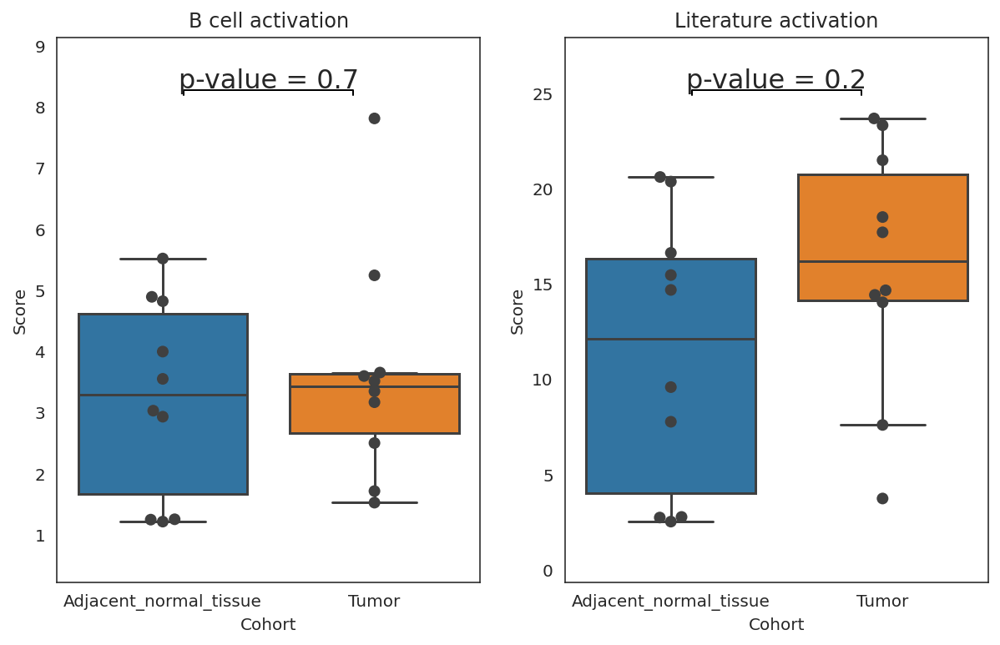

In [79]:
signature_analysis( data2 = expr_TPM[dict_illness['Adjacent_normal_tissue']],
                   data1 = expr_TPM[dict_illness['Tumor']],
                   label2 = 'Adjacent_normal_tissue', 
                   label1 = 'Tumor',
                   order = ['Adjacent_normal_tissue', 'Tumor']
                  )

In [80]:
check = expr_TPM[dict_illness['Tumor']]
check1 = check.loc[check.index.isin(my_genes)]
check2 = check.loc[check.index.isin(lit_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Tumor']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

print('\n')

for ind in check2.index:
    counter = []
    for col in dict_illness['Tumor']:
        counter.append(check2[col][ind])
    print(ind, my_median(counter))

TNFRSF13B 0.3582253010012121
FCRL5 1.4167857899325775
KLHL14 0.061624383254995446
FCRL1 0.1379856852898705
CD22 1.767701247546664
FCRLA 0.4728034896245049
FCRL2 0.43021250923772203


IL2RA 6.455505174241484
CD274 2.9894055819242706
CD81 350.22877767661237
CD83 14.59062214309347
TFRC 40.953719040618736
ITGA4 9.449544371961252
CD86 24.751492831786265
CD70 1.3936149774399158
CD38 1.661442351085629
ITGB1 780.8368187742115
ICOSLG 5.554666256872226
TNFSF4 8.050334118155655
CD44 155.9002701672837
FCER2 0.17450007097636444
CD80 1.9507485035387928
CD69 9.862397572821468
FAS 18.072432784274277
SLC3A2 89.57756021996131


In [81]:
expr_counts_GSE119794 = read_expressions(cells_GSE119794, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [82]:
#для всех генов

list_edgeR = []
control = 'Adjacent_normal_tissue'
interest = 'Tumor'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE119794, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[             logFC    logCPM        PValue       FDR
 SERPINB4  5.691565  1.263479  3.295918e-07  0.001642
 SPRR3     6.311006  1.396293  3.464242e-07  0.001642
 CDHR2     4.809625  4.221152  3.596652e-07  0.001642
 LEMD1     4.386544  1.073871  4.172970e-07  0.001642
 UNC93A    5.912098 -1.697797  4.550886e-07  0.001642
 ...            ...       ...           ...       ...
 UGT1A4    0.000000 -4.343250  1.000000e+00  1.000000
 VCY       0.000000 -4.343250  1.000000e+00  1.000000
 VCY1B     0.000000 -4.343250  1.000000e+00  1.000000
 ZCCHC13   0.000000 -4.343250  1.000000e+00  1.000000
 ZNF645    0.000000 -4.343250  1.000000e+00  1.000000
 
 [20062 rows x 4 columns]]

In [83]:
stimulation_expr_edgeR_GSE119794 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE119794.columns = ['GSE119794']
stimulation_expr_edgeR_GSE119794 = stimulation_expr_edgeR_GSE119794.loc[stimulation_expr_edgeR_GSE119794.index.isin(my_genes)]
stimulation_expr_edgeR_GSE119794.head()

,GSE119794
KLHL14,-0.999079
FCRL5,0.817681
FCRLA,-0.607487
CD22,-0.458613
FCRL1,-0.569780


<AxesSubplot:>

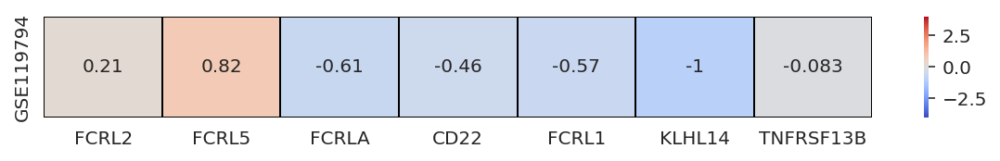

In [85]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE119794.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

# GSE54456

In [86]:
cells_GSE54456 = cells[cells.Dataset == 'GSE54456']
cells_GSE54456

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX451304,SRR1146076,GSE54456,Skin,Normal skin,Skin,Without_stimulation,Without_therapy,FlashFrozen,Healthy,GSM1315608,NaN,NaN,NaN,AllPrep DNA/RNA/Protein mini Kit (Qiagen),TruSeq Stranded mRNA (illumina),NaN,CASP1234,No_data,Adult,25.4-51.6,"24441097, 25723451, 27992404, 32132203",NaN,SINGLE,1.552585e+07,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,56578.0,40689.0,55541.0,39739.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX451305,SRR1146077,GSE54456,Skin,Lesional psoriatic skin,Skin,Without_stimulation,No_data,FlashFrozen,Psoriasis,GSM1315609,NaN,NaN,NaN,AllPrep DNA/RNA/Protein mini Kit (Qiagen),TruSeq Stranded mRNA (illumina),NaN,M3059,No_data,Adult,35.1-62.9,"24441097, 25723451, 27992404, 32132203",NaN,SINGLE,8.756864e+06,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,56610.0,40721.0,55573.0,39771.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX451306,SRR1146078,GSE54456,Skin,Lesional psoriatic skin,Skin,Without_stimulation,No_data,FlashFrozen,Psoriasis,GSM1315610,NaN,NaN,NaN,AllPrep DNA/RNA/Protein mini Kit (Qiagen),TruSeq Stranded mRNA (illumina),NaN,M3171,No_data,Adult,35.1-62.9,"24441097, 25723451, 27992404, 32132203",NaN,SINGLE,1.024074e+07,NaN,NaN,NaN,4.666667,NaN,NaN,NaN,56596.0,40707.0,55559.0,39757.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX451307,SRR1146079,GSE54456,Skin,Lesional psoriatic skin,Skin,Without_stimulation,No_data,FlashFrozen,Psoriasis,GSM1315612,NaN,NaN,NaN,AllPrep DNA/RNA/Protein mini Kit (Qiagen),TruSeq Stranded mRNA (illumina),NaN,M3418,No_data,Adult,35.1-62.9,"24441097, 25723451, 27992404, 32132203",NaN,SINGLE,2.974891e+07,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,56599.0,40710.0,55562.0,39760.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX451308,SRR1146080,GSE54456,Skin,Lesional psoriatic skin,Skin,Without_stimulation,No_data,FlashFrozen,Psoriasis,GSM1315613,NaN,NaN,NaN,AllPrep DNA/RNA/Protein mini Kit (Qiagen),TruSeq Stranded mRNA (illumina),NaN,M3978,No_data,Adult,35.1-62.9,"24441097, 25723451, 27992404, 32132203",NaN,SINGLE,3.048276e+07,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,56639.0,40748.0,55602.0,39798.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRX451473,SRR1146250,GSE54456,Skin,Normal skin,Skin,Without_stimulation,Without_therapy,FlashFrozen,Healthy,GSM1315786,NaN,NaN,NaN,AllPrep DNA/RNA/Protein mini Kit (Qiagen),TruSeq Stranded mRNA (illumina),NaN,M9004,No_data,Adult,25.4-51.6,"24441097, 25723451, 27992404, 32132203",NaN,SINGLE,2.876371e+07,NaN,NaN,NaN,4.958333,NaN,NaN,NaN,56565.0,40676.0,55528.0,39726.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX451474,SRR1146251,GSE54456,Skin,Normal skin,Skin,Without_stimulation,Without_therapy,FlashFrozen,Healthy,GSM1315787,NaN,NaN,NaN,AllPrep DNA/RNA/Protein mini Kit (Qiagen),TruSeq Stranded mRNA (illumina),NaN,M9027,No_data,Adult,25.4-51.6,"24441097, 25723451, 27992404, 32132203",NaN,SINGLE,2.647371e+07,NaN,NaN,NaN,5.250000,NaN,NaN,NaN,56542.0,40653.0,55505.0,39703.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX451475,SRR1146252,GSE54456,Skin,Lesional psoriatic skin,Skin,Without_stimulation,No_data,FlashFrozen,Psoriasis,GSM1315788,NaN,NaN,NaN,AllPrep DNA/RNA/Protein mini Kit (Qiagen),TruSeq Stranded mRNA (illumina),NaN,M9049

In [87]:
cells_GSE54456 = cells_GSE54456.loc[cells_GSE54456.Run != 'SRR1146084']
cells_GSE54456 = cells_GSE54456.loc[cells_GSE54456.Run != 'SRR1146086']
cells_GSE54456 = cells_GSE54456.loc[cells_GSE54456.Run != 'SRR1146099']
cells_GSE54456 = cells_GSE54456.loc[cells_GSE54456.Run != 'SRR1146232']
cells_GSE54456 = cells_GSE54456.loc[cells_GSE54456.Run != 'SRR1146216']

In [88]:
expr_TPM = read_expressions(cells_GSE54456, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [89]:
check_genes = ['CD19', 'MS4A1', 'CD8A', 'CD8B', 'CD3D', 'CD3E', 'CD3G', 'CD4']

In [90]:
expr_norm_skin = expr_TPM[dict_illness['Normal skin']]
expr_bad_skin = expr_TPM[dict_illness['Lesional psoriatic skin']]

expr_norm_skin = expr_norm_skin.loc[expr_norm_skin.index.isin(check_genes)]
expr_bad_skin = expr_bad_skin.loc[expr_bad_skin.index.isin(check_genes)]

KeyError: 'Normal skin'

In [91]:
expr_norm_skin = expr_norm_skin.T[check_genes]
expr_norm_skin = expr_norm_skin.T

NameError: name 'expr_norm_skin' is not defined

In [92]:
expr_bad_skin = expr_bad_skin.T[check_genes]
expr_bad_skin = expr_bad_skin.T

NameError: name 'expr_bad_skin' is not defined

In [93]:
x = expr_norm_skin.copy()
x = x.T

expr_norm_skin['Mediana'] = 'nan'

for gene in expr_norm_skin.index:
    counter = []
    for ind in x.index:
        counter.append(expr_norm_skin[ind][gene])
    expr_norm_skin['Mediana'][gene] = my_median(counter)  

NameError: name 'expr_norm_skin' is not defined

NameError: name 'expr_norm_skin' is not defined

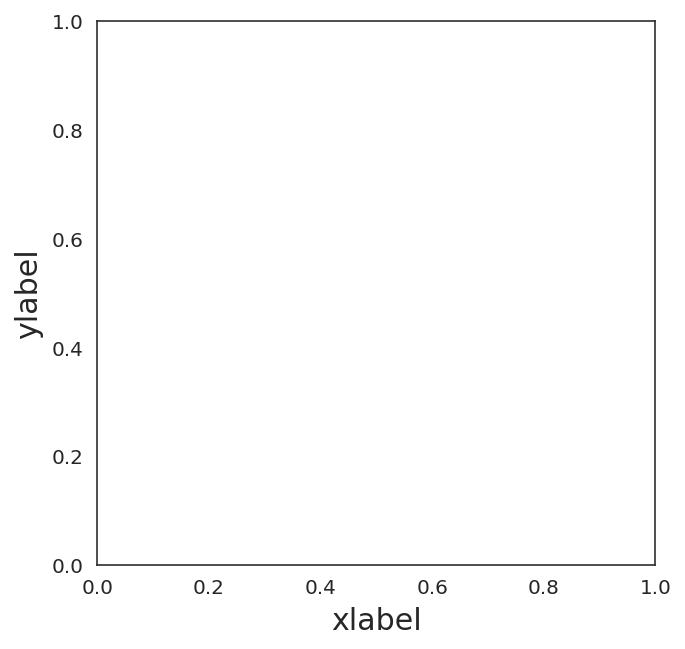

In [94]:
fig, ax = plt.subplots(figsize=(5, 5))
plt.ylabel('ylabel', fontsize=15)
plt.xlabel('xlabel', fontsize=15)
sns.barplot(x=expr_norm_skin['Mediana'].index, y=expr_norm_skin['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)
    
plt.xticks(rotation=-90)
plt.title('Normal skin', fontsize=20)

In [95]:
x = expr_bad_skin.copy()
x = x.T

expr_bad_skin['Mediana'] = 'nan'

for gene in expr_bad_skin.index:
    counter = []
    for ind in x.index:
        counter.append(expr_bad_skin[ind][gene])
    expr_bad_skin['Mediana'][gene] = my_median(counter)  

NameError: name 'expr_bad_skin' is not defined

NameError: name 'expr_bad_skin' is not defined

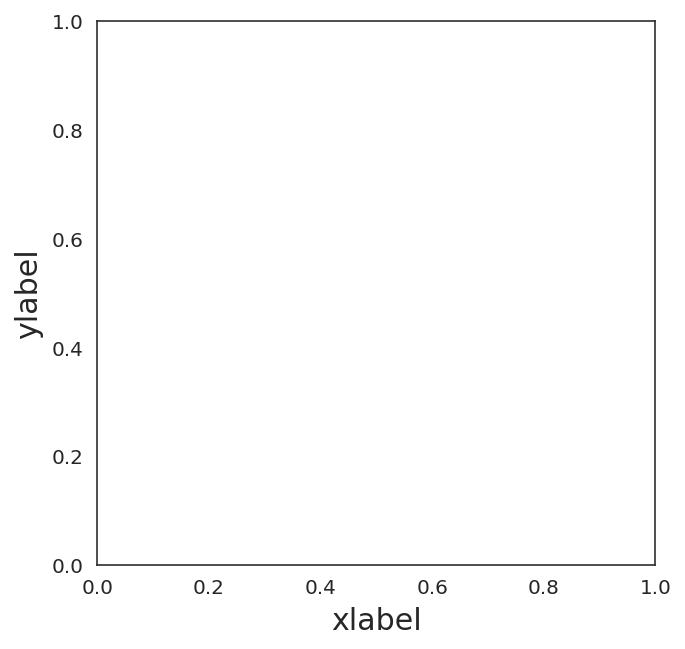

In [96]:
fig, ax = plt.subplots(figsize=(5, 5))
plt.ylabel('ylabel', fontsize=15)
plt.xlabel('xlabel', fontsize=15)
sns.barplot(x=expr_bad_skin['Mediana'].index, y=expr_bad_skin['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)
    
plt.xticks(rotation=-90)
plt.title('Normal skin', fontsize=20)

In [97]:
cells_GSE54456.Extended_tissue_type.value_counts()

Lesional psoriatic skin    92
Normal skin                82
Name: Extended_tissue_type, dtype: int64

In [98]:
cells_GSE54456.Stimulation.value_counts()

Without_stimulation    174
Name: Stimulation, dtype: int64

In [99]:
cells_GSE54456.Therapy.value_counts()

No_data            92
Without_therapy    82
Name: Therapy, dtype: int64

In [100]:
cells_GSE54456.Diagnosis.value_counts()

Psoriasis    92
Healthy      82
Name: Diagnosis, dtype: int64

In [101]:
cells_GSE54456.Material_type.value_counts()

Series([], Name: Material_type, dtype: int64)

In [102]:
all_deconv_GSE54456 = model.predict(expr_TPM[cells_GSE54456.index])
all_deconv_GSE54456.head()

Expressions OK


,SRX451304,SRX451305,SRX451306,SRX451307,SRX451308,SRX451309,SRX451310,SRX451311,SRX451312,SRX451313,SRX451314,SRX451315,SRX451316,SRX451317,SRX451318,SRX451319,SRX451320,SRX451321,SRX451322,SRX451323,SRX451324,SRX451325,SRX451326,SRX451327,SRX451328,SRX451329,SRX451330,SRX451331,SRX451332,SRX451333,SRX451334,SRX451335,SRX451336,SRX451337,SRX451338,SRX451339,SRX451340,SRX451341,SRX451342,SRX451343,SRX451344,SRX451345,SRX451346,SRX451347,SRX451348,SRX451349,SRX451350,SRX451351,SRX451352,SRX451353,SRX451354,SRX451355,SRX451356,SRX451357,SRX451358,SRX451359,SRX451360,SRX451361,SRX451362,SRX451363,SRX451364,SRX451365,SRX451366,SRX451367,SRX451368,SRX451369,SRX451370,SRX451371,SRX451372,SRX451373,SRX451374,SRX451375,SRX451376,SRX451377,SRX451378,SRX451379,SRX451380,SRX451381,SRX451382,SRX451383,SRX451384,SRX451385,SRX451386,SRX451387,SRX451388,SRX451389,SRX451390,SRX451391,SRX451392,SRX451393,SRX451394,SRX451395,SRX451396,SRX451397,SRX451398,SRX451399,SRX451400,SRX451401,SRX451402,SRX451403,SRX451404,SRX451405,SRX451406,SRX451407,SRX451408,SRX451409,SRX451410,SRX451411,SRX451412,SRX451413,SRX451414,SRX451415,SRX451416,SRX451417,SRX451418,SRX451419,SRX451420,SRX451421,SRX451422,SRX451423,SRX451424,SRX451425,SRX451426,SRX451427,SRX451428,SRX451429,SRX451430,SRX451431,SRX451432,SRX451433,SRX451434,SRX451435,SRX451436,SRX451437,SRX451438,SRX451439,SRX451440,SRX451441,SRX451442,SRX451443,SRX451444,SRX451445,SRX451446,SRX451447,SRX451448,SRX451449,SRX451450,SRX451451,SRX451452,SRX451453,SRX451454,SRX451455,SRX451456,SRX451457,SRX451458,SRX451459,SRX451460,SRX451461,SRX451462,SRX451463,SRX451464,SRX451465,SRX451466,SRX451467,SRX451468,SRX451469,SRX451470,SRX451471,SRX451472,SRX451473,SRX451474,SRX451475,SRX451476,SRX451477
Other,0.886114,0.780046,0.887125,0.688994,0.833765,0.772959,0.747121,0.870929,0.861136,0.843811,0.847788,0.892914,0.868552,0.784826,0.840568,0.881342,0.765106,0.813265,0.813998,0.814069,0.777385,0.874726,0.890501,0.847354,0.783586,0.825230,0.804230,0.867756,0.834379,0.821605,0.884462,0.852010,0.864953,0.729324,0.828438,0.843334,0.875016,0.832403,0.864031,0.841321,0.896358,0.872298,0.863907,0.872664,0.846172,0.712278,0.914289,0.891229,0.865803,0.834229,0.850610,0.888722,0.873710,0.813486,0.719184,0.847833,0.857514,0.714752,8.765384e-01,0.878075,0.898791,0.884186,0.863246,0.894424,0.821788,0.849737,0.913684,0.882655,0.860412,0.735336,0.765346,0.734881,0.710022,0.773915,0.895763,0.855601,0.882399,0.818568,0.849530,0.865893,0.862505,0.731036,0.798244,0.790562,0.648597,0.765424,0.862866,0.902571,0.918196,0.865716,0.908045,0.882599,0.939503,0.907588,0.929509,0.866375,0.864200,0.900307,0.893755,0.866994,0.85553,0.876055,0.808241,0.913063,8.734809e-01,0.865607,0.896005,0.914307,0.891308,0.940237,0.885905,0.845993,0.893293,0.912293,0.891452,0.902898,0.892168,0.890926,0.809370,0.841363,0.737437,0.874568,0.883402,0.710774,0.835631,0.681671,0.779465,0.736881,0.944187,0.874617,0.821890,0.787916,0.818850,0.842471,0.926051,0.811296,0.85905,0.865526,0.828850,0.744325,0.749972,0.859050,0.887301,0.786314,0.702187,0.804578,0.824172,0.767860,0.791837,0.868648,0.862224,0.882695,0.835355,0.755646,0.755720,0.855894,0.785836,0.908949,0.778463,0.560982,0.836587,0.882409,0.904617,0.862296,0.865036,0.897655,0.883158,0.909556,0.926454,0.910914,0.917648,0.804040,0.841402,0.673603
Basophils,0.003320,0.002202,0.001472,0.002926,0.002264,0.002011,0.000820,0.000925,0.006023,0.006952,0.006042,0.001158,0.001472,0.002910,0.000914,0.001668,0.001122,0.001925,0.000000,0.001100,0.001822,0.001198,0.000000,0.001764,0.002045,0.002904,0.001887,0.004551,0.006394,0.003149,0.007544,0.006475,0.000000,0.002419,0.011960,0.000519,0.004455,0.012226,0.002114,0.006110,0.003284,0.003773,0.003856,0.005456,0.001957,0.007209,0.000000,0.000012,0.006228,0.001320,0.000594,0.000000,0.000000,0.003324,0.002216,0.002259,0.003094,0.014420,0.000000e+00,0.001566,0.005389,0.001950,0.001438,0.002755,0.004859,0.008022,0.000000,0.000000,0.004952,0.004583,0.002293,0.002885,0.003634,0.005557,0

In [103]:
all_deconv_GSE54456['Mediana'] = 'nan'

for cell in all_deconv_GSE54456.index:
    counter = []
    for ind in cells_GSE54456.index:
        counter.append(all_deconv_GSE54456[ind][cell])
    all_deconv_GSE54456['Mediana'][cell] = my_median(counter)  

all_deconv_GSE54456.head()

,SRX451304,SRX451305,SRX451306,SRX451307,SRX451308,SRX451309,SRX451310,SRX451311,SRX451312,SRX451313,SRX451314,SRX451315,SRX451316,SRX451317,SRX451318,SRX451319,SRX451320,SRX451321,SRX451322,SRX451323,SRX451324,SRX451325,SRX451326,SRX451327,SRX451328,SRX451329,SRX451330,SRX451331,SRX451332,SRX451333,SRX451334,SRX451335,SRX451336,SRX451337,SRX451338,SRX451339,SRX451340,SRX451341,SRX451342,SRX451343,SRX451344,SRX451345,SRX451346,SRX451347,SRX451348,SRX451349,SRX451350,SRX451351,SRX451352,SRX451353,SRX451354,SRX451355,SRX451356,SRX451357,SRX451358,SRX451359,SRX451360,SRX451361,SRX451362,SRX451363,SRX451364,SRX451365,SRX451366,SRX451367,SRX451368,SRX451369,SRX451370,SRX451371,SRX451372,SRX451373,SRX451374,SRX451375,SRX451376,SRX451377,SRX451378,SRX451379,SRX451380,SRX451381,SRX451382,SRX451383,SRX451384,SRX451385,SRX451386,SRX451387,SRX451388,SRX451389,SRX451390,SRX451391,SRX451392,SRX451393,SRX451394,SRX451395,SRX451396,SRX451397,SRX451398,SRX451399,SRX451400,SRX451401,SRX451402,SRX451403,SRX451404,SRX451405,SRX451406,SRX451407,SRX451408,SRX451409,SRX451410,SRX451411,SRX451412,SRX451413,SRX451414,SRX451415,SRX451416,SRX451417,SRX451418,SRX451419,SRX451420,SRX451421,SRX451422,SRX451423,SRX451424,SRX451425,SRX451426,SRX451427,SRX451428,SRX451429,SRX451430,SRX451431,SRX451432,SRX451433,SRX451434,SRX451435,SRX451436,SRX451437,SRX451438,SRX451439,SRX451440,SRX451441,SRX451442,SRX451443,SRX451444,SRX451445,SRX451446,SRX451447,SRX451448,SRX451449,SRX451450,SRX451451,SRX451452,SRX451453,SRX451454,SRX451455,SRX451456,SRX451457,SRX451458,SRX451459,SRX451460,SRX451461,SRX451462,SRX451463,SRX451464,SRX451465,SRX451466,SRX451467,SRX451468,SRX451469,SRX451470,SRX451471,SRX451472,SRX451473,SRX451474,SRX451475,SRX451476,SRX451477,Mediana
Other,0.886114,0.780046,0.887125,0.688994,0.833765,0.772959,0.747121,0.870929,0.861136,0.843811,0.847788,0.892914,0.868552,0.784826,0.840568,0.881342,0.765106,0.813265,0.813998,0.814069,0.777385,0.874726,0.890501,0.847354,0.783586,0.825230,0.804230,0.867756,0.834379,0.821605,0.884462,0.852010,0.864953,0.729324,0.828438,0.843334,0.875016,0.832403,0.864031,0.841321,0.896358,0.872298,0.863907,0.872664,0.846172,0.712278,0.914289,0.891229,0.865803,0.834229,0.850610,0.888722,0.873710,0.813486,0.719184,0.847833,0.857514,0.714752,8.765384e-01,0.878075,0.898791,0.884186,0.863246,0.894424,0.821788,0.849737,0.913684,0.882655,0.860412,0.735336,0.765346,0.734881,0.710022,0.773915,0.895763,0.855601,0.882399,0.818568,0.849530,0.865893,0.862505,0.731036,0.798244,0.790562,0.648597,0.765424,0.862866,0.902571,0.918196,0.865716,0.908045,0.882599,0.939503,0.907588,0.929509,0.866375,0.864200,0.900307,0.893755,0.866994,0.85553,0.876055,0.808241,0.913063,8.734809e-01,0.865607,0.896005,0.914307,0.891308,0.940237,0.885905,0.845993,0.893293,0.912293,0.891452,0.902898,0.892168,0.890926,0.809370,0.841363,0.737437,0.874568,0.883402,0.710774,0.835631,0.681671,0.779465,0.736881,0.944187,0.874617,0.821890,0.787916,0.818850,0.842471,0.926051,0.811296,0.85905,0.865526,0.828850,0.744325,0.749972,0.859050,0.887301,0.786314,0.702187,0.804578,0.824172,0.767860,0.791837,0.868648,0.862224,0.882695,0.835355,0.755646,0.755720,0.855894,0.785836,0.908949,0.778463,0.560982,0.836587,0.882409,0.904617,0.862296,0.865036,0.897655,0.883158,0.909556,0.926454,0.910914,0.917648,0.804040,0.841402,0.673603,0.85905
Basophils,0.003320,0.002202,0.001472,0.002926,0.002264,0.002011,0.000820,0.000925,0.006023,0.006952,0.006042,0.001158,0.001472,0.002910,0.000914,0.001668,0.001122,0.001925,0.000000,0.001100,0.001822,0.001198,0.000000,0.001764,0.002045,0.002904,0.001887,0.004551,0.006394,0.003149,0.007544,0.006475,0.000000,0.002419,0.011960,0.000519,0.004455,0.012226,0.002114,0.006110,0.003284,0.003773,0.003856,0.005456,0.001957,0.007209,0.000000,0.000012,0.006228,0.001320,0.000594,0.000000,0.000000,0.003324,0.002216,0.002259,0.003094,0.014420,0.000000e+00,0.001566,0.005389,0.001950,0.001438,0.002755,0.004859,0.008022,0.000000,0.000000,0.004952,0.004583,0.002293,0.002885,0.0

In [104]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE54456['Mediana'].index, y=all_deconv_GSE54456['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE54456)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [105]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE54456.Extended_tissue_type.unique():
    dict_illness[illness] = cells_GSE54456[cells_GSE54456.Extended_tissue_type == illness].index

dict_illness

{'Normal skin': Index(['SRX451304', 'SRX451312', 'SRX451314', 'SRX451322', 'SRX451326',
        'SRX451331', 'SRX451332', 'SRX451333', 'SRX451334', 'SRX451336',
        'SRX451338', 'SRX451339', 'SRX451340', 'SRX451341', 'SRX451342',
        'SRX451343', 'SRX451345', 'SRX451346', 'SRX451347', 'SRX451350',
        'SRX451351', 'SRX451352', 'SRX451355', 'SRX451356', 'SRX451362',
        'SRX451363', 'SRX451364', 'SRX451367', 'SRX451368', 'SRX451369',
        'SRX451370', 'SRX451371', 'SRX451378', 'SRX451391', 'SRX451392',
        'SRX451394', 'SRX451395', 'SRX451396', 'SRX451397', 'SRX451398',
        'SRX451399', 'SRX451400', 'SRX451401', 'SRX451402', 'SRX451403',
        'SRX451404', 'SRX451405', 'SRX451406', 'SRX451407', 'SRX451408',
        'SRX451409', 'SRX451410', 'SRX451411', 'SRX451412', 'SRX451413',
        'SRX451414', 'SRX451415', 'SRX451416', 'SRX451417', 'SRX451418',
        'SRX451419', 'SRX451420', 'SRX451421', 'SRX451422', 'SRX451423',
        'SRX451425', 'SRX451426', 'S

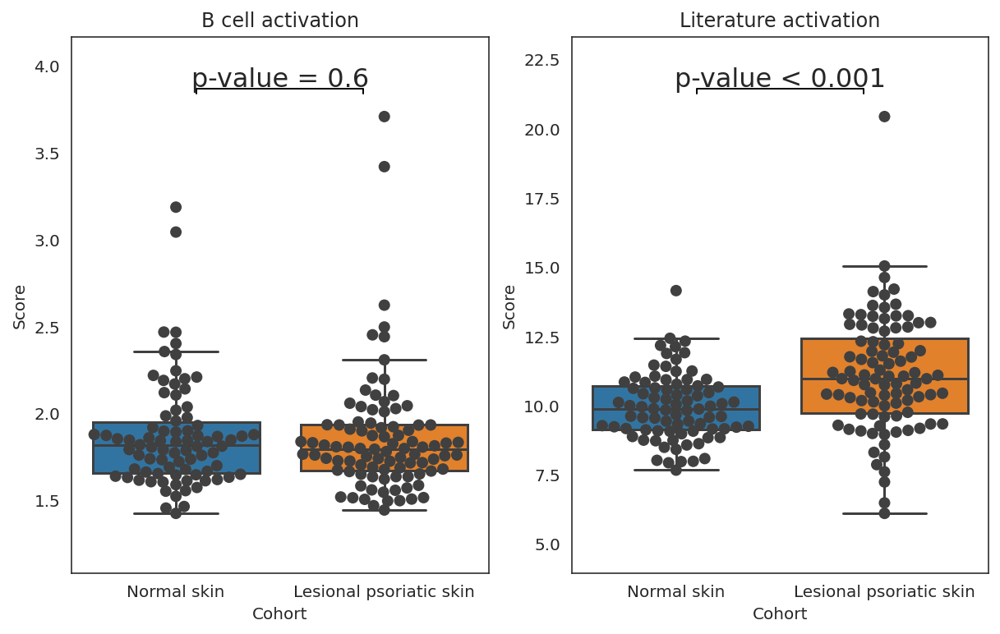

In [106]:
signature_analysis( data2 = expr_TPM[dict_illness['Normal skin']],
                   data1 = expr_TPM[dict_illness['Lesional psoriatic skin']],
                   label2 = 'Normal skin', 
                   label1 = 'Lesional psoriatic skin',
                  order = ['Normal skin', 'Lesional psoriatic skin'])

In [107]:
check = expr_TPM[dict_illness['Lesional psoriatic skin']]
check1 = check.loc[check.index.isin(my_genes)]
check2 = check.loc[check.index.isin(lit_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Lesional psoriatic skin']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

print('\n')

for ind in check2.index:
    counter = []
    for col in dict_illness['Lesional psoriatic skin']:
        counter.append(check2[col][ind])
    print(ind, my_median(counter))

TNFRSF13B 0.19040835451201932
FCRL5 0.02089125653218598
KLHL14 0.10849945552658305
FCRL1 0.0
CD22 0.34851780765201584
FCRLA 1.6429220196445242
FCRL2 0.026305728053571703


IL2RA 3.634985564268569
CD274 3.7268480287862045
CD81 404.98749213568095
CD83 8.439964184854535
TFRC 36.19149963562599
ITGA4 2.1247380576305503
CD86 4.54782031867091
CD70 2.4634054390147773
CD38 0.8354351268546958
ITGB1 96.37841371124016
ICOSLG 4.700255143814244
TNFSF4 0.30254747881385374
CD44 1387.8631486244276
FCER2 0.34157112052610517
CD80 0.4840763090256398
CD69 1.6416815306822365
FAS 9.718696360931222
SLC3A2 232.4781601171186


In [108]:
check2

,SRX451305,SRX451306,SRX451307,SRX451308,SRX451309,SRX451310,SRX451311,SRX451313,SRX451315,SRX451316,SRX451317,SRX451318,SRX451319,SRX451320,SRX451321,SRX451323,SRX451324,SRX451325,SRX451327,SRX451328,SRX451329,SRX451330,SRX451335,SRX451337,SRX451344,SRX451348,SRX451349,SRX451353,SRX451354,SRX451357,SRX451358,SRX451359,SRX451360,SRX451361,SRX451365,SRX451366,SRX451372,SRX451373,SRX451374,SRX451375,SRX451376,SRX451377,SRX451379,SRX451380,SRX451381,SRX451382,SRX451383,SRX451384,SRX451385,SRX451386,SRX451387,SRX451388,SRX451389,SRX451390,SRX451393,SRX451424,SRX451427,SRX451428,SRX451429,SRX451430,SRX451431,SRX451433,SRX451434,SRX451435,SRX451436,SRX451437,SRX451439,SRX451440,SRX451441,SRX451442,SRX451443,SRX451444,SRX451445,SRX451446,SRX451447,SRX451448,SRX451449,SRX451450,SRX451451,SRX451452,SRX451453,SRX451456,SRX451457,SRX451458,SRX451460,SRX451462,SRX451463,SRX451464,SRX451465,SRX451475,SRX451476,SRX451477
Gene,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
IL2RA,3.766180,1.706070,13.660622,3.191621,6.178425,10.801861,4.065992,2.199596,4.344201,2.048281,5.011557,6.847306,0.698492,6.891247,7.611327,3.793044,5.370429,3.425912,2.586663,6.889148,2.805287,2.227515,2.127791,10.240478,3.200775,3.029496,6.688556,2.283371,1.389852,3.180722,6.457502,2.501338,4.309925,4.689356,1.018849,3.601775,1.358183,7.069161,3.062911,9.331744,4.584054,3.174240,4.236185,2.676631,3.789359,1.168041,3.983516,2.501608,7.752269,3.222413,3.053738,8.552319,3.157576,1.055575,2.314974,4.346683,10.274540,1.901220,10.806785,1.515784,5.104249,3.668196,2.826952,3.769530,4.201409,2.579042,4.008771,2.805141,1.071170,4.382132,10.118868,9.588674,3.587039,1.333351,6.651305,2.754404,3.424175,3.879105,7.288862,5.774710,1.611144,1.795735,3.221198,4.058655,8.173403,4.529128,25.576070,5.004704e+00,1.655346,2.734770,3.130608,2.275054
CD274,3.841901,1.111678,3.404648,1.167616,2.985193,8.210939,6.570983,4.114417,4.242982,5.567588,6.093649,2.370656,1.585487,2.544615,3.178668,3.131054,6.864012,6.994025,12.502675,7.340061,3.673248,7.042943,2.900697,2.228039,4.933436,2.812731,6.068348,3.127205,4.312821,3.176076,1.396597,2.942321,7.173729,4.395826,3.179166,2.529668,3.125995,9.479540,3.014862,4.150287,2.292299,2.334804,1.705254,3.084855,1.458530,4.499938,3.224386,2.857334,4.067358,3.200010,3.201735,4.322631,3.816377,3.197987,2.589008,2.407736,8.364363,3.396968,2.631828,2.876161,3.811495,1.761553,4.053331,1.141446,1.801420,4.239375,2.008858,1.811350,0.870826,4.991166,10.101941,5.246750,2.780456,1.774476,4.723027,5.276403,3.780448,5.677637,5.093555,8.098475,5.133621,5.357208,4.965812,5.534485,9.122623,6.800611,3.007523,4.720915e+00,4.842828,3.177207,6.638622,4.121228
CD81,405.248380,715.791328,479.999919,574.486860,370.677367,180.473891,202.171425,399.306266,153.237341,150.400014,206.340474,258.191655,370.608601,447.793249,417.032443,387.016313,231.237057,298.874878,147.676447,344.176020,332.949947,290.794704,442.969565,592.080509,465.645238,473.049713,472.305931,381.963500,167.489699,420.790458,462.091805,397.242280,404.726604,445.576067,277.884764,374.292599,571.027548,488.018334,502.271405,376.898960,525.586153,543.406043,587.804659,235.016001,486.361063,374.384366,449.590945,579.831635,512.830247,651.939988,374.651737,297.521984,522.889322,365.573522,668.052527,609.155341,415.157285,330.187080,501.868134,651.518292,404.544942,314.412371,461.998975,414.649106,473.857580,433.121983,401.300270,395.767287,600.393500,418.434843,415.007834,521.500451,437.471316,345.890641,537.239244,483.858418,560.713801,362.865142,330.610460,332.973563,261.469304,298.603158,368.908180,393.674923,334.464247,350.304474,291.997147,1.602880e+02,391.310917,560.473462,475.605665,425.242868
CD83,8.576801,3.855150,12.105391,6.803916,10.189790,11.961886,5.988847,5.817943,10.141783,8.175398,11.121073,8.817766,5.046012,10.053144,8.254032,10.940309,11.429741,10.443832,12.809853,13.074045,7.602646,12.154718,7.185669,11.764677,6.611519,7.026914,11.956275,10.902070,7.5433

In [109]:
expr_counts_GSE54456 = read_expressions(cells_GSE54456, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [110]:
#для всех генов

list_edgeR = []
control = 'Normal skin'
interest = 'Lesional psoriatic skin'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE54456, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[                  logFC     logCPM  PValue  FDR
 VNN3           8.138890  2.251792   0.0     0.0
 IL36G          5.466484  7.276467   0.0     0.0
 PLA2G4D        4.387283  7.688137   0.0     0.0
 GJB2           4.199902  10.400117  0.0     0.0
 FABP5          3.442756  10.326828  0.0     0.0
 ...                 ...        ...  ...     ...
 UNCX           0.000000 -3.636187   1.0     1.0
 WFDC9          0.000000 -3.636187   1.0     1.0
 WI2-3308P17.2  0.000000 -3.636187   1.0     1.0
 ZCCHC13        0.000000 -3.636187   1.0     1.0
 ZNRF4          0.000000 -3.636187   1.0     1.0
 
 [20062 rows x 4 columns]]

In [111]:
stimulation_expr_edgeR_GSE54456 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE54456.columns = ['GSE54456']
stimulation_expr_edgeR_GSE54456 = stimulation_expr_edgeR_GSE54456.loc[stimulation_expr_edgeR_GSE54456.index.isin(my_genes)]
stimulation_expr_edgeR_GSE54456.head()

,GSE54456
TNFRSF13B,0.447357
FCRL1,0.888725
FCRLA,0.174153
FCRL2,0.277967
FCRL5,0.310254


<AxesSubplot:>

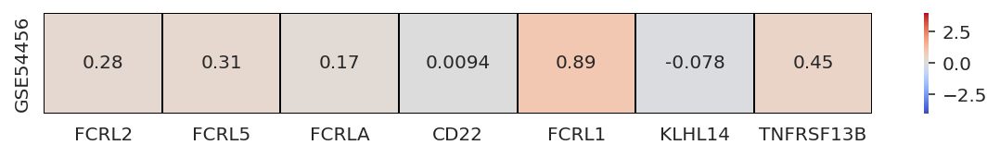

In [112]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE54456.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

# GSE40419 (+выживаемость)

In [113]:
cells_GSE40419 = cells[cells.Dataset == 'GSE40419']
cells_GSE40419

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ERX140427,ERR164550,GSE40419,Lung,Lung cancer cells,Lung,Without_stimulation,No_data,FlashFrozen,Lung_Adenocarcinoma,GSM993606,NaN,smoker,NaN,RNAiso Plus (Takara),TruSeq SBS Kit v3-HS (Illumina),NaN,C1,M,54,NaN,22975805,NaN,PAIRED,25204710.47,NaN,NaN,NaN,4.958333,NaN,NaN,NaN,48088.0,34839.0,48118.0,34840.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1A,NaN,NaN,NaN,NaN,NaN
ERX140428,ERR164551,GSE40419,Lung,Lung cancer cells,Lung,Without_stimulation,No_data,FlashFrozen,Lung_Adenocarcinoma,GSM993607,NaN,current smoker,NaN,RNAiso Plus (Takara),TruSeq SBS Kit v3-HS (Illumina),NaN,C2,M,51,NaN,22975805,NaN,PAIRED,33668635.45,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,47991.0,34742.0,48021.0,34743.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2B,NaN,NaN,NaN,NaN,NaN
ERX140429,ERR164552,GSE40419,Lung,Lung cancer cells,Lung,Without_stimulation,No_data,FlashFrozen,Lung_Adenocarcinoma,GSM993608,NaN,never smoker,NaN,RNAiso Plus (Takara),TruSeq SBS Kit v3-HS (Illumina),NaN,C3,F,65,NaN,22975805,NaN,PAIRED,27592385.15,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,48029.0,34780.0,48059.0,34781.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1A,NaN,NaN,NaN,NaN,NaN
ERX140430,ERR164553,GSE40419,Lung,Lung cancer cells,Lung,Without_stimulation,No_data,FlashFrozen,Lung_Adenocarcinoma,GSM993610,NaN,never smoker,NaN,RNAiso Plus (Takara),TruSeq SBS Kit v3-HS (Illumina),NaN,C4,M,52,NaN,22975805,NaN,PAIRED,26798723.33,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,48004.0,34755.0,48034.0,34756.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3B,NaN,NaN,NaN,NaN,NaN
ERX140431,ERR164554,GSE40419,Lung,Lung cancer cells,Lung,Without_stimulation,No_data,FlashFrozen,Lung_Adenocarcinoma,GSM993611,NaN,NaN,NaN,RNAiso Plus (Takara),TruSeq SBS Kit v3-HS (Illumina),NaN,C5,M,68,NaN,22975805,NaN,PAIRED,26365955.58,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,48090.0,34841.0,48120.0,34842.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3A,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERX140422,ERR164545,GSE40419,Lung,Adjacent lung normal cells,Lung,Without_stimulation,No_data,FlashFrozen,Lung_Adenocarcinoma,GSM993767,NaN,never smoker,NaN,RNAiso Plus (Takara),TruSeq SBS Kit v3-HS (Illumina),NaN,S48,F,48,NaN,22975805,NaN,PAIRED,37515194.81,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,48117.0,34868.0,48147.0,34869.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ERX140423,ERR164546,GSE40419,Lung,Adjacent lung normal cells,Lung,Without_stimulation,No_data,FlashFrozen,Lung_Adenocarcinoma,GSM993768,NaN,never smoker,NaN,RNAiso Plus (Takara),TruSeq SBS Kit v3-HS (Illumina),NaN,S49,F,66,NaN,22975805,NaN,PAIRED,24266062.37,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,48116.0,34867.0,48146.0,34868.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ERX140424,ERR164547,GSE40419,Lung,Adjacent lung normal cells,Lung,Without_stimulation,No_data,FlashFrozen,Lung_Adenocarcinoma,GSM993769,NaN,never smoker,NaN,RNAiso Plus (Takara),TruSeq SBS Kit v3-HS (Illumina),NaN,S50,F,64,NaN,22975805,NaN,PAIRED,25357422.59,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,48114.0,34865.0,48144.0,34866.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [114]:
cells_GSE40419.Extended_tissue_type.value_counts()

Lung cancer cells             84
Adjacent lung normal cells    77
Name: Extended_tissue_type, dtype: int64

In [115]:
cells_GSE40419.Stimulation.value_counts()

Without_stimulation    161
Name: Stimulation, dtype: int64

In [116]:
cells_GSE40419.Therapy.value_counts()

No_data    161
Name: Therapy, dtype: int64

In [117]:
cells_GSE40419.Diagnosis.value_counts()

Lung_Adenocarcinoma    161
Name: Diagnosis, dtype: int64

In [118]:
cells_GSE40419.Material_type.value_counts()

Series([], Name: Material_type, dtype: int64)

In [119]:
expr_TPM = read_expressions(cells_GSE40419, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [120]:
all_deconv_GSE40419 = model.predict(expr_TPM[cells_GSE40419.index])
all_deconv_GSE40419.head()

Expressions OK


,ERX140427,ERX140428,ERX140429,ERX140430,ERX140431,ERX140432,ERX140433,ERX140434,ERX140435,ERX140436,ERX140437,ERX140438,ERX140439,ERX140440,ERX140441,ERX140442,ERX140443,ERX140444,ERX140445,ERX140446,ERX140447,ERX140448,ERX140449,ERX140450,ERX140451,ERX140452,ERX140453,ERX140457,ERX140458,ERX140459,ERX140460,ERX140461,ERX140462,ERX040276,ERX040277,ERX040278,ERX040279,ERX040280,ERX140463,ERX140465,ERX140466,ERX140467,ERX140468,ERX140469,ERX140470,ERX140471,ERX140472,ERX140473,ERX140475,ERX140477,ERX140478,ERX140479,ERX140480,ERX140481,ERX140482,ERX140483,ERX140484,ERX140485,ERX140486,ERX140487,ERX140488,ERX140489,ERX140490,ERX140491,ERX140492,ERX140493,ERX140494,ERX140495,ERX140496,ERX140497,ERX140498,ERX140499,ERX140500,ERX140501,ERX140502,ERX140503,ERX140504,ERX140505,ERX140506,ERX140507,ERX140508,ERX140509,ERX140510,ERX140511,ERX140350,ERX140351,ERX140352,ERX140353,ERX140354,ERX140355,ERX140356,ERX140357,ERX140358,ERX140359,ERX140360,ERX140361,ERX140362,ERX140363,ERX140364,ERX140365,ERX140366,ERX140367,ERX140368,ERX140369,ERX140370,ERX140371,ERX140372,ERX140373,ERX140374,ERX140375,ERX140376,ERX140377,ERX140378,ERX140379,ERX140380,ERX140381,ERX140382,ERX140383,ERX140384,ERX140385,ERX140386,ERX140387,ERX140388,ERX140389,ERX140390,ERX140391,ERX140392,ERX140393,ERX140394,ERX140395,ERX140396,ERX140397,ERX140398,ERX140399,ERX140400,ERX140401,ERX140402,ERX140403,ERX140404,ERX140405,ERX140406,ERX140407,ERX140408,ERX140409,ERX140410,ERX140411,ERX140412,ERX140413,ERX140414,ERX140415,ERX140416,ERX140417,ERX140418,ERX140419,ERX140420,ERX140421,ERX140422,ERX140423,ERX140424,ERX140425,ERX140426
Other,0.545612,0.268228,0.402382,0.718437,0.396642,0.332668,0.775523,0.390629,0.635688,0.624482,0.625876,0.333299,0.775159,0.576063,0.822320,0.410527,0.403718,0.765786,0.612182,0.414535,0.559341,0.528041,0.338045,0.523784,0.357521,0.699750,0.419687,0.247531,0.370277,0.606384,0.428456,0.227530,0.492728,0.278466,0.412932,0.798984,0.540187,0.448339,0.415569,0.186230,0.581503,0.209757,0.642715,0.267697,0.605540,0.414948,0.419148,0.381837,0.430057,0.668425,0.524891,0.917862,0.787649,0.454244,0.850762,0.516576,0.574809,0.487226,0.646266,0.311820,0.521435,0.475112,0.421368,0.399326,0.311266,0.779200,0.558979,0.229436,0.293837,0.862216,0.646620,0.874044,0.751500,0.615334,0.358126,0.433012,0.716270,0.703776,0.458971,0.668367,0.783379,0.497639,0.674760,0.433138,0.328997,0.349097,0.504680,0.425502,0.372805,0.285851,0.382696,0.399332,0.348194,0.434696,0.374232,0.323284,0.336245,0.425391,0.493944,0.429706,0.522978,0.429174,0.390505,0.543204,0.394690,0.315585,0.409047,0.344272,0.456354,0.295952,0.398879,0.328020,0.453533,0.485965,0.454310,0.433586,0.564835,0.436299,0.449712,0.353945,0.396267,0.548955,0.472420,0.377108,0.430318,0.433405,0.514225,0.248447,0.486896,0.364907,0.465049,0.577791,0.640219,0.582719,0.183783,0.516758,0.430442,0.494357,0.544303,0.427703,0.568914,0.373519,0.631153,0.452827,0.217758,0.404672,0.514241,0.359707,0.547657,0.306403,0.444858,0.471756,0.531433,0.394281,0.535786,0.447809,0.504389,0.599367,0.501877,0.353819,0.374519
Basophils,0.012928,0.003342,0.016591,0.000290,0.012591,0.005196,0.002119,0.003071,0.005187,0.006109,0.000000,0.036616,0.008644,0.027772,0.001068,0.025448,0.031118,0.007352,0.003814,0.007267,0.000054,0.006242,0.004440,0.041058,0.008348,0.006065,0.023366,0.010233,0.014639,0.017263,0.026466,0.019599,0.017585,0.017194,0.006643,0.000000,0.029705,0.028880,0.004026,0.001445,0.002512,0.008207,0.003572,0.007231,0.001549,0.021810,0.025767,0.002052,0.012020,0.004926,0.000000,0.000000,0.013840,0.007639,0.003598,0.019804,0.000000,0.011612,0.001575,0.000000,0.009902,0.001186,0.000588,0.014698,0.106243,0.005887,0.000000,0.006600,0.017886,0.001221,0.001895,0.000901,0.010028,0.003461,0.001787,0.001458,0.007259,0.001603,0.009947,0.000000,0.000758,0.036497,0.000851,0.047894,0.063046,0.079930,0.069344,0.080818,0.042004,0.067258,0.038126,0.100438,0.093706,0.043996,0.075516,0.089555,0.078963,0.061201,0.062883,0.082343,0.040365,0.108257,0.1159

In [121]:
all_deconv_GSE40419['Mediana'] = 'nan'

for cell in all_deconv_GSE40419.index:
    counter = []
    for ind in cells_GSE40419.index:
        counter.append(all_deconv_GSE40419[ind][cell])
    all_deconv_GSE40419['Mediana'][cell] = my_median(counter)  

all_deconv_GSE40419.head()

,ERX140427,ERX140428,ERX140429,ERX140430,ERX140431,ERX140432,ERX140433,ERX140434,ERX140435,ERX140436,ERX140437,ERX140438,ERX140439,ERX140440,ERX140441,ERX140442,ERX140443,ERX140444,ERX140445,ERX140446,ERX140447,ERX140448,ERX140449,ERX140450,ERX140451,ERX140452,ERX140453,ERX140457,ERX140458,ERX140459,ERX140460,ERX140461,ERX140462,ERX040276,ERX040277,ERX040278,ERX040279,ERX040280,ERX140463,ERX140465,ERX140466,ERX140467,ERX140468,ERX140469,ERX140470,ERX140471,ERX140472,ERX140473,ERX140475,ERX140477,ERX140478,ERX140479,ERX140480,ERX140481,ERX140482,ERX140483,ERX140484,ERX140485,ERX140486,ERX140487,ERX140488,ERX140489,ERX140490,ERX140491,ERX140492,ERX140493,ERX140494,ERX140495,ERX140496,ERX140497,ERX140498,ERX140499,ERX140500,ERX140501,ERX140502,ERX140503,ERX140504,ERX140505,ERX140506,ERX140507,ERX140508,ERX140509,ERX140510,ERX140511,ERX140350,ERX140351,ERX140352,ERX140353,ERX140354,ERX140355,ERX140356,ERX140357,ERX140358,ERX140359,ERX140360,ERX140361,ERX140362,ERX140363,ERX140364,ERX140365,ERX140366,ERX140367,ERX140368,ERX140369,ERX140370,ERX140371,ERX140372,ERX140373,ERX140374,ERX140375,ERX140376,ERX140377,ERX140378,ERX140379,ERX140380,ERX140381,ERX140382,ERX140383,ERX140384,ERX140385,ERX140386,ERX140387,ERX140388,ERX140389,ERX140390,ERX140391,ERX140392,ERX140393,ERX140394,ERX140395,ERX140396,ERX140397,ERX140398,ERX140399,ERX140400,ERX140401,ERX140402,ERX140403,ERX140404,ERX140405,ERX140406,ERX140407,ERX140408,ERX140409,ERX140410,ERX140411,ERX140412,ERX140413,ERX140414,ERX140415,ERX140416,ERX140417,ERX140418,ERX140419,ERX140420,ERX140421,ERX140422,ERX140423,ERX140424,ERX140425,ERX140426,Mediana
Other,0.545612,0.268228,0.402382,0.718437,0.396642,0.332668,0.775523,0.390629,0.635688,0.624482,0.625876,0.333299,0.775159,0.576063,0.822320,0.410527,0.403718,0.765786,0.612182,0.414535,0.559341,0.528041,0.338045,0.523784,0.357521,0.699750,0.419687,0.247531,0.370277,0.606384,0.428456,0.227530,0.492728,0.278466,0.412932,0.798984,0.540187,0.448339,0.415569,0.186230,0.581503,0.209757,0.642715,0.267697,0.605540,0.414948,0.419148,0.381837,0.430057,0.668425,0.524891,0.917862,0.787649,0.454244,0.850762,0.516576,0.574809,0.487226,0.646266,0.311820,0.521435,0.475112,0.421368,0.399326,0.311266,0.779200,0.558979,0.229436,0.293837,0.862216,0.646620,0.874044,0.751500,0.615334,0.358126,0.433012,0.716270,0.703776,0.458971,0.668367,0.783379,0.497639,0.674760,0.433138,0.328997,0.349097,0.504680,0.425502,0.372805,0.285851,0.382696,0.399332,0.348194,0.434696,0.374232,0.323284,0.336245,0.425391,0.493944,0.429706,0.522978,0.429174,0.390505,0.543204,0.394690,0.315585,0.409047,0.344272,0.456354,0.295952,0.398879,0.328020,0.453533,0.485965,0.454310,0.433586,0.564835,0.436299,0.449712,0.353945,0.396267,0.548955,0.472420,0.377108,0.430318,0.433405,0.514225,0.248447,0.486896,0.364907,0.465049,0.577791,0.640219,0.582719,0.183783,0.516758,0.430442,0.494357,0.544303,0.427703,0.568914,0.373519,0.631153,0.452827,0.217758,0.404672,0.514241,0.359707,0.547657,0.306403,0.444858,0.471756,0.531433,0.394281,0.535786,0.447809,0.504389,0.599367,0.501877,0.353819,0.374519,0.448339
Basophils,0.012928,0.003342,0.016591,0.000290,0.012591,0.005196,0.002119,0.003071,0.005187,0.006109,0.000000,0.036616,0.008644,0.027772,0.001068,0.025448,0.031118,0.007352,0.003814,0.007267,0.000054,0.006242,0.004440,0.041058,0.008348,0.006065,0.023366,0.010233,0.014639,0.017263,0.026466,0.019599,0.017585,0.017194,0.006643,0.000000,0.029705,0.028880,0.004026,0.001445,0.002512,0.008207,0.003572,0.007231,0.001549,0.021810,0.025767,0.002052,0.012020,0.004926,0.000000,0.000000,0.013840,0.007639,0.003598,0.019804,0.000000,0.011612,0.001575,0.000000,0.009902,0.001186,0.000588,0.014698,0.106243,0.005887,0.000000,0.006600,0.017886,0.001221,0.001895,0.000901,0.010028,0.003461,0.001787,0.001458,0.007259,0.001603,0.009947,0.000000,0.000758,0.036497,0.000851,0.047894,0.063046,0.079930,0.069344,0.080818,0.042004,0.067258,0.038126,0.100438,0.093706,0.043996,0.075516,0.089555,0.078963,0.061201,0.062883,0.082343,0.04036

In [122]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE40419['Mediana'].index, y=all_deconv_GSE40419['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE40419)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [123]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE40419.Extended_tissue_type.unique():
    dict_illness[illness] = cells_GSE40419[cells_GSE40419.Extended_tissue_type == illness].index

dict_illness

{'Lung cancer cells': Index(['ERX140427', 'ERX140428', 'ERX140429', 'ERX140430', 'ERX140431',
        'ERX140432', 'ERX140433', 'ERX140434', 'ERX140435', 'ERX140436',
        'ERX140437', 'ERX140438', 'ERX140439', 'ERX140440', 'ERX140441',
        'ERX140442', 'ERX140443', 'ERX140444', 'ERX140445', 'ERX140446',
        'ERX140447', 'ERX140448', 'ERX140449', 'ERX140450', 'ERX140451',
        'ERX140452', 'ERX140453', 'ERX140457', 'ERX140458', 'ERX140459',
        'ERX140460', 'ERX140461', 'ERX140462', 'ERX040276', 'ERX040277',
        'ERX040278', 'ERX040279', 'ERX040280', 'ERX140463', 'ERX140465',
        'ERX140466', 'ERX140467', 'ERX140468', 'ERX140469', 'ERX140470',
        'ERX140471', 'ERX140472', 'ERX140473', 'ERX140475', 'ERX140477',
        'ERX140478', 'ERX140479', 'ERX140480', 'ERX140481', 'ERX140482',
        'ERX140483', 'ERX140484', 'ERX140485', 'ERX140486', 'ERX140487',
        'ERX140488', 'ERX140489', 'ERX140490', 'ERX140491', 'ERX140492',
        'ERX140493', 'ERX14049

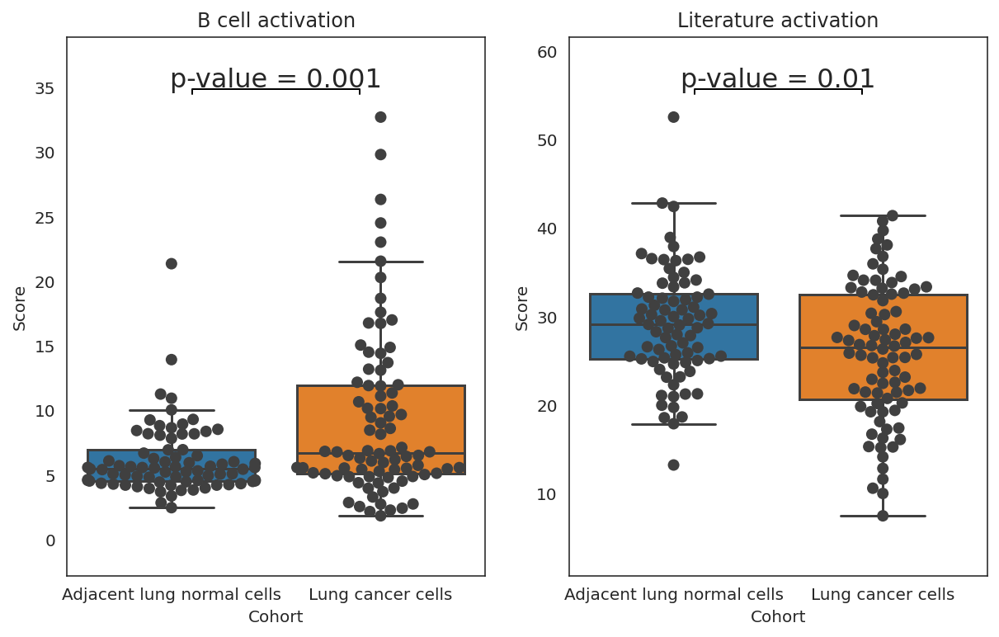

In [124]:
signature_analysis( data2 = expr_TPM[dict_illness['Adjacent lung normal cells']],
                   data1 = expr_TPM[dict_illness['Lung cancer cells']],
                   label2 = 'Adjacent lung normal cells', 
                   label1 = 'Lung cancer cells',
                  order = ['Adjacent lung normal cells', 'Lung cancer cells'])

In [125]:
check = expr_TPM[dict_illness['Lung cancer cells']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Lung cancer cells']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))



TNFRSF13B 2.004516579903575
FCRL5 4.946420346954934
KLHL14 0.4374855589888812
FCRL1 0.6564786228868065
CD22 11.07117072227425
FCRLA 2.9842473710122563
FCRL2 3.1005539744408748


In [126]:
expr_counts_GSE40419 = read_expressions(cells_GSE40419, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [127]:
#для всех генов

list_edgeR = []
control = 'Adjacent lung normal cells'
interest = 'Lung cancer cells'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE40419, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[                  logFC    logCPM         PValue            FDR
 PYCR1          2.840130  5.416083  5.319731e-112  1.067244e-107
 GPM6A         -2.440597  4.908047  2.722709e-84   2.731149e-80 
 ETV4           3.765202  4.811205  4.479185e-83   2.995380e-79 
 ALDH18A1       1.381037  6.057578  6.725394e-81   3.373122e-77 
 GOLM1          2.090940  7.333060  1.765214e-79   7.082746e-76 
 ...                 ...       ...           ...            ... 
 TRBD1          0.000000 -3.749926  1.000000e+00   1.000000e+00 
 TRDD1          0.000000 -3.749926  1.000000e+00   1.000000e+00 
 TRDD2          0.000000 -3.749926  1.000000e+00   1.000000e+00 
 TRDD3          0.000000 -3.749926  1.000000e+00   1.000000e+00 
 WI2-3308P17.2  0.000000 -3.749926  1.000000e+00   1.000000e+00 
 
 [20062 rows x 4 columns]]

In [128]:
stimulation_expr_edgeR_GSE40419 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE40419.columns = ['GSE40419']
stimulation_expr_edgeR_GSE40419 = stimulation_expr_edgeR_GSE40419.loc[stimulation_expr_edgeR_GSE40419.index.isin(my_genes)]
stimulation_expr_edgeR_GSE40419.head()

,GSE40419
FCRL2,2.008852
FCRLA,2.061603
FCRL5,1.969970
FCRL1,1.124722
TNFRSF13B,0.919254


<AxesSubplot:>

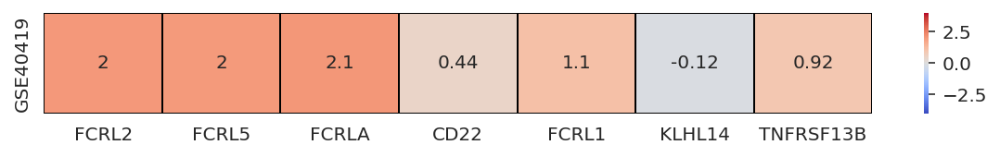

In [129]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE40419.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

# GSE94869  (не прошел по Readcounts 5 млн)

In [109]:
cells_GSE94869 = cells[cells.Dataset == 'GSE94869']
cells_GSE94869

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX2558784,SRR5253223,GSE94869,Esophageal_Epithelium,Tumor,Esophagus,Without_treatment,Without_therapy,FlashFrozen,Esophageal_Adenocarcinoma,GSM2486768,NaN,TruSight RNA Pan-Cancer Panel kit (Illumina),NaN,RNeasy mini kit (Qiagen),Illumina,NaN,511-T,F,58,NaN,28640357,total RNA,PAIRED,8858967.0,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,140977.0,117125.0,129160.0,104979.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [110]:
cells_GSE94869.Extended_tissue_type.value_counts()

Tumor    1
Name: Extended_tissue_type, dtype: int64

In [94]:
cells_GSE40419.Stimulation.value_counts()

Without_stimulation    161
Name: Stimulation, dtype: int64

In [95]:
cells_GSE40419.Therapy.value_counts()

No_data    161
Name: Therapy, dtype: int64

In [96]:
cells_GSE40419.Diagnosis.value_counts()

Lung_Adenocarcinoma    161
Name: Diagnosis, dtype: int64

In [97]:
cells_GSE40419.Material_type.value_counts()

Series([], Name: Material_type, dtype: int64)

In [98]:
expr_TPM = read_expressions(cells_GSE40419, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [99]:
all_deconv_GSE40419 = model.predict(expr_TPM[cells_GSE40419.index])
all_deconv_GSE40419.head()

Expressions OK


,ERX140427,ERX140428,ERX140429,ERX140430,ERX140431,ERX140432,ERX140433,ERX140434,ERX140435,ERX140436,ERX140437,ERX140438,ERX140439,ERX140440,ERX140441,ERX140442,ERX140443,ERX140444,ERX140445,ERX140446,ERX140447,ERX140448,ERX140449,ERX140450,ERX140451,ERX140452,ERX140453,ERX140457,ERX140458,ERX140459,ERX140460,ERX140461,ERX140462,ERX040276,ERX040277,ERX040278,ERX040279,ERX040280,ERX140463,ERX140465,ERX140466,ERX140467,ERX140468,ERX140469,ERX140470,ERX140471,ERX140472,ERX140473,ERX140475,ERX140477,ERX140478,ERX140479,ERX140480,ERX140481,ERX140482,ERX140483,ERX140484,ERX140485,ERX140486,ERX140487,ERX140488,ERX140489,ERX140490,ERX140491,ERX140492,ERX140493,ERX140494,ERX140495,ERX140496,ERX140497,ERX140498,ERX140499,ERX140500,ERX140501,ERX140502,ERX140503,ERX140504,ERX140505,ERX140506,ERX140507,ERX140508,ERX140509,ERX140510,ERX140511,ERX140350,ERX140351,ERX140352,ERX140353,ERX140354,ERX140355,ERX140356,ERX140357,ERX140358,ERX140359,ERX140360,ERX140361,ERX140362,ERX140363,ERX140364,ERX140365,ERX140366,ERX140367,ERX140368,ERX140369,ERX140370,ERX140371,ERX140372,ERX140373,ERX140374,ERX140375,ERX140376,ERX140377,ERX140378,ERX140379,ERX140380,ERX140381,ERX140382,ERX140383,ERX140384,ERX140385,ERX140386,ERX140387,ERX140388,ERX140389,ERX140390,ERX140391,ERX140392,ERX140393,ERX140394,ERX140395,ERX140396,ERX140397,ERX140398,ERX140399,ERX140400,ERX140401,ERX140402,ERX140403,ERX140404,ERX140405,ERX140406,ERX140407,ERX140408,ERX140409,ERX140410,ERX140411,ERX140412,ERX140413,ERX140414,ERX140415,ERX140416,ERX140417,ERX140418,ERX140419,ERX140420,ERX140421,ERX140422,ERX140423,ERX140424,ERX140425,ERX140426
Other,0.545612,0.268228,0.402382,0.718437,0.396642,0.332668,0.775523,0.390629,0.635688,0.624482,0.625876,0.333299,0.775159,0.576063,0.822320,0.410527,0.403718,0.765786,0.612182,0.414535,0.559341,0.528041,0.338045,0.523784,0.357521,0.699750,0.419687,0.247531,0.370277,0.606384,0.428456,0.227530,0.492728,0.278466,0.412932,0.798984,0.540187,0.448339,0.415569,0.186230,0.581503,0.209757,0.642715,0.267697,0.605540,0.414948,0.419148,0.381837,0.430057,0.668425,0.524891,0.917862,0.787649,0.454244,0.850762,0.516576,0.574809,0.487226,0.646266,0.311820,0.521435,0.475112,0.421368,0.399326,0.311266,0.779200,0.558979,0.229436,0.293837,0.862216,0.646620,0.874044,0.751500,0.615334,0.358126,0.433012,0.716270,0.703776,0.458971,0.668367,0.783379,0.497639,0.674760,0.433138,0.328997,0.349097,0.504680,0.425502,0.372805,0.285851,0.382696,0.399332,0.348194,0.434696,0.374232,0.323284,0.336245,0.425391,0.493944,0.429706,0.522978,0.429174,0.390505,0.543204,0.394690,0.315585,0.409047,0.344272,0.456354,0.295952,0.398879,0.328020,0.453533,0.485965,0.454310,0.433586,0.564835,0.436299,0.449712,0.353945,0.396267,0.548955,0.472420,0.377108,0.430318,0.433405,0.514225,0.248447,0.486896,0.364907,0.465049,0.577791,0.640219,0.582719,0.183783,0.516758,0.430442,0.494357,0.544303,0.427703,0.568914,0.373519,0.631153,0.452827,0.217758,0.404672,0.514241,0.359707,0.547657,0.306403,0.444858,0.471756,0.531433,0.394281,0.535786,0.447809,0.504389,0.599367,0.501877,0.353819,0.374519
Basophils,0.012928,0.003342,0.016591,0.000290,0.012591,0.005196,0.002119,0.003071,0.005187,0.006109,0.000000,0.036616,0.008644,0.027772,0.001068,0.025448,0.031118,0.007352,0.003814,0.007267,0.000054,0.006242,0.004440,0.041058,0.008348,0.006065,0.023366,0.010233,0.014639,0.017263,0.026466,0.019599,0.017585,0.017194,0.006643,0.000000,0.029705,0.028880,0.004026,0.001445,0.002512,0.008207,0.003572,0.007231,0.001549,0.021810,0.025767,0.002052,0.012020,0.004926,0.000000,0.000000,0.013840,0.007639,0.003598,0.019804,0.000000,0.011612,0.001575,0.000000,0.009902,0.001186,0.000588,0.014698,0.106243,0.005887,0.000000,0.006600,0.017886,0.001221,0.001895,0.000901,0.010028,0.003461,0.001787,0.001458,0.007259,0.001603,0.009947,0.000000,0.000758,0.036497,0.000851,0.047894,0.063046,0.079930,0.069344,0.080818,0.042004,0.067258,0.038126,0.100438,0.093706,0.043996,0.075516,0.089555,0.078963,0.061201,0.062883,0.082343,0.040365,0.108257,0.1159

In [100]:
all_deconv_GSE40419['Mediana'] = 'nan'

for cell in all_deconv_GSE40419.index:
    counter = []
    for ind in cells_GSE40419.index:
        counter.append(all_deconv_GSE40419[ind][cell])
    all_deconv_GSE40419['Mediana'][cell] = my_median(counter)  

all_deconv_GSE40419.head()

,ERX140427,ERX140428,ERX140429,ERX140430,ERX140431,ERX140432,ERX140433,ERX140434,ERX140435,ERX140436,ERX140437,ERX140438,ERX140439,ERX140440,ERX140441,ERX140442,ERX140443,ERX140444,ERX140445,ERX140446,ERX140447,ERX140448,ERX140449,ERX140450,ERX140451,ERX140452,ERX140453,ERX140457,ERX140458,ERX140459,ERX140460,ERX140461,ERX140462,ERX040276,ERX040277,ERX040278,ERX040279,ERX040280,ERX140463,ERX140465,ERX140466,ERX140467,ERX140468,ERX140469,ERX140470,ERX140471,ERX140472,ERX140473,ERX140475,ERX140477,ERX140478,ERX140479,ERX140480,ERX140481,ERX140482,ERX140483,ERX140484,ERX140485,ERX140486,ERX140487,ERX140488,ERX140489,ERX140490,ERX140491,ERX140492,ERX140493,ERX140494,ERX140495,ERX140496,ERX140497,ERX140498,ERX140499,ERX140500,ERX140501,ERX140502,ERX140503,ERX140504,ERX140505,ERX140506,ERX140507,ERX140508,ERX140509,ERX140510,ERX140511,ERX140350,ERX140351,ERX140352,ERX140353,ERX140354,ERX140355,ERX140356,ERX140357,ERX140358,ERX140359,ERX140360,ERX140361,ERX140362,ERX140363,ERX140364,ERX140365,ERX140366,ERX140367,ERX140368,ERX140369,ERX140370,ERX140371,ERX140372,ERX140373,ERX140374,ERX140375,ERX140376,ERX140377,ERX140378,ERX140379,ERX140380,ERX140381,ERX140382,ERX140383,ERX140384,ERX140385,ERX140386,ERX140387,ERX140388,ERX140389,ERX140390,ERX140391,ERX140392,ERX140393,ERX140394,ERX140395,ERX140396,ERX140397,ERX140398,ERX140399,ERX140400,ERX140401,ERX140402,ERX140403,ERX140404,ERX140405,ERX140406,ERX140407,ERX140408,ERX140409,ERX140410,ERX140411,ERX140412,ERX140413,ERX140414,ERX140415,ERX140416,ERX140417,ERX140418,ERX140419,ERX140420,ERX140421,ERX140422,ERX140423,ERX140424,ERX140425,ERX140426,Mediana
Other,0.545612,0.268228,0.402382,0.718437,0.396642,0.332668,0.775523,0.390629,0.635688,0.624482,0.625876,0.333299,0.775159,0.576063,0.822320,0.410527,0.403718,0.765786,0.612182,0.414535,0.559341,0.528041,0.338045,0.523784,0.357521,0.699750,0.419687,0.247531,0.370277,0.606384,0.428456,0.227530,0.492728,0.278466,0.412932,0.798984,0.540187,0.448339,0.415569,0.186230,0.581503,0.209757,0.642715,0.267697,0.605540,0.414948,0.419148,0.381837,0.430057,0.668425,0.524891,0.917862,0.787649,0.454244,0.850762,0.516576,0.574809,0.487226,0.646266,0.311820,0.521435,0.475112,0.421368,0.399326,0.311266,0.779200,0.558979,0.229436,0.293837,0.862216,0.646620,0.874044,0.751500,0.615334,0.358126,0.433012,0.716270,0.703776,0.458971,0.668367,0.783379,0.497639,0.674760,0.433138,0.328997,0.349097,0.504680,0.425502,0.372805,0.285851,0.382696,0.399332,0.348194,0.434696,0.374232,0.323284,0.336245,0.425391,0.493944,0.429706,0.522978,0.429174,0.390505,0.543204,0.394690,0.315585,0.409047,0.344272,0.456354,0.295952,0.398879,0.328020,0.453533,0.485965,0.454310,0.433586,0.564835,0.436299,0.449712,0.353945,0.396267,0.548955,0.472420,0.377108,0.430318,0.433405,0.514225,0.248447,0.486896,0.364907,0.465049,0.577791,0.640219,0.582719,0.183783,0.516758,0.430442,0.494357,0.544303,0.427703,0.568914,0.373519,0.631153,0.452827,0.217758,0.404672,0.514241,0.359707,0.547657,0.306403,0.444858,0.471756,0.531433,0.394281,0.535786,0.447809,0.504389,0.599367,0.501877,0.353819,0.374519,0.448339
Basophils,0.012928,0.003342,0.016591,0.000290,0.012591,0.005196,0.002119,0.003071,0.005187,0.006109,0.000000,0.036616,0.008644,0.027772,0.001068,0.025448,0.031118,0.007352,0.003814,0.007267,0.000054,0.006242,0.004440,0.041058,0.008348,0.006065,0.023366,0.010233,0.014639,0.017263,0.026466,0.019599,0.017585,0.017194,0.006643,0.000000,0.029705,0.028880,0.004026,0.001445,0.002512,0.008207,0.003572,0.007231,0.001549,0.021810,0.025767,0.002052,0.012020,0.004926,0.000000,0.000000,0.013840,0.007639,0.003598,0.019804,0.000000,0.011612,0.001575,0.000000,0.009902,0.001186,0.000588,0.014698,0.106243,0.005887,0.000000,0.006600,0.017886,0.001221,0.001895,0.000901,0.010028,0.003461,0.001787,0.001458,0.007259,0.001603,0.009947,0.000000,0.000758,0.036497,0.000851,0.047894,0.063046,0.079930,0.069344,0.080818,0.042004,0.067258,0.038126,0.100438,0.093706,0.043996,0.075516,0.089555,0.078963,0.061201,0.062883,0.082343,0.04036

In [ ]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE40419['Mediana'].index, y=all_deconv_GSE40419['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE40419)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [102]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE40419.Extended_tissue_type.unique():
    dict_illness[illness] = cells_GSE40419[cells_GSE40419.Extended_tissue_type == illness].index

dict_illness

{'Lung cancer cells': Index(['ERX140427', 'ERX140428', 'ERX140429', 'ERX140430', 'ERX140431',
        'ERX140432', 'ERX140433', 'ERX140434', 'ERX140435', 'ERX140436',
        'ERX140437', 'ERX140438', 'ERX140439', 'ERX140440', 'ERX140441',
        'ERX140442', 'ERX140443', 'ERX140444', 'ERX140445', 'ERX140446',
        'ERX140447', 'ERX140448', 'ERX140449', 'ERX140450', 'ERX140451',
        'ERX140452', 'ERX140453', 'ERX140457', 'ERX140458', 'ERX140459',
        'ERX140460', 'ERX140461', 'ERX140462', 'ERX040276', 'ERX040277',
        'ERX040278', 'ERX040279', 'ERX040280', 'ERX140463', 'ERX140465',
        'ERX140466', 'ERX140467', 'ERX140468', 'ERX140469', 'ERX140470',
        'ERX140471', 'ERX140472', 'ERX140473', 'ERX140475', 'ERX140477',
        'ERX140478', 'ERX140479', 'ERX140480', 'ERX140481', 'ERX140482',
        'ERX140483', 'ERX140484', 'ERX140485', 'ERX140486', 'ERX140487',
        'ERX140488', 'ERX140489', 'ERX140490', 'ERX140491', 'ERX140492',
        'ERX140493', 'ERX14049

In [104]:
expr_counts_GSE40419 = read_expressions(cells_GSE40419, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [105]:
#для всех генов

list_edgeR = []
control = 'Adjacent lung normal cells'
interest = 'Lung cancer cells'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE40419, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[                  logFC    logCPM         PValue            FDR
 PYCR1          2.840130  5.416083  5.319731e-112  1.067244e-107
 GPM6A         -2.440597  4.908047  2.722709e-84   2.731149e-80 
 ETV4           3.765202  4.811205  4.479185e-83   2.995380e-79 
 ALDH18A1       1.381037  6.057578  6.725394e-81   3.373122e-77 
 GOLM1          2.090940  7.333060  1.765214e-79   7.082746e-76 
 ...                 ...       ...           ...            ... 
 TRBD1          0.000000 -3.749926  1.000000e+00   1.000000e+00 
 TRDD1          0.000000 -3.749926  1.000000e+00   1.000000e+00 
 TRDD2          0.000000 -3.749926  1.000000e+00   1.000000e+00 
 TRDD3          0.000000 -3.749926  1.000000e+00   1.000000e+00 
 WI2-3308P17.2  0.000000 -3.749926  1.000000e+00   1.000000e+00 
 
 [20062 rows x 4 columns]]

In [106]:
stimulation_expr_edgeR_GGSE40419 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE40419.columns = ['GSE40419']
stimulation_expr_edgeR_GSE40419 = stimulation_expr_edgeR_GSE40419.loc[stimulation_expr_edgeR_GSE40419.index.isin(a)]
stimulation_expr_edgeR_GSE40419.head()

NameError: name 'stimulation_expr_edgeR_GSE40419' is not defined

In [ ]:
plt.figure(figsize=(20,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE40419.loc[a, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

In [ ]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE40419.Extended_tissue_type.unique():
    dict_illness[illness] = cells_GSE40419[cells_GSE40419.Extended_tissue_type == illness].index

dict_illness

expr_counts_GSE40419 = read_expressions(cells_GSE40419, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

#для всех генов

list_edgeR = []
control = 'Adjacent lung normal cells'
interest = 'Lung cancer cells'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE40419, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

stimulation_expr_edgeR_GGSE40419 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE40419.columns = ['GSE40419']
stimulation_expr_edgeR_GSE40419 = stimulation_expr_edgeR_GSE40419.loc[stimulation_expr_edgeR_GSE40419.index.isin(a)]
stimulation_expr_edgeR_GSE40419.head()

plt.figure(figsize=(20,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE40419.loc[a, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

# GSE105130 

In [130]:
cells_GSE105130 = cells[cells.Dataset == 'GSE105130']
cells_GSE105130

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX3298354,SRR6188338,GSE105130,Liver,Adjacent non-tumor,Liver,Without_treatment,Without_therapy,No_data,Hepatocellular_Carcinoma,GSM2819767,NaN,NaN,NaN,RNeasy mini kit (Qiagen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,P1,84%male,No_data,NaN,31429776,NaN,PAIRED,21771732.0,NaN,NaN,NaN,6.708333,NaN,NaN,NaN,149748.0,125838.0,136583.0,112344.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3298355,SRR6188339,GSE105130,Liver,Tumor,Liver,Without_treatment,Without_therapy,No_data,Hepatocellular_Carcinoma,GSM2819768,NaN,NaN,NaN,RNeasy mini kit (Qiagen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,P1,84%male,No_data,NaN,31429776,NaN,PAIRED,22156183.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,149764.0,125854.0,136599.0,112360.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3298356,SRR6188340,GSE105130,Liver,Adjacent non-tumor,Liver,Without_treatment,Without_therapy,No_data,Hepatocellular_Carcinoma,GSM2819769,NaN,NaN,NaN,RNeasy mini kit (Qiagen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,P2,84%male,No_data,NaN,31429776,NaN,PAIRED,21056081.0,NaN,NaN,NaN,6.708333,NaN,NaN,NaN,149746.0,125836.0,136581.0,112342.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3298357,SRR6188341,GSE105130,Liver,Tumor,Liver,Without_treatment,Without_therapy,No_data,Hepatocellular_Carcinoma,GSM2819770,NaN,NaN,NaN,RNeasy mini kit (Qiagen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,P2,84%male,No_data,NaN,31429776,NaN,PAIRED,17576253.0,NaN,NaN,NaN,6.708333,NaN,NaN,NaN,149767.0,125857.0,136602.0,112363.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3298358,SRR6188342,GSE105130,Liver,Adjacent non-tumor,Liver,Without_treatment,Without_therapy,No_data,Hepatocellular_Carcinoma,GSM2819771,NaN,NaN,NaN,RNeasy mini kit (Qiagen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,P3,84%male,No_data,NaN,31429776,NaN,PAIRED,20766809.0,NaN,NaN,NaN,6.708333,NaN,NaN,NaN,149727.0,125817.0,136562.0,112323.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3298359,SRR6188343,GSE105130,Liver,Tumor,Liver,Without_treatment,Without_therapy,No_data,Hepatocellular_Carcinoma,GSM2819772,NaN,NaN,NaN,RNeasy mini kit (Qiagen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,P3,84%male,No_data,NaN,31429776,NaN,PAIRED,21357260.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,149735.0,125825.0,136570.0,112331.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3298360,SRR6188344,GSE105130,Liver,Adjacent non-tumor,Liver,Without_treatment,Without_therapy,No_data,Hepatocellular_Carcinoma,GSM2819773,NaN,NaN,NaN,RNeasy mini kit (Qiagen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,P4,84%male,No_data,NaN,31429776,NaN,PAIRED,21628462.0,NaN,NaN,NaN,6.708333,NaN,NaN,NaN,149736.0,125826.0,136571.0,112332.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3298361,SRR6188345,GSE105130,Liver,Tumor,Liver,Without_treatment,Without_therapy,No_data,Hepatocellular_Carcinoma,GSM2819774,NaN,NaN,NaN,RNeasy mini kit (Qiagen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,P4,84%male,No_data,NaN,31429776,NaN,PAIRED,22054537.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,149757.0,125847.0,136592.0,112353.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3298362,SRR6188346,GSE105130,Liver,Adjacent non-tumor,Liver,Without_treatment,Without_therapy,No_data,Hepatocellular_Carcinoma,GSM2819775,NaN,NaN,NaN,RNeasy mini kit (Qiagen),TruSeq RNA Library Prep Kit v2 (Illumina),NaN,P6,84%male,No_data,NaN,314

In [131]:
cells_GSE105130.Extended_tissue_type.value_counts()

Adjacent non-tumor    27
Tumor                 25
Name: Extended_tissue_type, dtype: int64

In [132]:
cells_GSE105130.Stimulation.value_counts()

Without_treatment    52
Name: Stimulation, dtype: int64

In [133]:
cells_GSE105130.Therapy.value_counts()

Without_therapy    52
Name: Therapy, dtype: int64

In [134]:
cells_GSE105130.Diagnosis.value_counts()

Hepatocellular_Carcinoma    52
Name: Diagnosis, dtype: int64

In [135]:
cells_GSE105130.Material_type.value_counts()

Series([], Name: Material_type, dtype: int64)

In [136]:
expr_TPM = read_expressions(cells_GSE105130, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [137]:
all_deconv_GSE105130 = model.predict(expr_TPM[cells_GSE105130.index])
all_deconv_GSE105130.head()

Expressions OK


,SRX3298354,SRX3298355,SRX3298356,SRX3298357,SRX3298358,SRX3298359,SRX3298360,SRX3298361,SRX3298362,SRX3298363,SRX3298364,SRX3298365,SRX3298366,SRX3298367,SRX3298368,SRX3298369,SRX3298370,SRX3298371,SRX3298372,SRX3298373,SRX3298374,SRX3298375,SRX3298376,SRX3298377,SRX3298378,SRX3298379,SRX3298380,SRX3298381,SRX3298382,SRX3298383,SRX3298384,SRX3298385,SRX3298386,SRX3298387,SRX3298388,SRX3298389,SRX3298390,SRX3298391,SRX3298392,SRX3298393,SRX3298394,SRX3298395,SRX3298396,SRX3298397,SRX3298398,SRX3298399,SRX3298400,SRX3298401,SRX3298402,SRX3298403,SRX3298404,SRX3298405
Other,0.838090,9.361744e-01,0.908778,0.990084,0.885248,0.846727,0.772820,0.951013,0.849125,0.949744,0.881699,0.781975,0.782958,0.817956,0.852804,0.718687,0.709470,0.755312,0.833891,0.973708,0.892657,0.844026,0.869994,0.949254,0.845861,0.841173,0.924660,0.876069,0.690809,0.883515,0.716264,0.878696,0.916975,0.778607,0.785801,0.867530,0.831145,0.611092,0.836343,0.844354,0.892799,0.854660,0.927485,0.856141,0.913763,0.755406,0.975077,0.923410,0.935171,0.787351,0.790070,0.972937
Basophils,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000227,0.000000,0.000330,0.000103,0.000000,0.000000,0.001150,0.000000,0.000000,0.000000,0.000000,0.000039,0.000000,0.000000,0.000157,0.000113,0.000000,0.000000,0.000000,0.000000,0.003038,0.000000,0.000000,0.000194,0.000000,0.000000,0.000000,0.002452,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000776,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CD27neg_Memory_B_cells,0.000000,2.802199e-07,0.000008,0.000000,0.000000,0.000040,0.000072,0.000000,0.000040,0.000000,0.000035,0.000549,0.000004,0.000000,0.000009,0.000289,0.000020,0.000003,0.000000,0.000000,0.000094,0.000314,0.000032,0.000000,0.000000,0.000019,0.000000,0.000019,0.000000,0.000000,0.000035,0.000192,0.000000,0.000079,0.000015,0.000051,0.000000,0.000244,0.000056,0.000022,0.000000,0.000018,0.000000,0.000053,0.000000,0.000343,0.000000,0.000022,0.000017,0.000000,0.000000,0.000000
CD57neg_Cytotoxic_NK_cells,0.002095,0.000000e+00,0.000771,0.000013,0.002900,0.001435,0.003794,0.001193,0.006171,0.000000,0.001850,0.001349,0.002926,0.008614,0.003192,0.000137,0.004016,0.003578,0.006366,0.000000,0.002291,0.001341,0.001388,0.002328,0.001564,0.000744,0.001071,0.001852,0.001223,0.002538,0.001333,0.001447,0.000211,0.000831,0.002651,0.003544,0.008902,0.000068,0.000000,0.002742,0.000776,0.001934,0.004372,0.001282,0.000000,0.000507,0.001241,0.001015,0.000263,0.001064,0.001158,0.000000
CD57pos_Cytotoxic_NK_cells,0.001306,0.000000e+00,0.003544,0.000000,0.008969,0.001316,0.005433,0.000408,0.003577,0.000000,0.005755,0.000643,0.011727,0.011774,0.008680,0.000057,0.014018,0.003283,0.015162,0.000000,0.005565,0.000651,0.010442,0.000891,0.004617,0.006599,0.000691,0.014179,0.000914,0.004714,0.000720,0.007436,0.002262,0.020892,0.002257,0.001889,0.002828,0.009420,0.000000,0.009552,0.003247,0.007118,0.000769,0.007593,0.000000,0.003793,0.000429,0.004890,0.000084,0.004950,0.004816,0.000000


In [138]:
all_deconv_GSE105130['Mediana'] = 'nan'

for cell in all_deconv_GSE105130.index:
    counter = []
    for ind in cells_GSE105130.index:
        counter.append(all_deconv_GSE105130[ind][cell])
    all_deconv_GSE105130['Mediana'][cell] = my_median(counter)  

all_deconv_GSE105130.head()

,SRX3298354,SRX3298355,SRX3298356,SRX3298357,SRX3298358,SRX3298359,SRX3298360,SRX3298361,SRX3298362,SRX3298363,SRX3298364,SRX3298365,SRX3298366,SRX3298367,SRX3298368,SRX3298369,SRX3298370,SRX3298371,SRX3298372,SRX3298373,SRX3298374,SRX3298375,SRX3298376,SRX3298377,SRX3298378,SRX3298379,SRX3298380,SRX3298381,SRX3298382,SRX3298383,SRX3298384,SRX3298385,SRX3298386,SRX3298387,SRX3298388,SRX3298389,SRX3298390,SRX3298391,SRX3298392,SRX3298393,SRX3298394,SRX3298395,SRX3298396,SRX3298397,SRX3298398,SRX3298399,SRX3298400,SRX3298401,SRX3298402,SRX3298403,SRX3298404,SRX3298405,Mediana
Other,0.838090,9.361744e-01,0.908778,0.990084,0.885248,0.846727,0.772820,0.951013,0.849125,0.949744,0.881699,0.781975,0.782958,0.817956,0.852804,0.718687,0.709470,0.755312,0.833891,0.973708,0.892657,0.844026,0.869994,0.949254,0.845861,0.841173,0.924660,0.876069,0.690809,0.883515,0.716264,0.878696,0.916975,0.778607,0.785801,0.867530,0.831145,0.611092,0.836343,0.844354,0.892799,0.854660,0.927485,0.856141,0.913763,0.755406,0.975077,0.923410,0.935171,0.787351,0.790070,0.972937,0.853732
Basophils,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000227,0.000000,0.000330,0.000103,0.000000,0.000000,0.001150,0.000000,0.000000,0.000000,0.000000,0.000039,0.000000,0.000000,0.000157,0.000113,0.000000,0.000000,0.000000,0.000000,0.003038,0.000000,0.000000,0.000194,0.000000,0.000000,0.000000,0.002452,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000776,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0
CD27neg_Memory_B_cells,0.000000,2.802199e-07,0.000008,0.000000,0.000000,0.000040,0.000072,0.000000,0.000040,0.000000,0.000035,0.000549,0.000004,0.000000,0.000009,0.000289,0.000020,0.000003,0.000000,0.000000,0.000094,0.000314,0.000032,0.000000,0.000000,0.000019,0.000000,0.000019,0.000000,0.000000,0.000035,0.000192,0.000000,0.000079,0.000015,0.000051,0.000000,0.000244,0.000056,0.000022,0.000000,0.000018,0.000000,0.000053,0.000000,0.000343,0.000000,0.000022,0.000017,0.000000,0.000000,0.000000,8.36058e-06
CD57neg_Cytotoxic_NK_cells,0.002095,0.000000e+00,0.000771,0.000013,0.002900,0.001435,0.003794,0.001193,0.006171,0.000000,0.001850,0.001349,0.002926,0.008614,0.003192,0.000137,0.004016,0.003578,0.006366,0.000000,0.002291,0.001341,0.001388,0.002328,0.001564,0.000744,0.001071,0.001852,0.001223,0.002538,0.001333,0.001447,0.000211,0.000831,0.002651,0.003544,0.008902,0.000068,0.000000,0.002742,0.000776,0.001934,0.004372,0.001282,0.000000,0.000507,0.001241,0.001015,0.000263,0.001064,0.001158,0.000000,0.00134532
CD57pos_Cytotoxic_NK_cells,0.001306,0.000000e+00,0.003544,0.000000,0.008969,0.001316,0.005433,0.000408,0.003577,0.000000,0.005755,0.000643,0.011727,0.011774,0.008680,0.000057,0.014018,0.003283,0.015162,0.000000,0.005565,0.000651,0.010442,0.000891,0.004617,0.006599,0.000691,0.014179,0.000914,0.004714,0.000720,0.007436,0.002262,0.020892,0.002257,0.001889,0.002828,0.009420,0.000000,0.009552,0.003247,0.007118,0.000769,0.007593,0.000000,0.003793,0.000429,0.004890,0.000084,0.004950,0.004816,0.000000,0.00341342


In [139]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE105130['Mediana'].index, y=all_deconv_GSE105130['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE105130)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [140]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE105130.Extended_tissue_type.unique():
    dict_illness[illness] = cells_GSE105130[cells_GSE105130.Extended_tissue_type == illness].index

dict_illness

{'Adjacent non-tumor': Index(['SRX3298354', 'SRX3298356', 'SRX3298358', 'SRX3298360', 'SRX3298362',
        'SRX3298364', 'SRX3298366', 'SRX3298368', 'SRX3298370', 'SRX3298372',
        'SRX3298374', 'SRX3298376', 'SRX3298378', 'SRX3298379', 'SRX3298381',
        'SRX3298383', 'SRX3298385', 'SRX3298387', 'SRX3298389', 'SRX3298391',
        'SRX3298393', 'SRX3298395', 'SRX3298397', 'SRX3298399', 'SRX3298401',
        'SRX3298403', 'SRX3298404'],
       dtype='object', name='Sample'),
 'Tumor': Index(['SRX3298355', 'SRX3298357', 'SRX3298359', 'SRX3298361', 'SRX3298363',
        'SRX3298365', 'SRX3298367', 'SRX3298369', 'SRX3298371', 'SRX3298373',
        'SRX3298375', 'SRX3298377', 'SRX3298380', 'SRX3298382', 'SRX3298384',
        'SRX3298386', 'SRX3298388', 'SRX3298390', 'SRX3298392', 'SRX3298394',
        'SRX3298396', 'SRX3298398', 'SRX3298400', 'SRX3298402', 'SRX3298405'],
       dtype='object', name='Sample')}

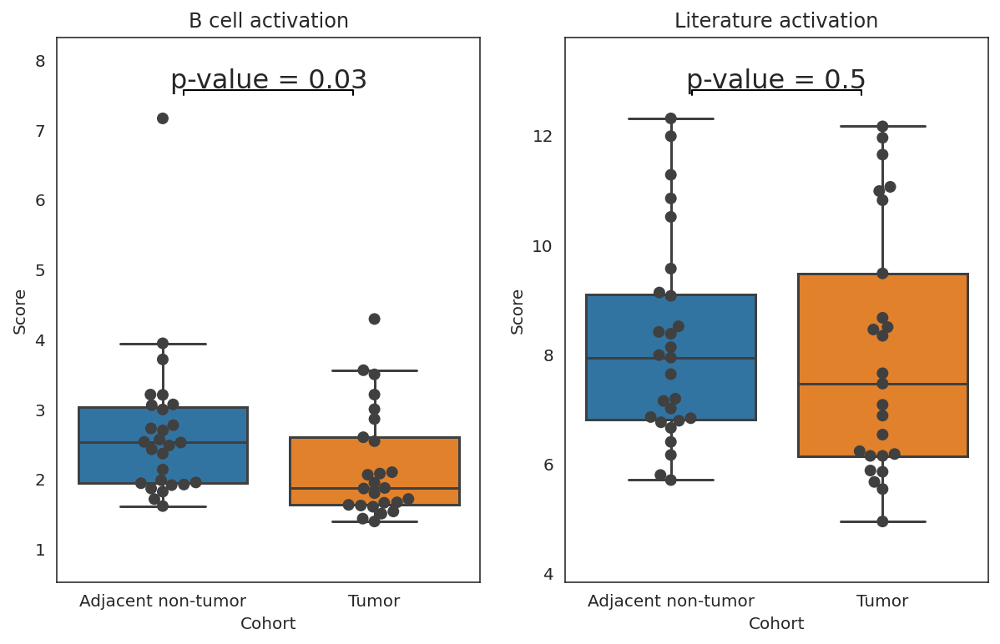

In [141]:
signature_analysis( data2 = expr_TPM[dict_illness['Adjacent non-tumor']],
                   data1 = expr_TPM[dict_illness['Tumor']],
                   label2 = 'Adjacent non-tumor', 
                   label1 = 'Tumor',
                  order = ['Adjacent non-tumor', 'Tumor'])

In [142]:
check = expr_TPM[dict_illness['Tumor']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Tumor']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

TNFRSF13B 0.0896899999069759
FCRL5 0.0731852467321367
KLHL14 0.020169752123474983
FCRL1 0.0
CD22 0.41128000079083277
FCRLA 0.4411466255637127
FCRL2 0.5292780623471655


In [143]:
expr_counts_GSE105130 = read_expressions(cells_GSE105130, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [144]:
#для всех генов

list_edgeR = []
control = 'Adjacent non-tumor'
interest = 'Tumor'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE105130, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[            logFC    logCPM        PValue           FDR
 CENPF    4.808942  4.495299  1.131015e-44  2.269043e-40
 ECT2     3.476183  4.109181  1.848341e-41  1.854071e-37
 RACGAP1  3.107431  3.952617  5.378533e-40  3.596804e-36
 MYBL2    5.630876  4.024748  6.871842e-39  3.446572e-35
 UBE2T    3.949550  2.718805  5.288446e-37  2.121936e-33
 ...           ...       ...           ...           ...
 WFDC9    0.000000 -3.298189  1.000000e+00  1.000000e+00
 ZCCHC13  0.000000 -3.298189  1.000000e+00  1.000000e+00
 ZNF645   0.000000 -3.298189  1.000000e+00  1.000000e+00
 ZNF705B  0.000000 -3.298189  1.000000e+00  1.000000e+00
 ZP4      0.000000 -3.298189  1.000000e+00  1.000000e+00
 
 [20062 rows x 4 columns]]

In [145]:
stimulation_expr_edgeR_GSE105130 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE105130.columns = ['GSE105130']
stimulation_expr_edgeR_GSE105130 = stimulation_expr_edgeR_GSE105130.loc[stimulation_expr_edgeR_GSE105130.index.isin(my_genes)]
stimulation_expr_edgeR_GSE105130.head()

,GSE105130
KLHL14,-2.385881
TNFRSF13B,-1.455892
FCRL2,-0.700234
FCRLA,0.943490
FCRL1,-1.428520


<AxesSubplot:>

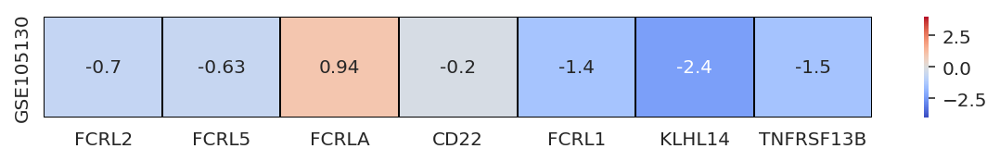

In [146]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE105130.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

# GSE140343 (+выживаемость)

In [147]:
cells_GSE140343 = cells[cells.Dataset == 'GSE140343']
cells_GSE140343

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX7135630,SRR10440857,GSE140343,Lung,Tumor,Lung,Without_treatment,Without_therapy,FlashFrozen,Lung_Adenocarcinoma,GSM4159498,NaN,mRNA was purified from total RNA using poly-T oligo-attached magnetic beads,NaN,TRIzol™ Reagent (Invitrogen),NEBNext® Ultra™ II RNA Library Prep Kit for Illumina® (NEB),NaN,17,F,73,NaN,32649877,NaN,PAIRED,22095576.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,140109.0,116257.0,128308.0,104127.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX7135631,SRR10440859,GSE140343,Lung,Tumor,Lung,Without_treatment,Without_therapy,FlashFrozen,Lung_Adenocarcinoma,GSM4159499,NaN,mRNA was purified from total RNA using poly-T oligo-attached magnetic beads,NaN,TRIzol™ Reagent (Invitrogen),NEBNext® Ultra™ II RNA Library Prep Kit for Illumina® (NEB),NaN,18,M,55,NaN,32649877,NaN,PAIRED,23035306.0,NaN,NaN,NaN,6.708333,NaN,NaN,NaN,140085.0,116233.0,128284.0,104103.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX7135632,SRR10440860,GSE140343,Lung,Tumor,Lung,Without_treatment,Without_therapy,FlashFrozen,Lung_Adenocarcinoma,GSM4159500,NaN,mRNA was purified from total RNA using poly-T oligo-attached magnetic beads,NaN,TRIzol™ Reagent (Invitrogen),NEBNext® Ultra™ II RNA Library Prep Kit for Illumina® (NEB),NaN,19,M,56,NaN,32649877,NaN,PAIRED,23408277.0,NaN,NaN,NaN,6.416667,NaN,NaN,NaN,140044.0,116192.0,128244.0,104063.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX7135633,SRR10440861,GSE140343,Lung,Tumor,Lung,Without_treatment,Without_therapy,FlashFrozen,Lung_Adenocarcinoma,GSM4159501,NaN,mRNA was purified from total RNA using poly-T oligo-attached magnetic beads,NaN,TRIzol™ Reagent (Invitrogen),NEBNext® Ultra™ II RNA Library Prep Kit for Illumina® (NEB),NaN,20,M,57,NaN,32649877,NaN,PAIRED,25189847.0,NaN,NaN,NaN,6.708333,NaN,NaN,NaN,140079.0,116227.0,128278.0,104097.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX7135634,SRR10440862,GSE140343,Lung,Tumor,Lung,Without_treatment,Without_therapy,FlashFrozen,Lung_Adenocarcinoma,GSM4159502,NaN,mRNA was purified from total RNA using poly-T oligo-attached magnetic beads,NaN,TRIzol™ Reagent (Invitrogen),NEBNext® Ultra™ II RNA Library Prep Kit for Illumina® (NEB),NaN,22,F,42,NaN,32649877,NaN,PAIRED,24683529.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,140051.0,116199.0,128250.0,104069.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRX7959413,SRR11357912,GSE140343,Lung,Adjacent normal tissue,Lung,Without_treatment,Without_therapy,FlashFrozen,Lung_Adenocarcinoma,GSM4423340,NaN,mRNA was purified from total RNA using poly-T oligo-attached magnetic beads,NaN,TRIzol™ Reagent (Invitrogen),NEBNext® Ultra™ II RNA Library Prep Kit for Illumina® (NEB),NaN,73,M,55,NaN,32649877,NaN,PAIRED,37788783.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,140091.0,116239.0,128290.0,104109.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX7959414,SRR11357913,GSE140343,Lung,Adjacent normal tissue,Lung,Without_treatment,Without_therapy,FlashFrozen,Lung_Adenocarcinoma,GSM4423341,NaN,mRNA was purified from total RNA using poly-T oligo-attached magnetic beads,NaN,TRIzol™ Reagent (Invitrogen),NEBNext® Ultra™ II RNA Library Prep Kit for Illumina® (NEB),NaN,74,M,44,NaN,32649877,NaN,PAIRED,52674882.0,NaN,NaN,NaN,

In [148]:
cells_GSE140343.Extended_tissue_type.value_counts()

Tumor                     51
Adjacent normal tissue    49
Name: Extended_tissue_type, dtype: int64

In [149]:
cells_GSE140343.Stimulation.value_counts()

Without_treatment    100
Name: Stimulation, dtype: int64

In [150]:
cells_GSE140343.Therapy.value_counts()

Without_therapy    100
Name: Therapy, dtype: int64

In [151]:
cells_GSE140343.Diagnosis.value_counts()

Lung_Adenocarcinoma    100
Name: Diagnosis, dtype: int64

In [152]:
cells_GSE140343.Material_type.value_counts()

Series([], Name: Material_type, dtype: int64)

In [153]:
expr_TPM = read_expressions(cells_GSE140343, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [154]:
all_deconv_GSE140343 = model.predict(expr_TPM[cells_GSE140343.index])
all_deconv_GSE140343.head()

Expressions OK


,SRX7135630,SRX7135631,SRX7135632,SRX7135633,SRX7135634,SRX7135635,SRX7135636,SRX7135637,SRX7135638,SRX7135639,SRX7135640,SRX7135641,SRX7135642,SRX7135643,SRX7135644,SRX7135645,SRX7135646,SRX7135647,SRX7135648,SRX7135649,SRX7135650,SRX7135651,SRX7135652,SRX7135653,SRX7135654,SRX7135655,SRX7135656,SRX7135657,SRX7135658,SRX7135659,SRX7135660,SRX7135661,SRX7135662,SRX7135663,SRX7135664,SRX7135665,SRX7135666,SRX7135667,SRX7135668,SRX7135669,SRX7135670,SRX7135671,SRX7135672,SRX7135673,SRX7135674,SRX7135675,SRX7135676,SRX7135677,SRX7135678,SRX7135679,SRX7135680,SRX7959368,SRX7959369,SRX7959370,SRX7959371,SRX7959372,SRX7959373,SRX7959374,SRX7959375,SRX7959376,SRX7959377,SRX7959378,SRX7959379,SRX7959380,SRX7959381,SRX7959382,SRX7959383,SRX7959384,SRX7959385,SRX7959386,SRX7959387,SRX7959388,SRX7959389,SRX7959390,SRX7959391,SRX7959392,SRX7959393,SRX7959394,SRX7959395,SRX7959396,SRX7959397,SRX7959398,SRX7959399,SRX7959400,SRX7959401,SRX7959402,SRX7959403,SRX7959405,SRX7959406,SRX7959407,SRX7959408,SRX7959409,SRX7959410,SRX7959411,SRX7959412,SRX7959413,SRX7959414,SRX7959415,SRX7959416,SRX7959417
Other,0.612708,0.349079,0.740691,0.379659,0.643380,0.569700,0.586304,0.607213,0.378981,0.454437,0.541935,0.565688,0.489564,0.554969,0.375259,0.746002,0.541524,0.637000,0.460281,0.708420,0.328928,0.371971,0.385086,0.403106,0.380166,0.607490,0.296897,0.557340,0.486892,0.654162,0.364824,0.615270,0.237724,0.591915,0.449383,0.528022,0.651923,0.436957,0.389433,0.401390,0.430491,0.835688,0.656380,0.642184,0.535201,0.386861,0.358373,0.676636,0.498421,0.544614,0.472778,0.501754,0.507389,0.466656,0.361691,0.354383,0.481215,0.487138,0.568997,0.394125,0.461764,0.674346,0.369668,0.392131,0.433548,0.470196,0.581064,0.444953,0.562258,0.541951,0.651416,0.533709,0.577271,0.557612,0.652955,0.597335,0.509401,0.557577,0.653612,0.588503,0.564421,0.535637,0.688277,0.638354,0.463425,0.702696,0.514711,0.467962,0.565429,0.467613,0.543408,0.599533,0.595913,0.672013,0.514608,0.521245,0.491632,0.611261,0.407491,0.482625
Basophils,0.004369,0.025344,0.004524,0.007332,0.007127,0.013468,0.023446,0.033270,0.019267,0.011494,0.000000,0.018278,0.010227,0.016154,0.026728,0.005563,0.007229,0.008616,0.007213,0.002225,0.005697,0.010425,0.009405,0.007511,0.071032,0.014539,0.019834,0.022528,0.005837,0.014107,0.011796,0.002142,0.008034,0.010494,0.050637,0.041301,0.002363,0.021477,0.010932,0.021338,0.010891,0.002351,0.004635,0.011475,0.008499,0.009282,0.015873,0.000640,0.017098,0.022575,0.004807,0.058461,0.101690,0.059967,0.059166,0.038045,0.038277,0.055547,0.057229,0.021680,0.017382,0.011806,0.059069,0.046590,0.060995,0.061695,0.047154,0.079061,0.049156,0.023723,0.019900,0.035998,0.071910,0.023331,0.001567,0.023700,0.042186,0.061450,0.017702,0.041122,0.031011,0.025153,0.010002,0.020944,0.056655,0.011767,0.004937,0.028250,0.034210,0.028516,0.037521,0.032091,0.023533,0.016024,0.047865,0.078099,0.018903,0.043430,0.025932,0.078370
CD27neg_Memory_B_cells,0.000090,0.001349,0.000000,0.000148,0.000130,0.000000,0.000107,0.000000,0.002621,0.000000,0.000330,0.000000,0.003392,0.000000,0.000000,0.000000,0.002837,0.000000,0.000000,0.000000,0.000641,0.002060,0.000000,0.000421,0.002316,0.000014,0.003964,0.000000,0.002286,0.000096,0.000497,0.000149,0.001522,0.000079,0.000115,0.000000,0.000085,0.000057,0.000000,0.000522,0.000000,0.000000,0.000000,0.000000,0.000761,0.002452,0.002875,0.000281,0.000408,0.000000,0.002145,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000022,0.000026,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000007,0.000000,0.000000,0.000006,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000111,0.000000,0.000000,0.000069,0.000031,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000011,0.000000
CD57neg_Cytotoxic_NK_cells,0.002665,0.000000,0.002206,0.000495,0.000489,0.000000,0.001609,0.000087,0.000000,0.001648,0.000000,0.000000,0.002542,0.000000,0.00000

In [155]:
all_deconv_GSE140343['Mediana'] = 'nan'

for cell in all_deconv_GSE140343.index:
    counter = []
    for ind in cells_GSE140343.index:
        counter.append(all_deconv_GSE140343[ind][cell])
    all_deconv_GSE140343['Mediana'][cell] = my_median(counter)  

all_deconv_GSE140343.head()

,SRX7135630,SRX7135631,SRX7135632,SRX7135633,SRX7135634,SRX7135635,SRX7135636,SRX7135637,SRX7135638,SRX7135639,SRX7135640,SRX7135641,SRX7135642,SRX7135643,SRX7135644,SRX7135645,SRX7135646,SRX7135647,SRX7135648,SRX7135649,SRX7135650,SRX7135651,SRX7135652,SRX7135653,SRX7135654,SRX7135655,SRX7135656,SRX7135657,SRX7135658,SRX7135659,SRX7135660,SRX7135661,SRX7135662,SRX7135663,SRX7135664,SRX7135665,SRX7135666,SRX7135667,SRX7135668,SRX7135669,SRX7135670,SRX7135671,SRX7135672,SRX7135673,SRX7135674,SRX7135675,SRX7135676,SRX7135677,SRX7135678,SRX7135679,SRX7135680,SRX7959368,SRX7959369,SRX7959370,SRX7959371,SRX7959372,SRX7959373,SRX7959374,SRX7959375,SRX7959376,SRX7959377,SRX7959378,SRX7959379,SRX7959380,SRX7959381,SRX7959382,SRX7959383,SRX7959384,SRX7959385,SRX7959386,SRX7959387,SRX7959388,SRX7959389,SRX7959390,SRX7959391,SRX7959392,SRX7959393,SRX7959394,SRX7959395,SRX7959396,SRX7959397,SRX7959398,SRX7959399,SRX7959400,SRX7959401,SRX7959402,SRX7959403,SRX7959405,SRX7959406,SRX7959407,SRX7959408,SRX7959409,SRX7959410,SRX7959411,SRX7959412,SRX7959413,SRX7959414,SRX7959415,SRX7959416,SRX7959417,Mediana
Other,0.612708,0.349079,0.740691,0.379659,0.643380,0.569700,0.586304,0.607213,0.378981,0.454437,0.541935,0.565688,0.489564,0.554969,0.375259,0.746002,0.541524,0.637000,0.460281,0.708420,0.328928,0.371971,0.385086,0.403106,0.380166,0.607490,0.296897,0.557340,0.486892,0.654162,0.364824,0.615270,0.237724,0.591915,0.449383,0.528022,0.651923,0.436957,0.389433,0.401390,0.430491,0.835688,0.656380,0.642184,0.535201,0.386861,0.358373,0.676636,0.498421,0.544614,0.472778,0.501754,0.507389,0.466656,0.361691,0.354383,0.481215,0.487138,0.568997,0.394125,0.461764,0.674346,0.369668,0.392131,0.433548,0.470196,0.581064,0.444953,0.562258,0.541951,0.651416,0.533709,0.577271,0.557612,0.652955,0.597335,0.509401,0.557577,0.653612,0.588503,0.564421,0.535637,0.688277,0.638354,0.463425,0.702696,0.514711,0.467962,0.565429,0.467613,0.543408,0.599533,0.595913,0.672013,0.514608,0.521245,0.491632,0.611261,0.407491,0.482625,0.530865
Basophils,0.004369,0.025344,0.004524,0.007332,0.007127,0.013468,0.023446,0.033270,0.019267,0.011494,0.000000,0.018278,0.010227,0.016154,0.026728,0.005563,0.007229,0.008616,0.007213,0.002225,0.005697,0.010425,0.009405,0.007511,0.071032,0.014539,0.019834,0.022528,0.005837,0.014107,0.011796,0.002142,0.008034,0.010494,0.050637,0.041301,0.002363,0.021477,0.010932,0.021338,0.010891,0.002351,0.004635,0.011475,0.008499,0.009282,0.015873,0.000640,0.017098,0.022575,0.004807,0.058461,0.101690,0.059967,0.059166,0.038045,0.038277,0.055547,0.057229,0.021680,0.017382,0.011806,0.059069,0.046590,0.060995,0.061695,0.047154,0.079061,0.049156,0.023723,0.019900,0.035998,0.071910,0.023331,0.001567,0.023700,0.042186,0.061450,0.017702,0.041122,0.031011,0.025153,0.010002,0.020944,0.056655,0.011767,0.004937,0.028250,0.034210,0.028516,0.037521,0.032091,0.023533,0.016024,0.047865,0.078099,0.018903,0.043430,0.025932,0.078370,0.0204219
CD27neg_Memory_B_cells,0.000090,0.001349,0.000000,0.000148,0.000130,0.000000,0.000107,0.000000,0.002621,0.000000,0.000330,0.000000,0.003392,0.000000,0.000000,0.000000,0.002837,0.000000,0.000000,0.000000,0.000641,0.002060,0.000000,0.000421,0.002316,0.000014,0.003964,0.000000,0.002286,0.000096,0.000497,0.000149,0.001522,0.000079,0.000115,0.000000,0.000085,0.000057,0.000000,0.000522,0.000000,0.000000,0.000000,0.000000,0.000761,0.002452,0.002875,0.000281,0.000408,0.000000,0.002145,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000022,0.000026,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000007,0.000000,0.000000,0.000006,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000111,0.000000,0.000000,0.000069,0.000031,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000011,0.000000,0
CD57neg_Cytotoxic_NK_cells,0.002665,0.000000,0.002206,0.000495,0.000489,0.000000,0.001609,0.000087,0.000000,0.001648,0.000000,0.000

In [156]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE140343['Mediana'].index, y=all_deconv_GSE140343['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE140343)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [157]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE140343.Extended_tissue_type.unique():
    dict_illness[illness] = cells_GSE140343[cells_GSE140343.Extended_tissue_type == illness].index

dict_illness

{'Tumor': Index(['SRX7135630', 'SRX7135631', 'SRX7135632', 'SRX7135633', 'SRX7135634',
        'SRX7135635', 'SRX7135636', 'SRX7135637', 'SRX7135638', 'SRX7135639',
        'SRX7135640', 'SRX7135641', 'SRX7135642', 'SRX7135643', 'SRX7135644',
        'SRX7135645', 'SRX7135646', 'SRX7135647', 'SRX7135648', 'SRX7135649',
        'SRX7135650', 'SRX7135651', 'SRX7135652', 'SRX7135653', 'SRX7135654',
        'SRX7135655', 'SRX7135656', 'SRX7135657', 'SRX7135658', 'SRX7135659',
        'SRX7135660', 'SRX7135661', 'SRX7135662', 'SRX7135663', 'SRX7135664',
        'SRX7135665', 'SRX7135666', 'SRX7135667', 'SRX7135668', 'SRX7135669',
        'SRX7135670', 'SRX7135671', 'SRX7135672', 'SRX7135673', 'SRX7135674',
        'SRX7135675', 'SRX7135676', 'SRX7135677', 'SRX7135678', 'SRX7135679',
        'SRX7135680'],
       dtype='object', name='Sample'),
 'Adjacent normal tissue': Index(['SRX7959368', 'SRX7959369', 'SRX7959370', 'SRX7959371', 'SRX7959372',
        'SRX7959373', 'SRX7959374', 'SRX79593

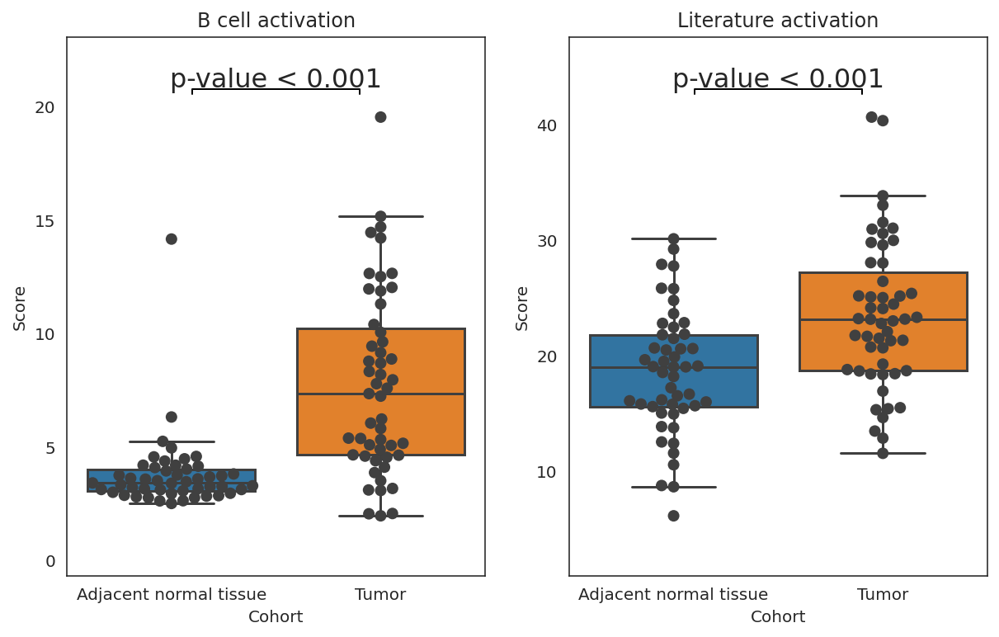

In [158]:
signature_analysis( data2 = expr_TPM[dict_illness['Adjacent normal tissue']],
                   data1 = expr_TPM[dict_illness['Tumor']],
                   label2 = 'Adjacent normal tissue', 
                   label1 = 'Tumor',
                  order = ['Adjacent normal tissue', 'Tumor'])

In [159]:
check = expr_TPM[dict_illness['Tumor']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Tumor']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

TNFRSF13B 2.791707903530921
FCRL5 5.12339427497998
KLHL14 0.23849530043107006
FCRL1 0.39158673021742446
CD22 5.519782547866781
FCRLA 3.1399415783878584
FCRL2 2.29140648038088


In [160]:
expr_counts_GSE140343 = read_expressions(cells_GSE140343, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [161]:
#для всех генов

list_edgeR = []
control = 'Adjacent normal tissue'
interest = 'Tumor'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE140343, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[                  logFC    logCPM         PValue            FDR
 RPS29         -3.065378  7.663348  2.289662e-144  4.593520e-140
 TMEM238       -5.209620  3.560781  5.341934e-129  5.358494e-125
 PTMS          -3.046763  7.866553  2.021306e-127  1.351715e-123
 ATP5I         -2.780515  5.092853  3.216009e-109  1.612989e-105
 PYCR1          3.230893  5.987371  7.047464e-108  2.827724e-104
 ...                 ...       ...            ...            ...
 TRIM42         0.000000 -3.831946  1.000000e+00   1.000000e+00 
 TSPY3          0.000000 -3.831946  1.000000e+00   1.000000e+00 
 TSPY4          0.000000 -3.831946  1.000000e+00   1.000000e+00 
 WI2-3308P17.2  0.000000 -3.831946  1.000000e+00   1.000000e+00 
 ZCCHC13        0.000000 -3.831946  1.000000e+00   1.000000e+00 
 
 [20062 rows x 4 columns]]

In [162]:
stimulation_expr_edgeR_GSE140343 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE140343.columns = ['GSE140343']
stimulation_expr_edgeR_GSE140343 = stimulation_expr_edgeR_GSE140343.loc[stimulation_expr_edgeR_GSE140343.index.isin(my_genes)]
stimulation_expr_edgeR_GSE140343.head()

,GSE140343
FCRL5,3.983111
FCRL2,2.619930
FCRLA,2.429971
TNFRSF13B,1.010491
FCRL1,1.142626


<AxesSubplot:>

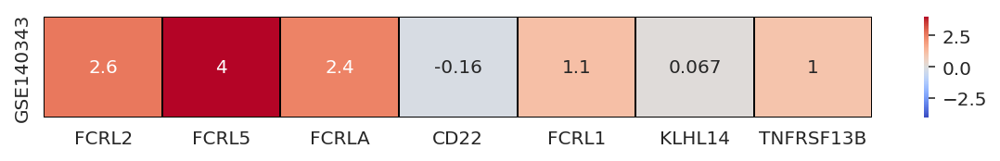

In [164]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE140343.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

In [166]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE140343.loc[lit_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

KeyError: "None of [Index(['TNFSF4', 'ICOSLG', 'CD86', 'CD38', 'CD80', 'FAS', 'IL2RA', 'CD69',\n       'CD44', 'CD274', 'CD81', 'TFRC', 'SLC3A2', 'CD70', 'CD83', 'ITGA4',\n       'ITGB1', 'FCER2'],\n      dtype='object')] are in the [index]"

<Figure size 720x72 with 0 Axes>

# GSE174330

In [167]:
cells_GSE174330 = cells[cells.Dataset == 'GSE174330']
cells_GSE174330

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX10855910,SRR14510097,GSE174330,Lung,Tumor,Lung,Without_stimulation,No_data,FlashFrozen,Non_Small_Cell_Lung_Carcinoma,GSM5291941,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),QuantSeq 3' mRNA-Seq Library Prep Kits (Lexogen),NaN,10,33% male,Adult,18-90,34556645,NaN,SINGLE,7819670.0,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,163656.0,138585.0,148387.0,122990.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,European American,NaN,NaN
SRX10855911,SRR14510098,GSE174330,Lung,Tumor,Lung,Without_stimulation,No_data,FlashFrozen,Non_Small_Cell_Lung_Carcinoma,GSM5291942,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),QuantSeq 3' mRNA-Seq Library Prep Kits (Lexogen),NaN,11,33% male,Adult,18-90,34556645,NaN,SINGLE,8019124.0,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,163635.0,138564.0,148366.0,122969.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,European American,NaN,NaN
SRX10855912,SRR14510099,GSE174330,Lung,Tumor,Lung,Without_stimulation,No_data,FlashFrozen,Non_Small_Cell_Lung_Carcinoma,GSM5291943,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),QuantSeq 3' mRNA-Seq Library Prep Kits (Lexogen),NaN,12,22% male,Adult,18-90,34556645,NaN,SINGLE,9089284.0,NaN,NaN,NaN,4.666667,NaN,NaN,NaN,163543.0,138472.0,148274.0,122877.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,African American,NaN,NaN
SRX10855913,SRR14510100,GSE174330,Lung,Tumor,Lung,Without_stimulation,No_data,FlashFrozen,Non_Small_Cell_Lung_Carcinoma,GSM5291944,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),QuantSeq 3' mRNA-Seq Library Prep Kits (Lexogen),NaN,13,33% male,Adult,18-90,34556645,NaN,SINGLE,9807876.0,NaN,NaN,NaN,4.958333,NaN,NaN,NaN,163557.0,138486.0,148288.0,122891.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,European American,NaN,NaN
SRX10855914,SRR14510101,GSE174330,Lung,Tumor,Lung,Without_stimulation,No_data,FlashFrozen,Non_Small_Cell_Lung_Carcinoma,GSM5291945,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),QuantSeq 3' mRNA-Seq Library Prep Kits (Lexogen),NaN,14,33% male,Adult,18-90,34556645,NaN,SINGLE,11514912.0,NaN,NaN,NaN,5.250000,NaN,NaN,NaN,163558.0,138487.0,148289.0,122892.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,European American,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRX10856095,SRR14510282,GSE174330,Lung,Adjacent normal tissue,Lung,Without_stimulation,No_data,FlashFrozen,Non_Small_Cell_Lung_Carcinoma,GSM5292126,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),QuantSeq 3' mRNA-Seq Library Prep Kits (Lexogen),NaN,9,22% male,Adult,18-90,34556645,NaN,SINGLE,10676567.0,NaN,NaN,NaN,4.958333,NaN,NaN,NaN,163578.0,138507.0,148309.0,122912.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,African American,NaN,NaN
SRX10856097,SRR14510284,GSE174330,Lung,Adjacent normal tissue,Lung,Without_stimulation,No_data,FlashFrozen,Non_Small_Cell_Lung_Carcinoma,GSM5292128,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),QuantSeq 3' mRNA-Seq Library Prep Kits (Lexogen),NaN,91,33% male,Adult,18-90,34556645,NaN,SINGLE,6118951.0,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,163672.0,138601.0,148403.0,123006.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,European American,NaN,NaN
SRX10856099,SRR14510286,GSE174330,Lung,Adjacent normal tissue,Lung,Without_stimulation,No_data,FlashFrozen,Non_Small_Cell_Lung_Carcinoma,GSM5292130,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),QuantSeq 3' mRNA-Seq Library Prep Kits (Lexogen),NaN,93,22% male,Adult,18-

In [168]:
cells_GSE174330.Extended_tissue_type.value_counts()

Adjacent normal tissue    80
Tumor                     77
Name: Extended_tissue_type, dtype: int64

In [169]:
cells_GSE174330.Stimulation.value_counts()

Without_stimulation    157
Name: Stimulation, dtype: int64

In [170]:
cells_GSE174330.Therapy.value_counts()

No_data    157
Name: Therapy, dtype: int64

In [171]:
cells_GSE174330.Diagnosis.value_counts()

Non_Small_Cell_Lung_Carcinoma    157
Name: Diagnosis, dtype: int64

In [172]:
cells_GSE174330.Material_type.value_counts()

Series([], Name: Material_type, dtype: int64)

In [173]:
expr_TPM = read_expressions(cells_GSE174330, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [174]:
all_deconv_GSE174330 = model.predict(expr_TPM[cells_GSE174330.index])
all_deconv_GSE174330.head()

Expressions OK


,SRX10855910,SRX10855911,SRX10855912,SRX10855913,SRX10855914,SRX10855915,SRX10855916,SRX10855917,SRX10855918,SRX10855919,SRX10855920,SRX10855921,SRX10855922,SRX10855924,SRX10855925,SRX10855926,SRX10855927,SRX10855928,SRX10855929,SRX10855930,SRX10855932,SRX10855933,SRX10855934,SRX10855935,SRX10855936,SRX10855937,SRX10855938,SRX10855939,SRX10855940,SRX10855941,SRX10855944,SRX10855945,SRX10855946,SRX10855947,SRX10855948,SRX10855949,SRX10855950,SRX10855951,SRX10855952,SRX10855954,SRX10855955,SRX10855956,SRX10855957,SRX10855958,SRX10855961,SRX10855963,SRX10855965,SRX10855966,SRX10855967,SRX10855968,SRX10855969,SRX10855970,SRX10855971,SRX10855972,SRX10855974,SRX10855976,SRX10855977,SRX10855978,SRX10855979,SRX10855980,SRX10855981,SRX10855982,SRX10855984,SRX10855986,SRX10855988,SRX10855989,SRX10855990,SRX10855991,SRX10855992,SRX10855993,SRX10855994,SRX10855996,SRX10855997,SRX10855998,SRX10856001,SRX10856005,SRX10856006,SRX10856008,SRX10856009,SRX10856010,SRX10856011,SRX10856012,SRX10856013,SRX10856014,SRX10856015,SRX10856016,SRX10856017,SRX10856019,SRX10856020,SRX10856021,SRX10856022,SRX10856023,SRX10856024,SRX10856025,SRX10856026,SRX10856027,SRX10856028,SRX10856030,SRX10856031,SRX10856032,SRX10856033,SRX10856034,SRX10856035,SRX10856036,SRX10856037,SRX10856038,SRX10856039,SRX10856041,SRX10856042,SRX10856043,SRX10856044,SRX10856045,SRX10856046,SRX10856047,SRX10856048,SRX10856049,SRX10856050,SRX10856052,SRX10856053,SRX10856054,SRX10856055,SRX10856056,SRX10856057,SRX10856058,SRX10856060,SRX10856061,SRX10856063,SRX10856064,SRX10856065,SRX10856066,SRX10856067,SRX10856068,SRX10856069,SRX10856070,SRX10856071,SRX10856072,SRX10856074,SRX10856075,SRX10856076,SRX10856077,SRX10856078,SRX10856079,SRX10856080,SRX10856081,SRX10856082,SRX10856083,SRX10856085,SRX10856087,SRX10856088,SRX10856089,SRX10856091,SRX10856094,SRX10856095,SRX10856097,SRX10856099,SRX10856100,SRX10856101
Other,0.393067,0.458138,0.414595,0.656164,0.685302,0.574297,0.556707,0.712251,0.805510,0.687643,0.513949,0.556306,0.369340,0.796761,0.462328,0.460570,0.796942,0.765175,0.670431,0.659356,0.825082,0.594717,0.540662,0.536200,0.792899,0.914327,0.427123,0.450760,0.487743,0.432411,0.841784,0.537608,0.487358,0.624029,0.530426,0.813960,0.410209,0.665050,0.569085,0.664280,0.905324,0.510621,0.888000,0.781210,0.365222,0.870280,0.484506,0.401381,0.629298,0.845492,0.545205,0.533700,0.538910,0.758054,0.271915,0.578261,0.579685,0.591350,0.758371,0.405189,0.674657,0.766434,0.577071,0.641990,0.577431,0.710747,0.661100,0.520146,0.766389,0.664113,0.657180,0.924960,0.823257,0.547712,0.600213,0.559361,0.528407,0.482842,0.402026,0.591226,0.551673,0.455727,0.539038,0.507555,0.544034,0.571240,0.625279,0.518835,0.594072,0.792101,5.495167e-01,0.589753,0.504242,0.522481,0.504358,0.617344,0.572663,0.504850,0.516770,0.514910,0.547864,0.517136,0.481192,0.649924,0.620203,0.349279,0.522268,0.528229,0.623618,0.505055,0.516277,0.556097,0.525566,5.853549e-01,0.642874,0.565801,0.453293,0.961056,0.606610,0.582075,0.581141,0.605996,0.501092,0.564526,0.531457,0.495138,0.530810,0.424047,0.422521,0.529550,0.443373,0.553894,0.556491,0.581876,0.445815,0.496406,0.645171,0.507894,0.558472,7.433243e-01,0.503762,0.590697,0.598456,0.653689,0.815207,0.530941,0.602136,0.490179,0.430901,0.475290,0.600319,4.721071e-01,0.474751,0.648078,0.598602,0.650054,0.691325
Basophils,0.005672,0.002042,0.000775,0.000185,0.006665,0.004828,0.010854,0.006906,0.002523,0.000325,0.005648,0.008083,0.018622,0.002236,0.006652,0.000744,0.001270,0.000408,0.002193,0.006200,0.000031,0.014774,0.001064,0.013866,0.002470,0.000015,0.007437,0.008471,0.003250,0.015305,0.004825,0.000527,0.011527,0.039117,0.003874,0.003782,0.000773,0.004239,0.009828,0.018049,0.006127,0.008572,0.000000,0.010620,0.009708,0.000761,0.001644,0.004636,0.006226,0.000000,0.005536,0.006973,0.003516,0.009102,0.005539,0.003797,0.003899,0.003648,0.000749,0.007510,0.004634,0.002207,0.017214,0.008723,0.009644,0.007906,0.017592,0.007239,0.001213,0.012061,0.010238,0.001201,0.000000,0.011190,0.00

In [175]:
all_deconv_GSE174330['Mediana'] = 'nan'

for cell in all_deconv_GSE174330.index:
    counter = []
    for ind in cells_GSE174330.index:
        counter.append(all_deconv_GSE174330[ind][cell])
    all_deconv_GSE174330['Mediana'][cell] = my_median(counter)  

all_deconv_GSE174330.head()

,SRX10855910,SRX10855911,SRX10855912,SRX10855913,SRX10855914,SRX10855915,SRX10855916,SRX10855917,SRX10855918,SRX10855919,SRX10855920,SRX10855921,SRX10855922,SRX10855924,SRX10855925,SRX10855926,SRX10855927,SRX10855928,SRX10855929,SRX10855930,SRX10855932,SRX10855933,SRX10855934,SRX10855935,SRX10855936,SRX10855937,SRX10855938,SRX10855939,SRX10855940,SRX10855941,SRX10855944,SRX10855945,SRX10855946,SRX10855947,SRX10855948,SRX10855949,SRX10855950,SRX10855951,SRX10855952,SRX10855954,SRX10855955,SRX10855956,SRX10855957,SRX10855958,SRX10855961,SRX10855963,SRX10855965,SRX10855966,SRX10855967,SRX10855968,SRX10855969,SRX10855970,SRX10855971,SRX10855972,SRX10855974,SRX10855976,SRX10855977,SRX10855978,SRX10855979,SRX10855980,SRX10855981,SRX10855982,SRX10855984,SRX10855986,SRX10855988,SRX10855989,SRX10855990,SRX10855991,SRX10855992,SRX10855993,SRX10855994,SRX10855996,SRX10855997,SRX10855998,SRX10856001,SRX10856005,SRX10856006,SRX10856008,SRX10856009,SRX10856010,SRX10856011,SRX10856012,SRX10856013,SRX10856014,SRX10856015,SRX10856016,SRX10856017,SRX10856019,SRX10856020,SRX10856021,SRX10856022,SRX10856023,SRX10856024,SRX10856025,SRX10856026,SRX10856027,SRX10856028,SRX10856030,SRX10856031,SRX10856032,SRX10856033,SRX10856034,SRX10856035,SRX10856036,SRX10856037,SRX10856038,SRX10856039,SRX10856041,SRX10856042,SRX10856043,SRX10856044,SRX10856045,SRX10856046,SRX10856047,SRX10856048,SRX10856049,SRX10856050,SRX10856052,SRX10856053,SRX10856054,SRX10856055,SRX10856056,SRX10856057,SRX10856058,SRX10856060,SRX10856061,SRX10856063,SRX10856064,SRX10856065,SRX10856066,SRX10856067,SRX10856068,SRX10856069,SRX10856070,SRX10856071,SRX10856072,SRX10856074,SRX10856075,SRX10856076,SRX10856077,SRX10856078,SRX10856079,SRX10856080,SRX10856081,SRX10856082,SRX10856083,SRX10856085,SRX10856087,SRX10856088,SRX10856089,SRX10856091,SRX10856094,SRX10856095,SRX10856097,SRX10856099,SRX10856100,SRX10856101,Mediana
Other,0.393067,0.458138,0.414595,0.656164,0.685302,0.574297,0.556707,0.712251,0.805510,0.687643,0.513949,0.556306,0.369340,0.796761,0.462328,0.460570,0.796942,0.765175,0.670431,0.659356,0.825082,0.594717,0.540662,0.536200,0.792899,0.914327,0.427123,0.450760,0.487743,0.432411,0.841784,0.537608,0.487358,0.624029,0.530426,0.813960,0.410209,0.665050,0.569085,0.664280,0.905324,0.510621,0.888000,0.781210,0.365222,0.870280,0.484506,0.401381,0.629298,0.845492,0.545205,0.533700,0.538910,0.758054,0.271915,0.578261,0.579685,0.591350,0.758371,0.405189,0.674657,0.766434,0.577071,0.641990,0.577431,0.710747,0.661100,0.520146,0.766389,0.664113,0.657180,0.924960,0.823257,0.547712,0.600213,0.559361,0.528407,0.482842,0.402026,0.591226,0.551673,0.455727,0.539038,0.507555,0.544034,0.571240,0.625279,0.518835,0.594072,0.792101,5.495167e-01,0.589753,0.504242,0.522481,0.504358,0.617344,0.572663,0.504850,0.516770,0.514910,0.547864,0.517136,0.481192,0.649924,0.620203,0.349279,0.522268,0.528229,0.623618,0.505055,0.516277,0.556097,0.525566,5.853549e-01,0.642874,0.565801,0.453293,0.961056,0.606610,0.582075,0.581141,0.605996,0.501092,0.564526,0.531457,0.495138,0.530810,0.424047,0.422521,0.529550,0.443373,0.553894,0.556491,0.581876,0.445815,0.496406,0.645171,0.507894,0.558472,7.433243e-01,0.503762,0.590697,0.598456,0.653689,0.815207,0.530941,0.602136,0.490179,0.430901,0.475290,0.600319,4.721071e-01,0.474751,0.648078,0.598602,0.650054,0.691325,0.559361
Basophils,0.005672,0.002042,0.000775,0.000185,0.006665,0.004828,0.010854,0.006906,0.002523,0.000325,0.005648,0.008083,0.018622,0.002236,0.006652,0.000744,0.001270,0.000408,0.002193,0.006200,0.000031,0.014774,0.001064,0.013866,0.002470,0.000015,0.007437,0.008471,0.003250,0.015305,0.004825,0.000527,0.011527,0.039117,0.003874,0.003782,0.000773,0.004239,0.009828,0.018049,0.006127,0.008572,0.000000,0.010620,0.009708,0.000761,0.001644,0.004636,0.006226,0.000000,0.005536,0.006973,0.003516,0.009102,0.005539,0.003797,0.003899,0.003648,0.000749,0.007510,0.004634,0.002207,0.017214,0.008723,0.009644,0.007906,0.017592,0.007239,0.001213,0.012061,0.010238,0.001201,0.000

In [176]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE174330['Mediana'].index, y=all_deconv_GSE174330['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE174330)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [177]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE174330.Extended_tissue_type.unique():
    dict_illness[illness] = cells_GSE174330[cells_GSE174330.Extended_tissue_type == illness].index

dict_illness

{'Tumor': Index(['SRX10855910', 'SRX10855911', 'SRX10855912', 'SRX10855913',
        'SRX10855914', 'SRX10855915', 'SRX10855916', 'SRX10855917',
        'SRX10855918', 'SRX10855919', 'SRX10855920', 'SRX10855921',
        'SRX10855922', 'SRX10855924', 'SRX10855925', 'SRX10855926',
        'SRX10855927', 'SRX10855928', 'SRX10855929', 'SRX10855930',
        'SRX10855932', 'SRX10855933', 'SRX10855934', 'SRX10855935',
        'SRX10855936', 'SRX10855937', 'SRX10855938', 'SRX10855939',
        'SRX10855940', 'SRX10855941', 'SRX10855944', 'SRX10855945',
        'SRX10855946', 'SRX10855947', 'SRX10855948', 'SRX10855949',
        'SRX10855950', 'SRX10855951', 'SRX10855952', 'SRX10855954',
        'SRX10855955', 'SRX10855956', 'SRX10855957', 'SRX10855958',
        'SRX10855961', 'SRX10855963', 'SRX10855965', 'SRX10855966',
        'SRX10855967', 'SRX10855968', 'SRX10855969', 'SRX10855970',
        'SRX10855971', 'SRX10855972', 'SRX10855974', 'SRX10855976',
        'SRX10855977', 'SRX10855978', '

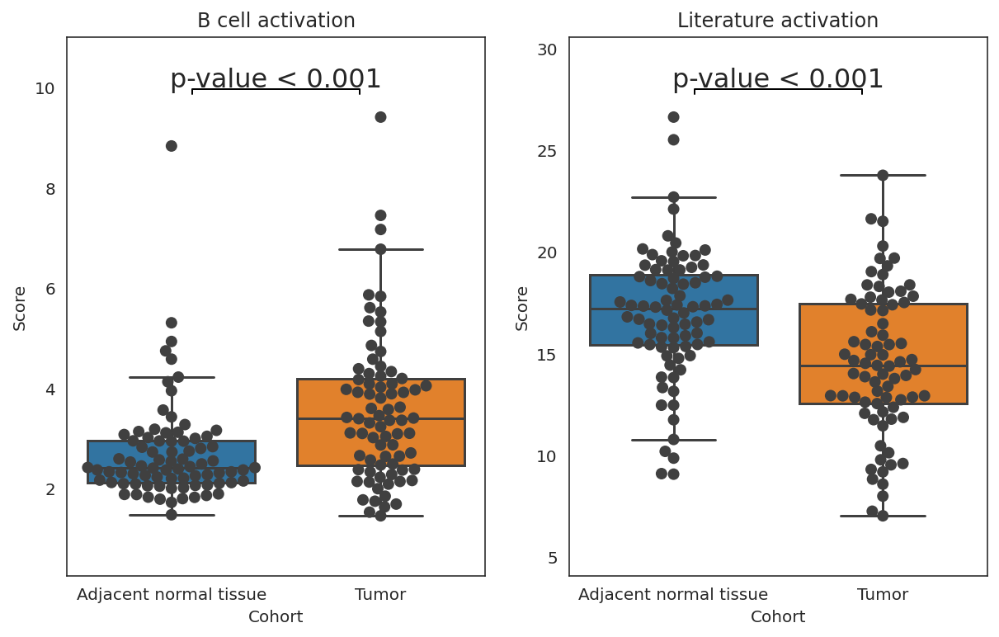

In [178]:
signature_analysis( data2 = expr_TPM[dict_illness['Adjacent normal tissue']],
                   data1 = expr_TPM[dict_illness['Tumor']],
                   label2 = 'Adjacent normal tissue', 
                   label1 = 'Tumor',
                  order = ['Adjacent normal tissue', 'Tumor'])

In [179]:
check = expr_TPM[dict_illness['Tumor']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Tumor']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

TNFRSF13B 1.2003552985476613
FCRL5 6.979094847346877
KLHL14 0.13871170554971995
FCRL1 0.0
CD22 2.9869075944724393
FCRLA 4.436136294468285
FCRL2 2.446288507991471


In [180]:
expr_counts_GSE174330 = read_expressions(cells_GSE174330, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [181]:
#для всех генов

list_edgeR = []
control = 'Adjacent normal tissue'
interest = 'Tumor'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE174330, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[            logFC    logCPM        PValue           FDR
 SLC6A4  -4.129583  6.641532  4.767977e-58  9.565515e-54
 SULF1    2.663132  6.173627  5.774744e-54  5.792645e-50
 SPP1     4.123275  8.945537  9.286911e-53  6.210467e-49
 EMP2    -2.032326  9.949331  5.884618e-52  2.951430e-48
 SEMA3G  -2.729894  5.681360  1.053847e-48  4.228457e-45
 ...           ...       ...           ...           ...
 ZNF385C  0.000000 -2.242365  1.000000e+00  1.000000e+00
 ZNF679   0.000000 -2.242365  1.000000e+00  1.000000e+00
 ZNF705B  0.000000 -2.242365  1.000000e+00  1.000000e+00
 ZNRF4    0.000000 -2.242365  1.000000e+00  1.000000e+00
 ZP4      0.000000 -2.242365  1.000000e+00  1.000000e+00
 
 [20062 rows x 4 columns]]

In [182]:
stimulation_expr_edgeR_GSE174330 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE174330.columns = ['GSE174330']
stimulation_expr_edgeR_GSE174330 = stimulation_expr_edgeR_GSE174330.loc[stimulation_expr_edgeR_GSE174330.index.isin(my_genes)]
stimulation_expr_edgeR_GSE174330.head()

,GSE174330
FCRL5,2.128244
FCRLA,1.874344
FCRL2,0.932235
TNFRSF13B,1.122702
KLHL14,0.801505


<AxesSubplot:>

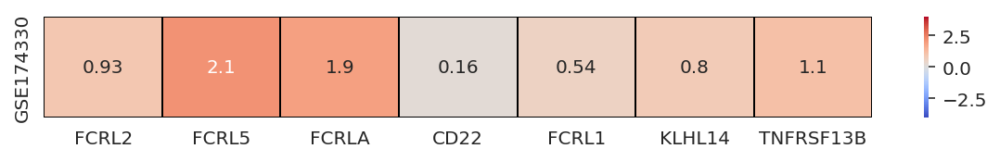

In [183]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE174330.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

<AxesSubplot:>

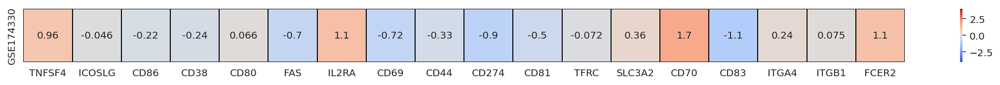

In [626]:
plt.figure(figsize=(20,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE174330.loc[lit_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

# GSE102312 (не работает)

In [319]:
cells_GSE102312 = cells[cells.Dataset == 'GSE102312']
cells_GSE102312

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX3067472,SRR5905928,GSE102312,Bone_marrow,NaN,Bone_marrow,Without_treatment,No_data,No_data,Chronic_Myelomonocytic_Leukemia,GSM2734433,NaN,NaN,NaN,RNeasy mini kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",NaN,LM_1,M,No_data,NaN,No_data,polyA RNA,PAIRED,36538114.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,117453.0,93999.0,109742.0,85934.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3067473,SRR5905929,GSE102312,Bone_marrow,NaN,Bone_marrow,Without_treatment,No_data,No_data,Chronic_Myelomonocytic_Leukemia,GSM2734434,NaN,NaN,NaN,RNeasy mini kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",NaN,LM_2,M,No_data,NaN,No_data,polyA RNA,PAIRED,39506518.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,117456.0,94002.0,109745.0,85937.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3067474,SRR5905930,GSE102312,Bone_marrow,NaN,Bone_marrow,Without_treatment,No_data,No_data,Chronic_Myelomonocytic_Leukemia,GSM2734435,NaN,NaN,NaN,RNeasy mini kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",NaN,LM_11,F,No_data,NaN,No_data,polyA RNA,PAIRED,32586258.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,117460.0,94006.0,109749.0,85941.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3067475,SRR5905931,GSE102312,Bone_marrow,NaN,Bone_marrow,Without_treatment,No_data,No_data,Chronic_Myelomonocytic_Leukemia,GSM2734436,NaN,NaN,NaN,RNeasy mini kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",NaN,LM_13,M,No_data,NaN,No_data,polyA RNA,PAIRED,48477719.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,117455.0,94001.0,109744.0,85936.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3067476,SRR5905932,GSE102312,Bone_marrow,NaN,Bone_marrow,Without_treatment,No_data,No_data,Chronic_Myelomonocytic_Leukemia,GSM2734437,NaN,NaN,NaN,RNeasy mini kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",NaN,LM_14,F,No_data,NaN,No_data,polyA RNA,PAIRED,34161265.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,117457.0,94003.0,109746.0,85938.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3067477,SRR5905933,GSE102312,Bone_marrow,NaN,Bone_marrow,Without_treatment,No_data,No_data,Chronic_Myelomonocytic_Leukemia,GSM2734438,NaN,NaN,NaN,RNeasy mini kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",NaN,LM_18,M,No_data,NaN,No_data,polyA RNA,PAIRED,40030334.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,117470.0,94016.0,109759.0,85951.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3067478,SRR5905934,GSE102312,Bone_marrow,NaN,Bone_marrow,Without_treatment,No_data,No_data,Chronic_Myelomonocytic_Leukemia,GSM2734439,NaN,NaN,NaN,RNeasy mini kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",NaN,LM_19,F,No_data,NaN,No_data,polyA RNA,PAIRED,40343687.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,117464.0,94010.0,109753.0,85945.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX3067479,SRR5905935,GSE102312,Bone_marrow,NaN,Bone_marrow,Without_treatment,No_data,No_data,Chronic_Myelomonocytic_Leukemia,GSM2734440,NaN,NaN,NaN,RNeasy mini kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",NaN,LM_27,F,No_data,NaN,No_data,polyA RNA,PAIRED,37286396.0,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,117465.0,94011.0,109754.0,85946.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [185]:
cells_GSE102312.Extended_tissue_type.value_counts()

Series([], Name: Extended_tissue_type, dtype: int64)

In [186]:
cells_GSE102312.Stimulation.value_counts()

Without_treatment    32
Name: Stimulation, dtype: int64

In [187]:
cells_GSE102312.Therapy.value_counts()

No_data            25
Without_therapy    7 
Name: Therapy, dtype: int64

In [188]:
cells_GSE102312.Diagnosis.value_counts()

Chronic_Myelomonocytic_Leukemia    25
Healthy                            7 
Name: Diagnosis, dtype: int64

In [189]:
cells_GSE102312.Material_type.value_counts()

polyA RNA    32
Name: Material_type, dtype: int64

In [190]:
expr_TPM = read_expressions(cells_GSE102312, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [191]:
all_deconv_GSE102312 = model.predict(expr_TPM[cells_GSE102312.index])
all_deconv_GSE102312.head()

Expressions OK


,SRX3067472,SRX3067473,SRX3067474,SRX3067475,SRX3067476,SRX3067477,SRX3067478,SRX3067479,SRX3067480,SRX3067481,SRX3067482,SRX3067483,SRX3067484,SRX3067485,SRX3067486,SRX3067487,SRX3067488,SRX3067489,SRX3067490,SRX3067491,SRX3067492,SRX3067493,SRX3067494,SRX3067495,SRX3067496,SRX3067497,SRX3067498,SRX3067499,SRX3067500,SRX3067501,SRX3067502,SRX3067503
Other,0.050525,0.022517,0.032754,0.044201,0.023370,0.033892,0.046772,0.011092,0.038772,0.016431,0.011450,0.043382,0.042646,0.044676,0.056050,0.015306,0.034278,0.007416,0.083214,0.103991,7.460767e-02,0.078298,0.065339,0.082377,0.002197,0.072989,0.000118,0.032995,0.086704,0.016191,0.027900,0.085986
Basophils,0.002280,0.026943,0.001971,0.001700,0.025083,0.009904,0.003404,0.003820,0.004633,0.001173,0.001812,0.003433,0.017486,0.001880,0.008458,0.018583,0.003846,0.000197,0.018206,0.011860,7.942365e-03,0.007643,0.012474,0.000648,0.000000,0.001433,0.002839,0.001341,0.004829,0.001309,0.001090,0.003547
CD27neg_Memory_B_cells,0.000091,0.000026,0.000005,0.000004,0.000032,0.000013,0.000040,0.000128,0.000042,0.000010,0.000081,0.000086,0.000011,0.000085,0.000043,0.000155,0.000132,0.000288,0.000022,0.000104,2.774732e-07,0.000000,0.000030,0.000015,0.000334,0.000041,0.000597,0.000000,0.000007,0.000244,0.000109,0.000065
CD57neg_Cytotoxic_NK_cells,0.002759,0.006337,0.003676,0.000458,0.006309,0.005757,0.003565,0.005688,0.007014,0.001502,0.006344,0.006302,0.002339,0.002840,0.003854,0.002287,0.002453,0.014585,0.005398,0.003309,2.114400e-03,0.002611,0.001762,0.004764,0.002067,0.004649,0.000000,0.005249,0.002057,0.008835,0.005654,0.001816
CD57pos_Cytotoxic_NK_cells,0.004275,0.007577,0.007420,0.000435,0.007477,0.003382,0.001673,0.009723,0.003403,0.003452,0.018983,0.009933,0.001345,0.002602,0.008196,0.007785,0.005634,0.020793,0.002773,0.001609,1.933914e-03,0.002637,0.000423,0.003424,0.007533,0.004027,0.000000,0.010730,0.003346,0.011759,0.008590,0.002317


In [192]:
all_deconv_GSE102312['Mediana'] = 'nan'

for cell in all_deconv_GSE102312.index:
    counter = []
    for ind in cells_GSE102312.index:
        counter.append(all_deconv_GSE102312[ind][cell])
    all_deconv_GSE102312['Mediana'][cell] = my_median(counter)  

all_deconv_GSE102312.head()

,SRX3067472,SRX3067473,SRX3067474,SRX3067475,SRX3067476,SRX3067477,SRX3067478,SRX3067479,SRX3067480,SRX3067481,SRX3067482,SRX3067483,SRX3067484,SRX3067485,SRX3067486,SRX3067487,SRX3067488,SRX3067489,SRX3067490,SRX3067491,SRX3067492,SRX3067493,SRX3067494,SRX3067495,SRX3067496,SRX3067497,SRX3067498,SRX3067499,SRX3067500,SRX3067501,SRX3067502,SRX3067503,Mediana
Other,0.050525,0.022517,0.032754,0.044201,0.023370,0.033892,0.046772,0.011092,0.038772,0.016431,0.011450,0.043382,0.042646,0.044676,0.056050,0.015306,0.034278,0.007416,0.083214,0.103991,7.460767e-02,0.078298,0.065339,0.082377,0.002197,0.072989,0.000118,0.032995,0.086704,0.016191,0.027900,0.085986,0.0407092
Basophils,0.002280,0.026943,0.001971,0.001700,0.025083,0.009904,0.003404,0.003820,0.004633,0.001173,0.001812,0.003433,0.017486,0.001880,0.008458,0.018583,0.003846,0.000197,0.018206,0.011860,7.942365e-03,0.007643,0.012474,0.000648,0.000000,0.001433,0.002839,0.001341,0.004829,0.001309,0.001090,0.003547,0.00349017
CD27neg_Memory_B_cells,0.000091,0.000026,0.000005,0.000004,0.000032,0.000013,0.000040,0.000128,0.000042,0.000010,0.000081,0.000086,0.000011,0.000085,0.000043,0.000155,0.000132,0.000288,0.000022,0.000104,2.774732e-07,0.000000,0.000030,0.000015,0.000334,0.000041,0.000597,0.000000,0.000007,0.000244,0.000109,0.000065,4.11423e-05
CD57neg_Cytotoxic_NK_cells,0.002759,0.006337,0.003676,0.000458,0.006309,0.005757,0.003565,0.005688,0.007014,0.001502,0.006344,0.006302,0.002339,0.002840,0.003854,0.002287,0.002453,0.014585,0.005398,0.003309,2.114400e-03,0.002611,0.001762,0.004764,0.002067,0.004649,0.000000,0.005249,0.002057,0.008835,0.005654,0.001816,0.00362023
CD57pos_Cytotoxic_NK_cells,0.004275,0.007577,0.007420,0.000435,0.007477,0.003382,0.001673,0.009723,0.003403,0.003452,0.018983,0.009933,0.001345,0.002602,0.008196,0.007785,0.005634,0.020793,0.002773,0.001609,1.933914e-03,0.002637,0.000423,0.003424,0.007533,0.004027,0.000000,0.010730,0.003346,0.011759,0.008590,0.002317,0.00373913


In [193]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE102312['Mediana'].index, y=all_deconv_GSE102312['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE102312)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [194]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE102312.Diagnosis.unique():
    dict_illness[illness] = cells_GSE102312[cells_GSE102312.Diagnosis == illness].index

dict_illness

{'Chronic_Myelomonocytic_Leukemia': Index(['SRX3067472', 'SRX3067473', 'SRX3067474', 'SRX3067475', 'SRX3067476',
        'SRX3067477', 'SRX3067478', 'SRX3067479', 'SRX3067480', 'SRX3067481',
        'SRX3067482', 'SRX3067483', 'SRX3067484', 'SRX3067485', 'SRX3067486',
        'SRX3067487', 'SRX3067488', 'SRX3067489', 'SRX3067490', 'SRX3067491',
        'SRX3067492', 'SRX3067493', 'SRX3067494', 'SRX3067495', 'SRX3067496'],
       dtype='object', name='Sample'),
 'Healthy': Index(['SRX3067497', 'SRX3067498', 'SRX3067499', 'SRX3067500', 'SRX3067501',
        'SRX3067502', 'SRX3067503'],
       dtype='object', name='Sample')}

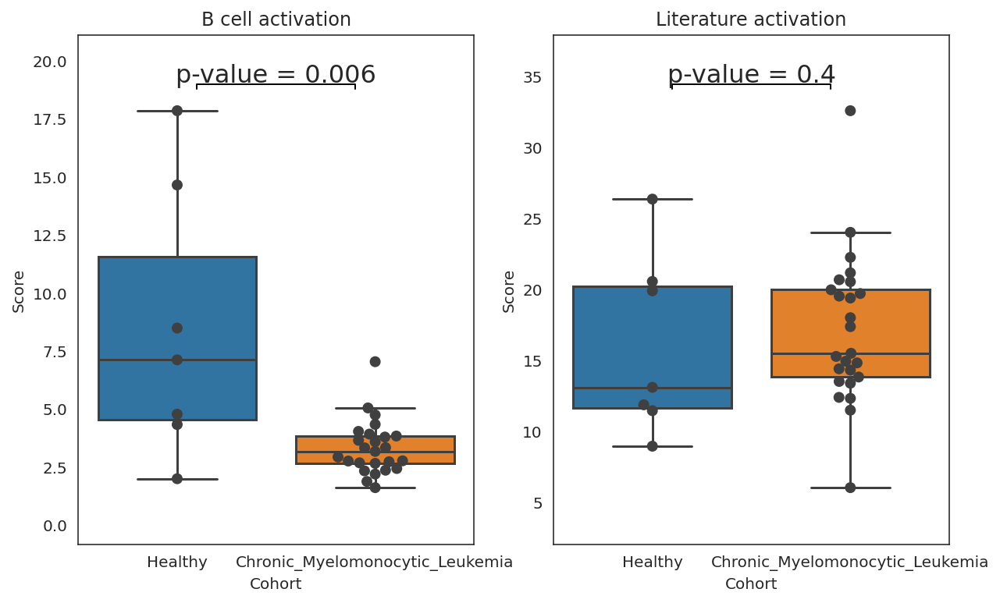

In [195]:
signature_analysis( data2 = expr_TPM[dict_illness['Healthy']],
                   data1 = expr_TPM[dict_illness['Chronic_Myelomonocytic_Leukemia']],
                   label2 = 'Healthy', 
                   label1 = 'Chronic_Myelomonocytic_Leukemia',
                  order = ['Healthy', 'Chronic_Myelomonocytic_Leukemia'])

In [196]:
check = expr_TPM[dict_illness['Chronic_Myelomonocytic_Leukemia']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Chronic_Myelomonocytic_Leukemia']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

TNFRSF13B 1.1879180052254799
FCRL5 0.624483304365075
KLHL14 0.1641170683900813
FCRL1 2.7052768248698595
CD22 4.1260473702994815
FCRLA 1.8327319109102997
FCRL2 1.5800118721517433


In [197]:
expr_counts_GSE102312 = read_expressions(cells_GSE102312, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [198]:
#для всех генов

list_edgeR = []
control = 'Healthy'
interest = 'Chronic_Myelomonocytic_Leukemia'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE102312, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[            logFC    logCPM        PValue           FDR
 RGPD2   -2.748673  2.108694  7.888246e-14  1.582540e-09
 IGHM    -2.556382  8.369530  7.156589e-13  7.178775e-09
 VPREB3  -3.802816  1.562839  1.265260e-12  8.461218e-09
 PAX5    -3.292930  4.018466  1.667965e-11  7.128728e-08
 DAZL    -4.085689 -3.345234  1.776674e-11  7.128728e-08
 ...           ...       ...           ...           ...
 ZCCHC13  0.000000 -4.216055  1.000000e+00  1.000000e+00
 ZCCHC16  0.000000 -4.216055  1.000000e+00  1.000000e+00
 ZNF705B  0.000000 -4.216055  1.000000e+00  1.000000e+00
 ZNRF4    0.000000 -4.216055  1.000000e+00  1.000000e+00
 ZP4      0.000000 -4.216055  1.000000e+00  1.000000e+00
 
 [20062 rows x 4 columns]]

In [199]:
stimulation_expr_edgeR_GSE102312 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE102312.columns = ['GSE102312']
stimulation_expr_edgeR_GSE102312 = stimulation_expr_edgeR_GSE102312.loc[stimulation_expr_edgeR_GSE102312.index.isin(my_genes)]
stimulation_expr_edgeR_GSE102312.head()

,GSE102312
CD22,-2.618007
FCRLA,-2.678073
KLHL14,-3.129638
FCRL2,-2.159874
FCRL5,-2.162301


<AxesSubplot:>

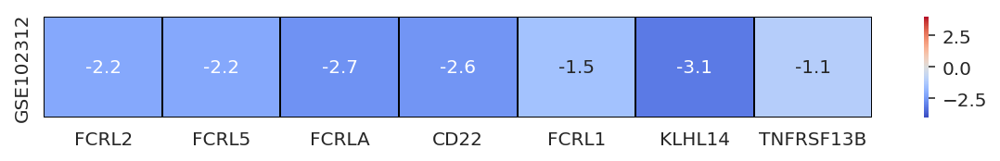

In [200]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE102312.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

# GSE138702 (не работает)

In [201]:
cells_GSE138702 = cells[cells.Dataset == 'GSE138702']
cells_GSE138702

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX6975506,SRR10257573,GSE138702,Bone_Marrow,NaN,Bone_Marrow,Without_treatment,Without_therapy,stored at -80C,Acute_Myeloid_Leukemia,GSM4116446,NaN,NaN,NaN,PAXgene Bone Marrow RNA kit (PreAnalytiX),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",PAXgene Bone Marrow RNA tubes (Qiagen),AML_1,M,74,NaN,31985806,total RNA,PAIRED,60762296.0,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,100675.0,77241.0,96223.0,72432.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX6975507,SRR10257574,GSE138702,Bone_Marrow,NaN,Bone_Marrow,Without_treatment,Without_therapy,stored at -80C,Acute_Myeloid_Leukemia,GSM4116447,NaN,NaN,NaN,PAXgene Bone Marrow RNA kit (PreAnalytiX),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",PAXgene Bone Marrow RNA tubes (Qiagen),AML_2,F,63,NaN,31985806,total RNA,PAIRED,45631071.0,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,100672.0,77238.0,96220.0,72429.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX6975508,SRR10257575,GSE138702,Bone_Marrow,NaN,Bone_Marrow,Without_treatment,Without_therapy,stored at -80C,Acute_Myeloid_Leukemia,GSM4116448,NaN,NaN,NaN,PAXgene Bone Marrow RNA kit (PreAnalytiX),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",PAXgene Bone Marrow RNA tubes (Qiagen),AML_3,F,54,NaN,31985806,total RNA,PAIRED,28872839.0,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,100667.0,77233.0,96215.0,72424.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX6975509,SRR10257576,GSE138702,Bone_Marrow,NaN,Bone_Marrow,Without_treatment,Without_therapy,stored at -80C,Acute_Myeloid_Leukemia,GSM4116449,NaN,NaN,NaN,PAXgene Bone Marrow RNA kit (PreAnalytiX),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",PAXgene Bone Marrow RNA tubes (Qiagen),AML_5,M,71,NaN,31985806,total RNA,PAIRED,38812130.0,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,100666.0,77232.0,96214.0,72423.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX6975510,SRR10257577,GSE138702,Bone_Marrow,NaN,Bone_Marrow,Without_treatment,Without_therapy,stored at -80C,Acute_Myeloid_Leukemia,GSM4116450,NaN,NaN,NaN,PAXgene Bone Marrow RNA kit (PreAnalytiX),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",PAXgene Bone Marrow RNA tubes (Qiagen),AML_6,F,51,NaN,31985806,total RNA,PAIRED,48797486.0,NaN,NaN,NaN,4.375000,NaN,NaN,NaN,100668.0,77234.0,96216.0,72425.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX6975511,SRR10257578,GSE138702,Bone_Marrow,NaN,Bone_Marrow,Without_treatment,Without_therapy,stored at -80C,Acute_Myeloid_Leukemia,GSM4116451,NaN,NaN,NaN,PAXgene Bone Marrow RNA kit (PreAnalytiX),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",PAXgene Bone Marrow RNA tubes (Qiagen),AML_7,F,56,NaN,31985806,total RNA,PAIRED,53506351.0,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,100678.0,77244.0,96226.0,72435.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX6975512,SRR10257579,GSE138702,Bone_Marrow,NaN,Bone_Marrow,Without_treatment,Without_therapy,stored at -80C,Acute_Myeloid_Leukemia,GSM4116452,NaN,NaN,NaN,PAXgene Bone Marrow RNA kit (PreAnalytiX),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)",PAXgene Bone Marrow RNA tubes (Qiagen),AML_8,M,69,NaN,31985806,total RNA,PAIRED,52684704.0,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,100669.0,77235.0,96217.0,72426.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX6975513,SRR10257580,GSE138702,Bone_Marrow

In [202]:
cells_GSE138702.Extended_tissue_type.value_counts()

Series([], Name: Extended_tissue_type, dtype: int64)

In [203]:
cells_GSE138702.Stimulation.value_counts()

Without_treatment    19
Name: Stimulation, dtype: int64

In [204]:
cells_GSE138702.Therapy.value_counts()

Without_therapy    19
Name: Therapy, dtype: int64

In [205]:
cells_GSE138702.Diagnosis.value_counts()

Healthy                   10
Acute_Myeloid_Leukemia    9 
Name: Diagnosis, dtype: int64

In [206]:
cells_GSE138702.Material_type.value_counts()

total RNA    19
Name: Material_type, dtype: int64

In [207]:
expr_TPM = read_expressions(cells_GSE138702, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [208]:
all_deconv_GSE138702 = model.predict(expr_TPM[cells_GSE138702.index])
all_deconv_GSE138702.head()

Expressions OK


,SRX6975506,SRX6975507,SRX6975508,SRX6975509,SRX6975510,SRX6975511,SRX6975512,SRX6975513,SRX6975514,SRX6975515,SRX6975516,SRX6975517,SRX6975518,SRX6975519,SRX6975520,SRX6975521,SRX6975522,SRX6975523,SRX6975524
Other,0.132715,0.173546,0.284167,0.135650,0.172136,0.265713,0.191766,0.114821,0.211664,0.098076,0.113280,0.127655,0.136092,0.150884,0.139768,0.131099,0.099607,0.032936,0.142453
Basophils,0.011771,0.003636,0.003271,0.004885,0.106836,0.013879,0.006047,0.040740,0.050184,0.008776,0.007971,0.011915,0.008281,0.004442,0.008085,0.005184,0.008560,0.017171,0.007677
CD27neg_Memory_B_cells,0.000470,0.000000,0.000002,0.000007,0.000294,0.000003,0.000113,0.000024,0.000008,0.000259,0.000121,0.000194,0.000118,0.000028,0.000197,0.000094,0.000153,0.000341,0.000043
CD57neg_Cytotoxic_NK_cells,0.012901,0.017123,0.030706,0.008845,0.008880,0.044260,0.029609,0.009242,0.000341,0.025530,0.007020,0.009336,0.004214,0.006065,0.005454,0.003407,0.009959,0.014200,0.008611
CD57pos_Cytotoxic_NK_cells,0.005211,0.016349,0.020039,0.004158,0.008459,0.010929,0.020755,0.009538,0.000557,0.019294,0.008163,0.011066,0.004966,0.005499,0.004562,0.005136,0.007485,0.008026,0.004770


In [209]:
all_deconv_GSE138702['Mediana'] = 'nan'

for cell in all_deconv_GSE138702.index:
    counter = []
    for ind in cells_GSE138702.index:
        counter.append(all_deconv_GSE138702[ind][cell])
    all_deconv_GSE138702['Mediana'][cell] = my_median(counter)  

all_deconv_GSE138702.head()

,SRX6975506,SRX6975507,SRX6975508,SRX6975509,SRX6975510,SRX6975511,SRX6975512,SRX6975513,SRX6975514,SRX6975515,SRX6975516,SRX6975517,SRX6975518,SRX6975519,SRX6975520,SRX6975521,SRX6975522,SRX6975523,SRX6975524,Mediana
Other,0.132715,0.173546,0.284167,0.135650,0.172136,0.265713,0.191766,0.114821,0.211664,0.098076,0.113280,0.127655,0.136092,0.150884,0.139768,0.131099,0.099607,0.032936,0.142453,0.136092
Basophils,0.011771,0.003636,0.003271,0.004885,0.106836,0.013879,0.006047,0.040740,0.050184,0.008776,0.007971,0.011915,0.008281,0.004442,0.008085,0.005184,0.008560,0.017171,0.007677,0.00828055
CD27neg_Memory_B_cells,0.000470,0.000000,0.000002,0.000007,0.000294,0.000003,0.000113,0.000024,0.000008,0.000259,0.000121,0.000194,0.000118,0.000028,0.000197,0.000094,0.000153,0.000341,0.000043,0.000112741
CD57neg_Cytotoxic_NK_cells,0.012901,0.017123,0.030706,0.008845,0.008880,0.044260,0.029609,0.009242,0.000341,0.025530,0.007020,0.009336,0.004214,0.006065,0.005454,0.003407,0.009959,0.014200,0.008611,0.00924234
CD57pos_Cytotoxic_NK_cells,0.005211,0.016349,0.020039,0.004158,0.008459,0.010929,0.020755,0.009538,0.000557,0.019294,0.008163,0.011066,0.004966,0.005499,0.004562,0.005136,0.007485,0.008026,0.004770,0.00802586


In [210]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE138702['Mediana'].index, y=all_deconv_GSE138702['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE138702)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [211]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE138702.Diagnosis.unique():
    dict_illness[illness] = cells_GSE138702[cells_GSE138702.Diagnosis == illness].index

dict_illness

{'Acute_Myeloid_Leukemia': Index(['SRX6975506', 'SRX6975507', 'SRX6975508', 'SRX6975509', 'SRX6975510',
        'SRX6975511', 'SRX6975512', 'SRX6975513', 'SRX6975514'],
       dtype='object', name='Sample'),
 'Healthy': Index(['SRX6975515', 'SRX6975516', 'SRX6975517', 'SRX6975518', 'SRX6975519',
        'SRX6975520', 'SRX6975521', 'SRX6975522', 'SRX6975523', 'SRX6975524'],
       dtype='object', name='Sample')}

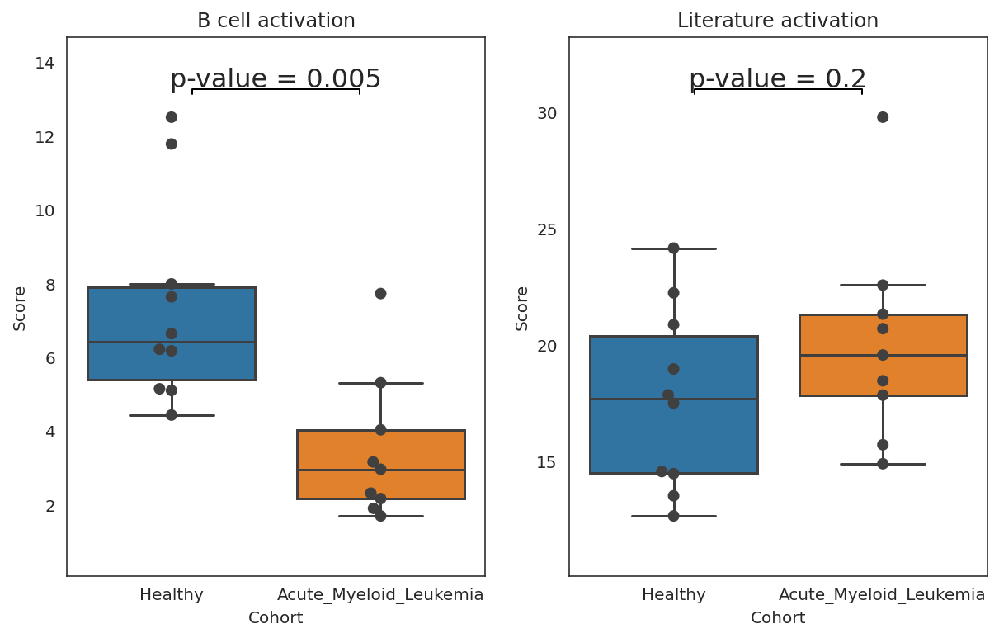

In [212]:
signature_analysis( data2 = expr_TPM[dict_illness['Healthy']],
                   data1 = expr_TPM[dict_illness['Acute_Myeloid_Leukemia']],
                   label2 = 'Healthy', 
                   label1 = 'Acute_Myeloid_Leukemia',
                  order = ['Healthy', 'Acute_Myeloid_Leukemia'])

In [213]:
check = expr_TPM[dict_illness['Acute_Myeloid_Leukemia']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Acute_Myeloid_Leukemia']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

TNFRSF13B 0.19305689174244495
FCRL5 0.9519487591941717
KLHL14 0.43623243874779555
FCRL1 2.274488263688152
CD22 1.2213725596657163
FCRLA 1.9557513458213458
FCRL2 0.6772276711682187


In [214]:
expr_counts_GSE138702 = read_expressions(cells_GSE138702, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [215]:
#для всех генов

list_edgeR = []
control = 'Healthy'
interest = 'Acute_Myeloid_Leukemia'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE138702, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[            logFC    logCPM        PValue           FDR
 SLC6A19  6.807971  4.565568  1.012063e-16  2.030400e-12
 MYCN     4.250374  2.632736  1.263863e-14  1.267781e-10
 TMEM158  4.735310  3.290374  1.910746e-14  1.277779e-10
 FAM83A   4.354903  3.840326  3.857427e-13  1.934692e-09
 NRIP3    2.021230  3.359862  8.362555e-13  3.355391e-09
 ...           ...       ...           ...           ...
 UGT1A10  0.000000 -4.606828  1.000000e+00  1.000000e+00
 UGT1A4   0.000000 -4.606828  1.000000e+00  1.000000e+00
 UGT2B4   0.000000 -4.606828  1.000000e+00  1.000000e+00
 XAGE5    0.000000 -4.606828  1.000000e+00  1.000000e+00
 ZACN     0.000000 -4.606828  1.000000e+00  1.000000e+00
 
 [20062 rows x 4 columns]]

In [216]:
stimulation_expr_edgeR_GSE138702 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE138702.columns = ['GSE138702']
stimulation_expr_edgeR_GSE138702 = stimulation_expr_edgeR_GSE138702.loc[stimulation_expr_edgeR_GSE138702.index.isin(my_genes)]
stimulation_expr_edgeR_GSE138702.head()

,GSE138702
TNFRSF13B,-2.668790
FCRL2,-1.955898
FCRL1,-1.789626
KLHL14,-1.637377
CD22,-1.373464


<AxesSubplot:>

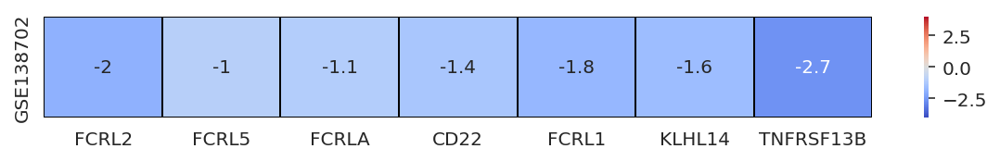

In [217]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE138702.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

# GSE162894

In [218]:
cells_GSE162894 = cells[cells.Dataset == 'GSE162894']
cells_GSE162894

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX9653787,SRR13221300,GSE162894,Bone_Marrow,NaN,Bone,Without_stimulation,No_data,No_data,T_Cell_Lymphoblastic_Leukemia_Lymphoma,GSM4964807,NaN,NaN,NaN,AllPrep DNA/RNA Micro Kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)/Ovation® RNA-Seq System V2 (NuGEN)",NaN,Sample 001,No_data,Adult,NaN,33593877,NaN,PAIRED,64333068.0,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,145323.0,121414.0,132582.0,108345.0,NaN,NaN,Before_therapy,Chemotherapy,NaN,NaN,Relapsed/refractory,NaN,NaN,NaN,NaN,NaN,NaN
SRX9653791,SRR13221304,GSE162894,Bone_Marrow,NaN,Bone,Without_stimulation,No_data,No_data,B_Cell_Lymphoblastic_Leukemia_Lymphoma,GSM4964811,NaN,NaN,NaN,AllPrep DNA/RNA Micro Kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)/Ovation® RNA-Seq System V2 (NuGEN)",NaN,Sample 005,No_data,Adult,NaN,33593877,NaN,PAIRED,32289750.0,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,145317.0,121408.0,132576.0,108339.0,NaN,NaN,Before_therapy,Chemotherapy,NaN,NaN,Relapsed/refractory,NaN,NaN,NaN,NaN,NaN,NaN
SRX9653792,SRR13221305,GSE162894,Bone_Marrow,NaN,Bone,Without_stimulation,No_data,No_data,T_Cell_Lymphoblastic_Leukemia_Lymphoma,GSM4964812,NaN,NaN,NaN,AllPrep DNA/RNA Micro Kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)/Ovation® RNA-Seq System V2 (NuGEN)",NaN,Sample 006,No_data,Adult,NaN,33593877,NaN,PAIRED,38744572.0,NaN,NaN,NaN,5.541667,NaN,NaN,NaN,145329.0,121420.0,132588.0,108351.0,NaN,NaN,Before_therapy,Chemotherapy,NaN,NaN,Relapsed/refractory,NaN,NaN,NaN,NaN,NaN,NaN
SRX9653793,SRR13221306,GSE162894,Bone_Marrow,NaN,Bone,Without_stimulation,No_data,No_data,B_Cell_Lymphoblastic_Leukemia_Lymphoma,GSM4964813,NaN,NaN,NaN,AllPrep DNA/RNA Micro Kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)/Ovation® RNA-Seq System V2 (NuGEN)",NaN,Sample 007,No_data,Adult,NaN,33593877,NaN,PAIRED,30988099.0,NaN,NaN,NaN,6.708333,NaN,NaN,NaN,145342.0,121433.0,132601.0,108364.0,NaN,NaN,Before_therapy,Chemotherapy,NaN,NaN,Relapsed/refractory,NaN,NaN,NaN,NaN,NaN,NaN
SRX9653799,SRR13221312,GSE162894,Bone_Marrow,NaN,Bone,Without_stimulation,No_data,No_data,T_Cell_Lymphoblastic_Leukemia_Lymphoma,GSM4964819,NaN,NaN,NaN,AllPrep DNA/RNA Micro Kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)/Ovation® RNA-Seq System V2 (NuGEN)",NaN,Sample 013,No_data,Adult,NaN,33593877,NaN,PAIRED,24892317.0,NaN,NaN,NaN,6.708333,NaN,NaN,NaN,145333.0,121424.0,132592.0,108355.0,NaN,NaN,Before_therapy,Chemotherapy,NaN,NaN,Relapsed/refractory,NaN,NaN,NaN,NaN,NaN,NaN
SRX9653802,SRR13221316,GSE162894,Bone_Marrow,NaN,Bone,Without_stimulation,No_data,No_data,T_Cell_Lymphoblastic_Leukemia_Lymphoma,GSM4964822,NaN,NaN,NaN,AllPrep DNA/RNA Micro Kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)/Ovation® RNA-Seq System V2 (NuGEN)",NaN,Sample 016,No_data,Adult,NaN,33593877,NaN,PAIRED,44333379.0,NaN,NaN,NaN,4.666667,NaN,NaN,NaN,145351.0,121442.0,132610.0,108373.0,NaN,NaN,Before_therapy,Chemotherapy,NaN,NaN,Relapsed/refractory,NaN,NaN,NaN,NaN,NaN,NaN
SRX9653807,SRR13221327,GSE162894,Bone_Marrow,NaN,Bone,Without_stimulation,No_data,No_data,B_Cell_Lymphoblastic_Leukemia_Lymphoma,GSM4964827,NaN,NaN,NaN,AllPrep DNA/RNA Micro Kit (Qiagen),"TruSeq Stranded Total RNA Library kit (Illumina, San Diego, CA, USA)/Ovation® RNA-Seq System V2 (NuGEN)",NaN,Sample 02

In [219]:
cells_GSE162894.Extended_tissue_type.value_counts()

Series([], Name: Extended_tissue_type, dtype: int64)

In [220]:
cells_GSE162894.Stimulation.value_counts()

Without_stimulation    17
Name: Stimulation, dtype: int64

In [221]:
cells_GSE162894.Therapy.value_counts()

No_data    17
Name: Therapy, dtype: int64

In [222]:
cells_GSE162894.Diagnosis.value_counts()

B_Cell_Lymphoblastic_Leukemia_Lymphoma    9
T_Cell_Lymphoblastic_Leukemia_Lymphoma    6
Acute_Lymphoblastic_Leukemia              2
Name: Diagnosis, dtype: int64

In [223]:
cells_GSE162894.Material_type.value_counts()

Series([], Name: Material_type, dtype: int64)

In [234]:
expr_TPM = read_expressions(cells_GSE162894, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [225]:
all_deconv_GSE162894 = model.predict(expr_TPM[cells_GSE162894.index])
all_deconv_GSE162894.head()

Expressions OK


,SRX9653787,SRX9653791,SRX9653792,SRX9653793,SRX9653799,SRX9653802,SRX9653807,SRX9653809,SRX9653810,SRX9653811,SRX9653813,SRX9653818,SRX9653819,SRX9653823,SRX9653824,SRX9653825,SRX9653828
Other,0.120253,0.244609,0.062618,0.185701,0.128306,0.086701,0.273096,0.112098,0.077775,0.226590,0.166877,0.051768,0.299095,0.242792,0.082579,0.296610,0.121284
Basophils,0.003807,0.000000,0.000310,0.000000,0.061711,0.005117,0.007359,0.066760,0.003426,0.008697,0.000000,0.000000,0.004130,0.011495,0.000000,0.005349,0.000000
CD27neg_Memory_B_cells,0.000021,0.001428,0.000011,0.001158,0.000912,0.000010,0.000000,0.000794,0.000019,0.000000,0.000999,0.004517,0.001894,0.000616,0.000000,0.000578,0.001084
CD57neg_Cytotoxic_NK_cells,0.003281,0.000000,0.074630,0.002602,0.006591,0.022485,0.003850,0.015500,0.024790,0.001820,0.000928,0.000227,0.005206,0.042458,0.001645,0.020528,0.001115
CD57pos_Cytotoxic_NK_cells,0.001316,0.000000,0.076983,0.000638,0.001855,0.033134,0.000906,0.001640,0.002891,0.001522,0.000650,0.000109,0.004662,0.097603,0.000904,0.013684,0.001041


In [226]:
all_deconv_GSE162894['Mediana'] = 'nan'

for cell in all_deconv_GSE162894.index:
    counter = []
    for ind in cells_GSE162894.index:
        counter.append(all_deconv_GSE162894[ind][cell])
    all_deconv_GSE162894['Mediana'][cell] = my_median(counter)  

all_deconv_GSE162894.head()

,SRX9653787,SRX9653791,SRX9653792,SRX9653793,SRX9653799,SRX9653802,SRX9653807,SRX9653809,SRX9653810,SRX9653811,SRX9653813,SRX9653818,SRX9653819,SRX9653823,SRX9653824,SRX9653825,SRX9653828,Mediana
Other,0.120253,0.244609,0.062618,0.185701,0.128306,0.086701,0.273096,0.112098,0.077775,0.226590,0.166877,0.051768,0.299095,0.242792,0.082579,0.296610,0.121284,0.128306
Basophils,0.003807,0.000000,0.000310,0.000000,0.061711,0.005117,0.007359,0.066760,0.003426,0.008697,0.000000,0.000000,0.004130,0.011495,0.000000,0.005349,0.000000,0.00380721
CD27neg_Memory_B_cells,0.000021,0.001428,0.000011,0.001158,0.000912,0.000010,0.000000,0.000794,0.000019,0.000000,0.000999,0.004517,0.001894,0.000616,0.000000,0.000578,0.001084,0.000615829
CD57neg_Cytotoxic_NK_cells,0.003281,0.000000,0.074630,0.002602,0.006591,0.022485,0.003850,0.015500,0.024790,0.001820,0.000928,0.000227,0.005206,0.042458,0.001645,0.020528,0.001115,0.0038499
CD57pos_Cytotoxic_NK_cells,0.001316,0.000000,0.076983,0.000638,0.001855,0.033134,0.000906,0.001640,0.002891,0.001522,0.000650,0.000109,0.004662,0.097603,0.000904,0.013684,0.001041,0.00152227


In [227]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE162894['Mediana'].index, y=all_deconv_GSE162894['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE162894)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [235]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE162894.Diagnosis.unique():
    dict_illness[illness] = cells_GSE162894[cells_GSE162894.Diagnosis == illness].index

dict_illness

{'T_Cell_Lymphoblastic_Leukemia_Lymphoma': Index(['SRX9653787', 'SRX9653792', 'SRX9653799', 'SRX9653802', 'SRX9653809',
        'SRX9653810'],
       dtype='object', name='Sample'),
 'B_Cell_Lymphoblastic_Leukemia_Lymphoma': Index(['SRX9653791', 'SRX9653793', 'SRX9653807', 'SRX9653818', 'SRX9653819',
        'SRX9653823', 'SRX9653824', 'SRX9653825', 'SRX9653828'],
       dtype='object', name='Sample'),
 'Acute_Lymphoblastic_Leukemia': Index(['SRX9653811', 'SRX9653813'], dtype='object', name='Sample')}

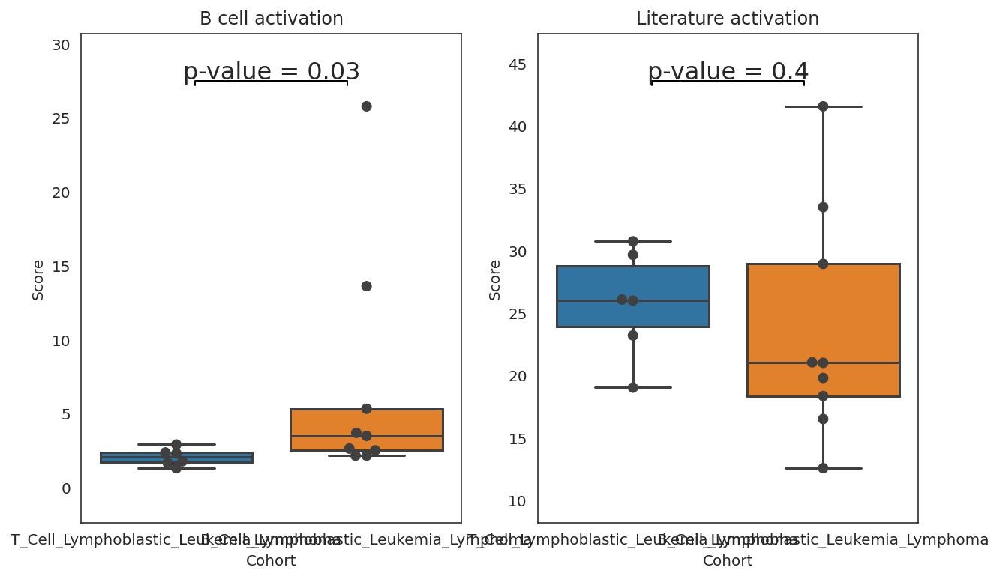

In [243]:
signature_analysis( data2 = expr_TPM[dict_illness['T_Cell_Lymphoblastic_Leukemia_Lymphoma']],
                   data1 = expr_TPM[dict_illness['B_Cell_Lymphoblastic_Leukemia_Lymphoma']],
                   label2 = 'T_Cell_Lymphoblastic_Leukemia_Lymphoma', 
                   label1 = 'B_Cell_Lymphoblastic_Leukemia_Lymphoma',
                  order = ['T_Cell_Lymphoblastic_Leukemia_Lymphoma', 'B_Cell_Lymphoblastic_Leukemia_Lymphoma'])

In [238]:
check = expr_TPM[dict_illness['B_Cell_Lymphoblastic_Leukemia_Lymphoma']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['B_Cell_Lymphoblastic_Leukemia_Lymphoma']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

TNFRSF13B 0.09902677449493076
FCRL5 0.18475722855406293
KLHL14 0.2811688162373305
FCRL1 0.29673238471430946
CD22 58.09907779962979
FCRLA 0.7094806799719203
FCRL2 0.18757323907465226


In [239]:
expr_counts_GSE162894 = read_expressions(cells_GSE162894, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [240]:
#для всех генов

list_edgeR = []
control = 'T_Cell_Lymphoblastic_Leukemia_Lymphoma'
interest = 'B_Cell_Lymphoblastic_Leukemia_Lymphoma'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE162894, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[                logFC    logCPM        PValue           FDR
 TCL1A    1.105307e+01  8.063407  4.634438e-22  9.297610e-18
 FAM69C   1.007985e+01  4.835043  2.495496e-12  2.503232e-08
 LRP6     5.329683e+00  3.881288  1.995571e-10  1.027903e-06
 NAV1     5.292495e+00  7.083036  2.340814e-10  1.027903e-06
 SH2D4B   5.843309e+00  3.156165  2.561817e-10  1.027903e-06
 ...               ...       ...           ...           ...
 WNT2    -5.125482e-15 -3.729852  1.000000e+00  1.000000e+00
 ZCCHC13 -5.125482e-15 -3.729852  1.000000e+00  1.000000e+00
 ZNF645  -5.125482e-15 -3.729852  1.000000e+00  1.000000e+00
 ZNF705B -5.125482e-15 -3.729852  1.000000e+00  1.000000e+00
 ZP4     -5.125482e-15 -3.729852  1.000000e+00  1.000000e+00
 
 [20062 rows x 4 columns]]

In [244]:
stimulation_expr_edgeR_GSE162894 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE162894.columns = ['GSE162894']
stimulation_expr_edgeR_GSE162894 = stimulation_expr_edgeR_GSE162894.loc[stimulation_expr_edgeR_GSE162894.index.isin(my_genes)]
stimulation_expr_edgeR_GSE162894.head()

,GSE162894
CD22,4.033371
KLHL14,6.351237
TNFRSF13B,7.721974
FCRL5,4.708730
FCRL1,4.535052


<AxesSubplot:>

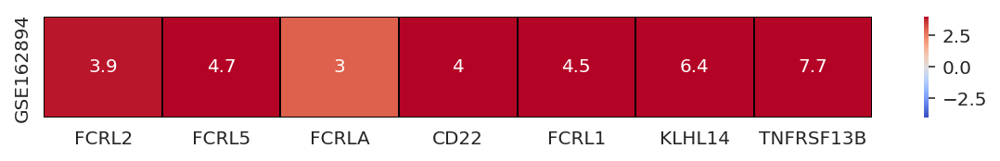

In [320]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE162894.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

# GSE123496

In [23]:
cells_GSE123496 = cells[cells.Dataset == 'GSE123496']
cells_GSE123496

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX5122430,SRR8307929,GSE123496,corpus callosum,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505486,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 1,F,57.6,NaN,31040210,polyA RNA,SINGLE,2.129099e+07,NaN,NaN,NaN,5.250000,NaN,NaN,NaN,59904.0,43462.0,58591.0,42239.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122431,SRR8307930,GSE123496,frontal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505487,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 1,F,57.6,NaN,31040210,polyA RNA,SINGLE,2.180984e+07,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,59906.0,43464.0,58593.0,42241.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122432,SRR8307931,GSE123496,parietal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505488,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 1,F,57.6,NaN,31040210,polyA RNA,SINGLE,1.343077e+07,NaN,NaN,NaN,4.375000,NaN,NaN,NaN,59901.0,43459.0,58588.0,42236.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122433,SRR8307932,GSE123496,hippocampus,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505489,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 1,F,57.6,NaN,31040210,polyA RNA,SINGLE,2.557579e+07,NaN,NaN,NaN,4.375000,NaN,NaN,NaN,59893.0,43451.0,58580.0,42228.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122434,SRR8307933,GSE123496,internal capsule,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505490,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 1,F,57.6,NaN,31040210,polyA RNA,SINGLE,2.099622e+07,NaN,NaN,NaN,4.375000,NaN,NaN,NaN,59886.0,43444.0,58573.0,42221.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122435,SRR8307934,GSE123496,corpus callosum,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505491,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 2,F,57.6,NaN,31040210,polyA RNA,SINGLE,2.553450e+07,NaN,NaN,NaN,5.250000,NaN,NaN,NaN,59923.0,43481.0,58610.0,42258.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122436,SRR8307935,GSE123496,frontal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505492,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 2,F,57.6,NaN,31040210,polyA RNA,SINGLE,1.101183e+07,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,59933.0,43491.0,58620.0,42268.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122437,SRR8307936,GSE123496,parietal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505493,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 2,F,57.6,NaN,31040210,polyA RNA,SINGLE,1.202522e+07,NaN,NaN,NaN,4.375000,NaN,NaN,NaN,59905.0,43463.0,58592.0,42240.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122438,SRR8307937,GSE123496,hippocampus,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM

In [24]:
cells_GSE123496.Extended_tissue_type.value_counts()

Series([], Name: Extended_tissue_type, dtype: int64)

In [25]:
cells_GSE123496.Stimulation.value_counts()

Without_treatment    49
Name: Stimulation, dtype: int64

In [26]:
cells_GSE123496.Therapy.value_counts()

Without_therapy    49
Name: Therapy, dtype: int64

In [27]:
cells_GSE123496.Diagnosis.value_counts()

Multiple_sclerosis    25
Healthy               24
Name: Diagnosis, dtype: int64

In [28]:
cells_GSE123496.Material_type.value_counts()

polyA RNA    49
Name: Material_type, dtype: int64

In [29]:
expr_TPM = read_expressions(cells_GSE123496, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [30]:
all_deconv_GSE123496 = model.predict(expr_TPM[cells_GSE123496.index])
all_deconv_GSE123496.head()

Expressions OK


,SRX5122430,SRX5122431,SRX5122432,SRX5122433,SRX5122434,SRX5122435,SRX5122436,SRX5122437,SRX5122438,SRX5122439,SRX5122440,SRX5122441,SRX5122442,SRX5122443,SRX5122444,SRX5122445,SRX5122446,SRX5122447,SRX5122448,SRX5122449,SRX5122450,SRX5122451,SRX5122452,SRX5122453,SRX5122454,SRX5122455,SRX5122457,SRX5122458,SRX5122459,SRX5122460,SRX5122461,SRX5122462,SRX5122463,SRX5122464,SRX5122465,SRX5122466,SRX5122467,SRX5122468,SRX5122469,SRX5122470,SRX5122471,SRX5122472,SRX5122473,SRX5122474,SRX5122475,SRX5122476,SRX5122477,SRX5122478,SRX5122479
Other,0.829758,0.851035,0.887317,0.890352,0.897450,0.888618,0.866926,0.879317,0.889821,0.935533,0.823143,0.848567,0.812691,0.788423,0.739853,0.635549,0.760939,0.777598,0.604757,0.573948,0.772798,0.809663,0.804355,0.823416,0.848244,0.751887,0.825652,0.723571,0.716999,0.895099,0.865541,0.853393,0.881525,0.858930,0.863499,0.854396,0.850850,0.854381,0.855236,0.894981,0.878094,0.868115,0.885579,0.949799,0.869022,0.844465,0.848293,0.850114,0.880137
Basophils,0.000123,0.000155,0.000044,0.000130,0.000117,0.000241,0.000089,0.000268,0.000113,0.000000,0.000302,0.000040,0.000226,0.000505,0.000343,0.000911,0.000513,0.000393,0.004519,0.001096,0.000405,0.000407,0.000337,0.000308,0.000037,0.000492,0.000870,0.000786,0.001078,0.000143,0.000126,0.000106,0.000181,0.000113,0.000311,0.000000,0.000000,0.001087,0.000000,0.000092,0.000260,0.001055,0.000362,0.000000,0.000226,0.000000,0.000000,0.000000,0.000000
CD27neg_Memory_B_cells,0.000230,0.000064,0.000041,0.000032,0.000028,0.000120,0.000172,0.000104,0.000167,0.000082,0.000213,0.000095,0.000132,0.000065,0.000371,0.000198,0.000087,0.000071,0.000123,0.000063,0.000337,0.000468,0.000203,0.000156,0.000331,0.001071,0.000137,0.000338,0.000176,0.000088,0.000060,0.000127,0.000016,0.000053,0.000147,0.000093,0.000122,0.000035,0.000078,0.000043,0.000067,0.000057,0.000117,0.000161,0.000072,0.000054,0.000076,0.000032,0.000092
CD57neg_Cytotoxic_NK_cells,0.017542,0.014477,0.013125,0.009396,0.008880,0.006573,0.011435,0.006577,0.007210,0.007780,0.004252,0.013500,0.013973,0.011052,0.006753,0.005620,0.015114,0.018020,0.013061,0.002684,0.007694,0.010533,0.011770,0.008984,0.005608,0.010827,0.003512,0.015630,0.012238,0.006251,0.016216,0.021580,0.010870,0.013283,0.009414,0.013858,0.017026,0.015852,0.013069,0.004207,0.010463,0.006345,0.006457,0.001398,0.009249,0.017672,0.013945,0.018814,0.014568
CD57pos_Cytotoxic_NK_cells,0.013212,0.008854,0.010896,0.006731,0.005722,0.004469,0.007222,0.005086,0.005584,0.004808,0.002369,0.008345,0.010344,0.006549,0.004655,0.003676,0.010845,0.016127,0.010760,0.002210,0.004962,0.010211,0.011622,0.007912,0.004587,0.013147,0.003378,0.014531,0.009442,0.002926,0.013072,0.016393,0.006801,0.011017,0.005600,0.014185,0.018261,0.014163,0.011853,0.002716,0.009854,0.007356,0.005349,0.001479,0.004430,0.011952,0.012416,0.011936,0.006396


In [31]:
all_deconv_GSE123496['Mediana'] = 'nan'

for cell in all_deconv_GSE123496.index:
    counter = []
    for ind in cells_GSE123496.index:
        counter.append(all_deconv_GSE123496[ind][cell])
    all_deconv_GSE123496['Mediana'][cell] = my_median(counter)  

all_deconv_GSE123496.head()

,SRX5122430,SRX5122431,SRX5122432,SRX5122433,SRX5122434,SRX5122435,SRX5122436,SRX5122437,SRX5122438,SRX5122439,SRX5122440,SRX5122441,SRX5122442,SRX5122443,SRX5122444,SRX5122445,SRX5122446,SRX5122447,SRX5122448,SRX5122449,SRX5122450,SRX5122451,SRX5122452,SRX5122453,SRX5122454,SRX5122455,SRX5122457,SRX5122458,SRX5122459,SRX5122460,SRX5122461,SRX5122462,SRX5122463,SRX5122464,SRX5122465,SRX5122466,SRX5122467,SRX5122468,SRX5122469,SRX5122470,SRX5122471,SRX5122472,SRX5122473,SRX5122474,SRX5122475,SRX5122476,SRX5122477,SRX5122478,SRX5122479,Mediana
Other,0.829758,0.851035,0.887317,0.890352,0.897450,0.888618,0.866926,0.879317,0.889821,0.935533,0.823143,0.848567,0.812691,0.788423,0.739853,0.635549,0.760939,0.777598,0.604757,0.573948,0.772798,0.809663,0.804355,0.823416,0.848244,0.751887,0.825652,0.723571,0.716999,0.895099,0.865541,0.853393,0.881525,0.858930,0.863499,0.854396,0.850850,0.854381,0.855236,0.894981,0.878094,0.868115,0.885579,0.949799,0.869022,0.844465,0.848293,0.850114,0.880137,0.851035
Basophils,0.000123,0.000155,0.000044,0.000130,0.000117,0.000241,0.000089,0.000268,0.000113,0.000000,0.000302,0.000040,0.000226,0.000505,0.000343,0.000911,0.000513,0.000393,0.004519,0.001096,0.000405,0.000407,0.000337,0.000308,0.000037,0.000492,0.000870,0.000786,0.001078,0.000143,0.000126,0.000106,0.000181,0.000113,0.000311,0.000000,0.000000,0.001087,0.000000,0.000092,0.000260,0.001055,0.000362,0.000000,0.000226,0.000000,0.000000,0.000000,0.000000,0.000225665
CD27neg_Memory_B_cells,0.000230,0.000064,0.000041,0.000032,0.000028,0.000120,0.000172,0.000104,0.000167,0.000082,0.000213,0.000095,0.000132,0.000065,0.000371,0.000198,0.000087,0.000071,0.000123,0.000063,0.000337,0.000468,0.000203,0.000156,0.000331,0.001071,0.000137,0.000338,0.000176,0.000088,0.000060,0.000127,0.000016,0.000053,0.000147,0.000093,0.000122,0.000035,0.000078,0.000043,0.000067,0.000057,0.000117,0.000161,0.000072,0.000054,0.000076,0.000032,0.000092,9.51056e-05
CD57neg_Cytotoxic_NK_cells,0.017542,0.014477,0.013125,0.009396,0.008880,0.006573,0.011435,0.006577,0.007210,0.007780,0.004252,0.013500,0.013973,0.011052,0.006753,0.005620,0.015114,0.018020,0.013061,0.002684,0.007694,0.010533,0.011770,0.008984,0.005608,0.010827,0.003512,0.015630,0.012238,0.006251,0.016216,0.021580,0.010870,0.013283,0.009414,0.013858,0.017026,0.015852,0.013069,0.004207,0.010463,0.006345,0.006457,0.001398,0.009249,0.017672,0.013945,0.018814,0.014568,0.0108701
CD57pos_Cytotoxic_NK_cells,0.013212,0.008854,0.010896,0.006731,0.005722,0.004469,0.007222,0.005086,0.005584,0.004808,0.002369,0.008345,0.010344,0.006549,0.004655,0.003676,0.010845,0.016127,0.010760,0.002210,0.004962,0.010211,0.011622,0.007912,0.004587,0.013147,0.003378,0.014531,0.009442,0.002926,0.013072,0.016393,0.006801,0.011017,0.005600,0.014185,0.018261,0.014163,0.011853,0.002716,0.009854,0.007356,0.005349,0.001479,0.004430,0.011952,0.012416,0.011936,0.006396,0.00791237


In [32]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE123496['Mediana'].index, y=all_deconv_GSE123496['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE123496)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [33]:
cells_GSE123496.Tissue_name.value_counts()

internal capsule    10
parietal cortex     10
hippocampus         10
corpus callosum     10
frontal cortex      9 
Name: Tissue_name, dtype: int64

## hippocampus

In [34]:
cells_GSE123496_1 = cells_GSE123496.loc[cells_GSE123496.Tissue_name == 'hippocampus']
cells_GSE123496_1

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX5122433,SRR8307932,GSE123496,hippocampus,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505489,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 1,F,57.6,NaN,31040210,polyA RNA,SINGLE,25575789.00,NaN,NaN,NaN,4.375000,NaN,NaN,NaN,59893.0,43451.0,58580.0,42228.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122438,SRR8307937,GSE123496,hippocampus,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505494,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 2,F,57.6,NaN,31040210,polyA RNA,SINGLE,10031259.26,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,59907.0,43465.0,58594.0,42242.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122443,SRR8307942,GSE123496,hippocampus,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505499,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 3,F,57.6,NaN,31040210,polyA RNA,SINGLE,26220578.73,NaN,NaN,NaN,5.250000,NaN,NaN,NaN,59916.0,43474.0,58603.0,42251.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122448,SRR8307947,GSE123496,hippocampus,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505504,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 4,F,57.6,NaN,31040210,polyA RNA,SINGLE,34228442.73,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59932.0,43490.0,58619.0,42267.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122453,SRR8307952,GSE123496,hippocampus,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505509,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 5,F,57.6,NaN,31040210,polyA RNA,SINGLE,22265450.26,NaN,NaN,NaN,4.958333,NaN,NaN,NaN,59924.0,43482.0,58611.0,42259.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122458,SRR8307957,GSE123496,hippocampus,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505514,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 6,F,56.2,NaN,31040210,polyA RNA,SINGLE,12241943.29,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,59903.0,43461.0,58590.0,42238.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122463,SRR8307962,GSE123496,hippocampus,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505519,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 7,F,56.2,NaN,31040210,polyA RNA,SINGLE,27335382.41,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59914.0,43472.0,58601.0,42249.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122468,SRR8307967,GSE123496,hippocampus,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505524,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 8,F,56.2,NaN,31040210,polyA RNA,SINGLE,29550577.97,NaN,NaN,NaN,4.958333,NaN,NaN,NaN,59898.0,43456.0,58585.0,42233.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122473,SRR8307972,GSE123496,hippocampus,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505529,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library 

In [35]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE123496_1.Diagnosis.unique():
    dict_illness[illness] = cells_GSE123496_1[cells_GSE123496_1.Diagnosis == illness].index

dict_illness

{'Multiple_sclerosis': Index(['SRX5122433', 'SRX5122438', 'SRX5122443', 'SRX5122448', 'SRX5122453'], dtype='object', name='Sample'),
 'Healthy': Index(['SRX5122458', 'SRX5122463', 'SRX5122468', 'SRX5122473', 'SRX5122478'], dtype='object', name='Sample')}

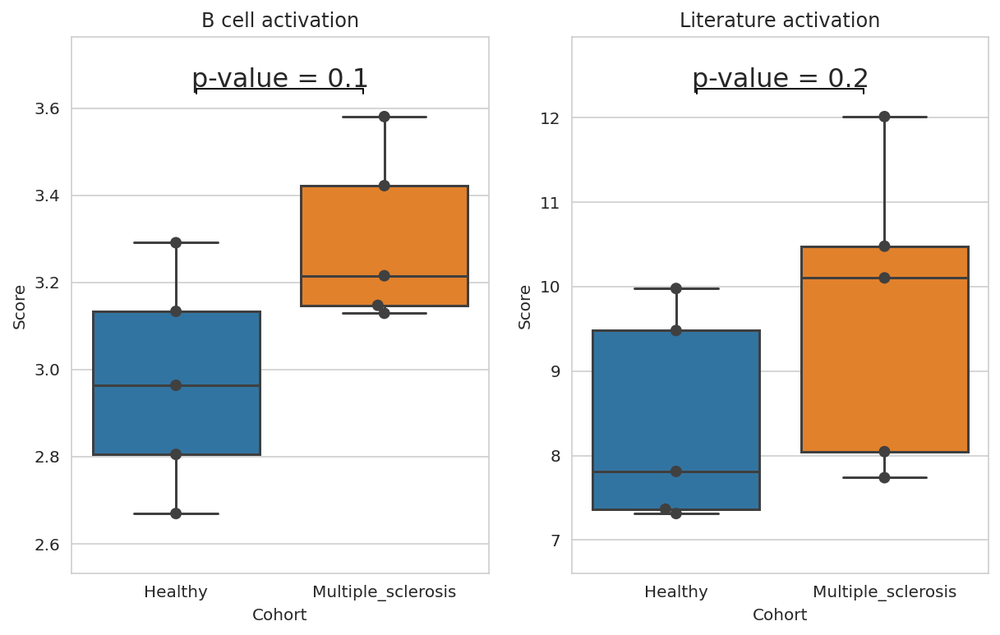

In [36]:
signature_analysis( data2 = expr_TPM[dict_illness['Healthy']],
                   data1 = expr_TPM[dict_illness['Multiple_sclerosis']],
                   label2 = 'Healthy', 
                   label1 = 'Multiple_sclerosis',
                  order = ['Healthy', 'Multiple_sclerosis'])

In [37]:
check = expr_TPM[dict_illness['Multiple_sclerosis']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Multiple_sclerosis']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

FCRL5 0.2021489145409293
KLHL14 0.3577029519333796
FCRL2 0.28675523044140194
FCRL1 0.0
FCRLA 0.28784248171462223
TNFRSF13B 0.43063673946511916
CD22 29.958113518857754


In [38]:
expr_counts_GSE123496_1 = read_expressions(cells_GSE123496_1, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [39]:
#для всех генов

list_edgeR = []
control = 'Healthy'
interest = 'Multiple_sclerosis'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE123496_1, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[                      logFC    logCPM        PValue           FDR
 IGHG1              6.893084  7.488160  5.461194e-18  1.095625e-13
 IGLC3              9.188465  5.115920  2.788757e-15  2.797402e-11
 SERPINA3           3.719163  8.391877  9.313022e-14  6.227928e-10
 IGHG3              6.049791  3.889932  3.288471e-12  1.649332e-08
 IGLC2              5.081719  3.882050  2.436231e-09  9.775132e-06
 ...                     ...       ...           ...           ...
 XAGE5              0.000000 -3.583274  1.000000e+00  1.000000e+00
 XXbac-BPG116M5.17  0.000000 -3.583274  1.000000e+00  1.000000e+00
 ZCCHC13            0.000000 -3.583274  1.000000e+00  1.000000e+00
 ZFY                0.000000 -3.583274  1.000000e+00  1.000000e+00
 ZP4                0.000000 -3.583274  1.000000e+00  1.000000e+00
 
 [20062 rows x 4 columns]]

In [40]:
stimulation_expr_edgeR_GSE123496_1 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE123496_1.columns = ['hippocampus']
stimulation_expr_edgeR_GSE123496_1 = stimulation_expr_edgeR_GSE123496_1.loc[stimulation_expr_edgeR_GSE123496_1.index.isin(my_genes)]
stimulation_expr_edgeR_GSE123496_1.head()

,hippocampus
FCRL5,4.290892
TNFRSF13B,-0.789551
CD22,0.308249
KLHL14,-0.334655
FCRL2,-0.091380


<AxesSubplot:>

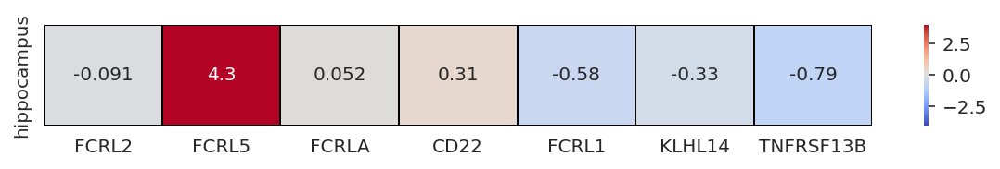

In [41]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE123496_1.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

## parietal cortex

In [42]:
cells_GSE123496_2 = cells_GSE123496.loc[cells_GSE123496.Tissue_name == 'parietal cortex']
cells_GSE123496_2

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX5122432,SRR8307931,GSE123496,parietal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505488,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 1,F,57.6,NaN,31040210,polyA RNA,SINGLE,1.343077e+07,NaN,NaN,NaN,4.375000,NaN,NaN,NaN,59901.0,43459.0,58588.0,42236.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122437,SRR8307936,GSE123496,parietal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505493,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 2,F,57.6,NaN,31040210,polyA RNA,SINGLE,1.202522e+07,NaN,NaN,NaN,4.375000,NaN,NaN,NaN,59905.0,43463.0,58592.0,42240.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122442,SRR8307941,GSE123496,parietal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505498,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 3,F,57.6,NaN,31040210,polyA RNA,SINGLE,3.706672e+07,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59930.0,43488.0,58617.0,42265.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122447,SRR8307946,GSE123496,parietal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505503,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 4,F,57.6,NaN,31040210,polyA RNA,SINGLE,3.472747e+07,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59902.0,43460.0,58589.0,42237.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122452,SRR8307951,GSE123496,parietal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505508,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 5,F,57.6,NaN,31040210,polyA RNA,SINGLE,2.202922e+07,NaN,NaN,NaN,4.958333,NaN,NaN,NaN,59928.0,43486.0,58615.0,42263.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122457,SRR8307956,GSE123496,parietal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505513,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 6,F,56.2,NaN,31040210,polyA RNA,SINGLE,9.781699e+06,NaN,NaN,NaN,4.083333,NaN,NaN,NaN,59912.0,43470.0,58599.0,42247.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122462,SRR8307961,GSE123496,parietal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505518,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 7,F,56.2,NaN,31040210,polyA RNA,SINGLE,3.202480e+07,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59889.0,43447.0,58576.0,42224.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122467,SRR8307966,GSE123496,parietal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505523,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 8,F,56.2,NaN,31040210,polyA RNA,SINGLE,4.346470e+07,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59918.0,43476.0,58605.0,42253.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122472,SRR8307971,GSE123496,parietal cortex,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505528,NaN,NaN,NaN,TRIzol™ Reagent

In [43]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE123496_2.Diagnosis.unique():
    dict_illness[illness] = cells_GSE123496_2[cells_GSE123496_2.Diagnosis == illness].index

dict_illness

{'Multiple_sclerosis': Index(['SRX5122432', 'SRX5122437', 'SRX5122442', 'SRX5122447', 'SRX5122452'], dtype='object', name='Sample'),
 'Healthy': Index(['SRX5122457', 'SRX5122462', 'SRX5122467', 'SRX5122472', 'SRX5122477'], dtype='object', name='Sample')}

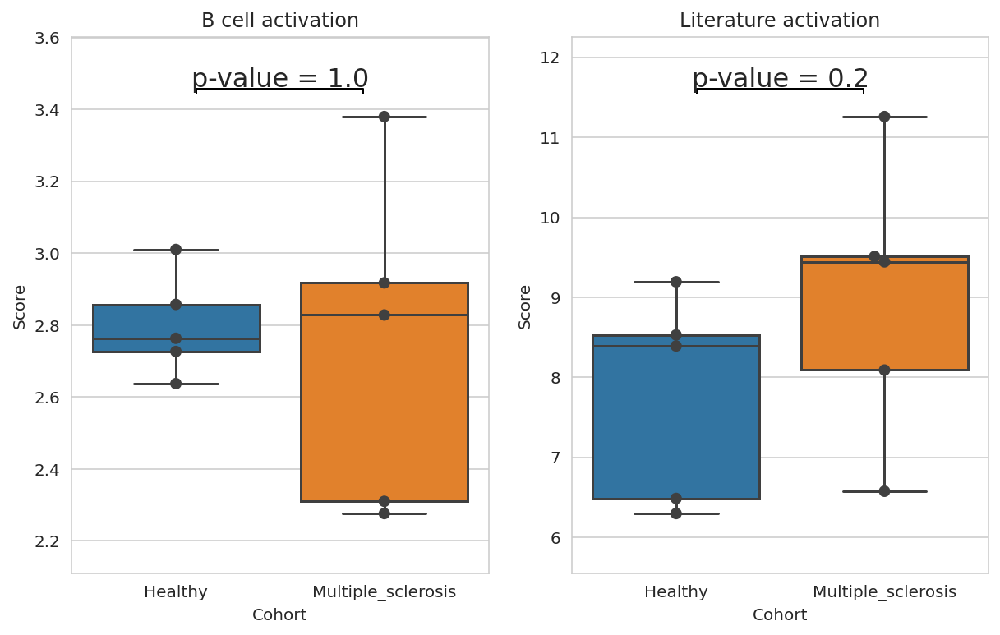

In [44]:
signature_analysis( data2 = expr_TPM[dict_illness['Healthy']],
                   data1 = expr_TPM[dict_illness['Multiple_sclerosis']],
                   label2 = 'Healthy', 
                   label1 = 'Multiple_sclerosis',
                  order = ['Healthy', 'Multiple_sclerosis'])

In [45]:
check = expr_TPM[dict_illness['Multiple_sclerosis']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Multiple_sclerosis']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

FCRL5 0.0
KLHL14 0.22455659122231747
FCRL2 0.6147253132315202
FCRL1 0.0
FCRLA 0.181018654124419
TNFRSF13B 0.1236500049961818
CD22 81.12686353417175


In [46]:
expr_counts_GSE123496_2 = read_expressions(cells_GSE123496_2, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [47]:
#для всех генов

list_edgeR = []
control = 'Healthy'
interest = 'Multiple_sclerosis'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE123496_2, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[                      logFC     logCPM        PValue       FDR
 HSPA1B             3.270342  11.331974  3.123121e-07  0.003341
 HSPA6              5.081137  6.148987   3.330349e-07  0.003341
 CHI3L2             4.486138  4.067323   8.313682e-07  0.005560
 HSPA1A             3.391836  10.752571  1.399907e-06  0.007021
 IGHG1              5.491771  5.220799   3.206063e-06  0.012864
 ...                     ...       ...            ...       ...
 XAGE2              0.000000 -3.745568   1.000000e+00  1.000000
 XAGE5              0.000000 -3.745568   1.000000e+00  1.000000
 XXbac-BPG116M5.17  0.000000 -3.745568   1.000000e+00  1.000000
 ZCCHC13            0.000000 -3.745568   1.000000e+00  1.000000
 ZP4                0.000000 -3.745568   1.000000e+00  1.000000
 
 [20062 rows x 4 columns]]

In [48]:
stimulation_expr_edgeR_GSE123496_2 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE123496_2.columns = ['parietal cortex']
stimulation_expr_edgeR_GSE123496_2 = stimulation_expr_edgeR_GSE123496_2.loc[stimulation_expr_edgeR_GSE123496_2.index.isin(my_genes)]
stimulation_expr_edgeR_GSE123496_2.head()

,parietal cortex
FCRL5,3.610607
FCRL1,3.684901
TNFRSF13B,-0.791880
CD22,0.538836
FCRL2,0.778975


<AxesSubplot:>

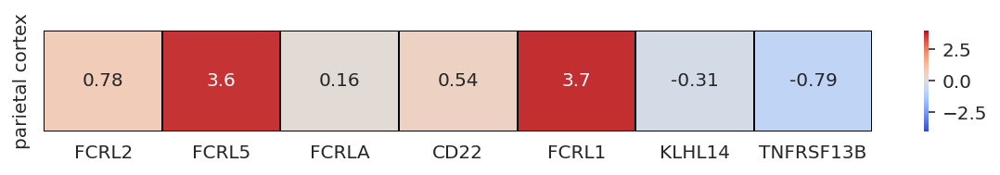

In [49]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE123496_2.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

## corpus callosum

In [303]:
cells_GSE123496_3 = cells_GSE123496.loc[cells_GSE123496.Tissue_name == 'corpus callosum']
cells_GSE123496_3

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX5122430,SRR8307929,GSE123496,corpus callosum,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505486,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 1,F,57.6,NaN,31040210,polyA RNA,SINGLE,21290990.71,NaN,NaN,NaN,5.250000,NaN,NaN,NaN,59904.0,43462.0,58591.0,42239.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122435,SRR8307934,GSE123496,corpus callosum,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505491,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 2,F,57.6,NaN,31040210,polyA RNA,SINGLE,25534495.69,NaN,NaN,NaN,5.250000,NaN,NaN,NaN,59923.0,43481.0,58610.0,42258.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122440,SRR8307939,GSE123496,corpus callosum,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505496,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 3,F,57.6,NaN,31040210,polyA RNA,SINGLE,36766727.35,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59929.0,43487.0,58616.0,42264.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122445,SRR8307944,GSE123496,corpus callosum,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505501,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 4,F,57.6,NaN,31040210,polyA RNA,SINGLE,41093454.84,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59896.0,43454.0,58583.0,42231.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122450,SRR8307949,GSE123496,corpus callosum,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505506,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 5,F,57.6,NaN,31040210,polyA RNA,SINGLE,36637553.61,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59910.0,43468.0,58597.0,42245.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122455,SRR8307954,GSE123496,corpus callosum,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505511,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 6,F,56.2,NaN,31040210,polyA RNA,SINGLE,23882211.47,NaN,NaN,NaN,5.250000,NaN,NaN,NaN,59926.0,43484.0,58613.0,42261.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122460,SRR8307959,GSE123496,corpus callosum,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505516,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 7,F,56.2,NaN,31040210,polyA RNA,SINGLE,39225179.59,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59920.0,43478.0,58607.0,42255.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122465,SRR8307964,GSE123496,corpus callosum,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505521,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 8,F,56.2,NaN,31040210,polyA RNA,SINGLE,37156900.13,NaN,NaN,NaN,5.250000,NaN,NaN,NaN,59925.0,43483.0,58612.0,42260.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122470,SRR8307969,GSE123496,corpus callosum,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505526,NaN,NaN,NaN,TRIzol™ Reagent (Invitr

In [304]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE123496_3.Diagnosis.unique():
    dict_illness[illness] = cells_GSE123496_3[cells_GSE123496_3.Diagnosis == illness].index

dict_illness

{'Multiple_sclerosis': Index(['SRX5122430', 'SRX5122435', 'SRX5122440', 'SRX5122445', 'SRX5122450'], dtype='object', name='Sample'),
 'Healthy': Index(['SRX5122455', 'SRX5122460', 'SRX5122465', 'SRX5122470', 'SRX5122475'], dtype='object', name='Sample')}

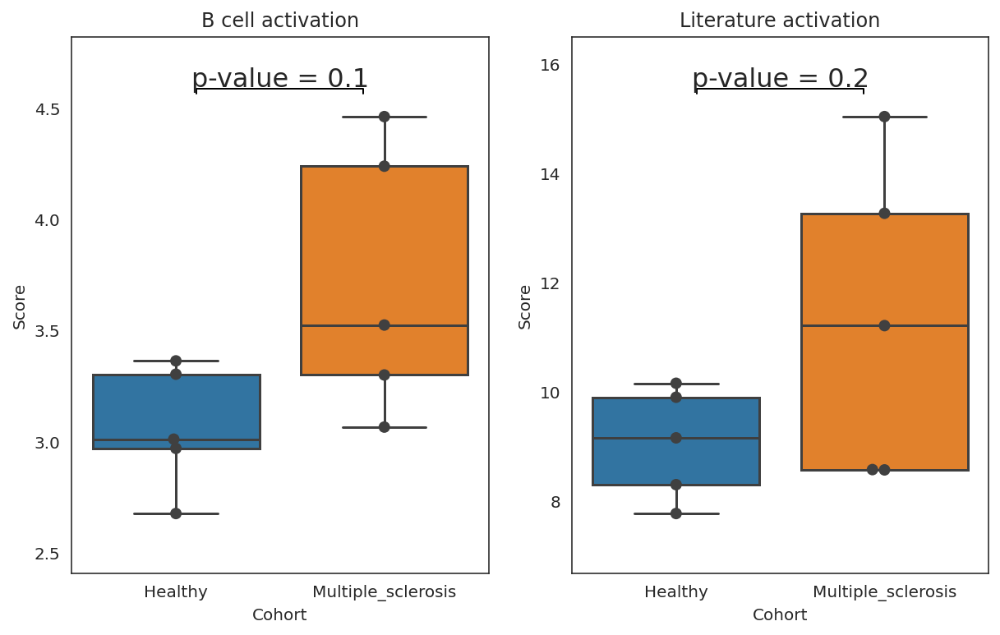

In [305]:
signature_analysis( data2 = expr_TPM[dict_illness['Healthy']],
                   data1 = expr_TPM[dict_illness['Multiple_sclerosis']],
                   label2 = 'Healthy', 
                   label1 = 'Multiple_sclerosis',
                  order = ['Healthy', 'Multiple_sclerosis'])

In [306]:
check = expr_TPM[dict_illness['Multiple_sclerosis']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Multiple_sclerosis']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

TNFRSF13B 0.7865080772858034
FCRL5 0.4369183039477537
KLHL14 0.125940093963497
FCRL1 0.0
CD22 141.88840054252142
FCRLA 0.9131343609313092
FCRL2 0.562905310712736


In [307]:
expr_counts_GSE123496_3 = read_expressions(cells_GSE123496_3, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [308]:
#для всех генов

list_edgeR = []
control = 'Healthy'
interest = 'Multiple_sclerosis'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE123496_3, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[                      logFC    logCPM        PValue           FDR
 BAG3               3.407912  7.804785  8.665279e-17  1.738428e-12
 IGKV2D-28          8.439758  2.300569  2.515792e-15  2.523591e-11
 IGHM               4.394920  3.277956  3.368937e-13  2.252921e-09
 OPALIN            -3.415243  7.523073  5.862815e-13  2.921419e-09
 IGHG3              6.127412  5.379552  7.280976e-13  2.921419e-09
 ...                     ...       ...           ...           ...
 XAGE5              0.000000 -4.084515  1.000000e+00  1.000000e+00
 XXbac-BPG116M5.17  0.000000 -4.084515  1.000000e+00  1.000000e+00
 ZC2HC1B            0.000000 -4.084515  1.000000e+00  1.000000e+00
 ZFY                0.000000 -4.084515  1.000000e+00  1.000000e+00
 ZP4                0.000000 -4.084515  1.000000e+00  1.000000e+00
 
 [20062 rows x 4 columns]]

In [309]:
stimulation_expr_edgeR_GSE123496_3 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE123496_3.columns = ['corpus callosum']
stimulation_expr_edgeR_GSE123496_3 = stimulation_expr_edgeR_GSE123496_3.loc[stimulation_expr_edgeR_GSE123496_3.index.isin(my_genes)]
stimulation_expr_edgeR_GSE123496_3.head()

,corpus callosum
FCRL5,5.235152
FCRL2,1.938370
TNFRSF13B,-1.321470
FCRL1,-2.476320
CD22,-0.376968


<AxesSubplot:>

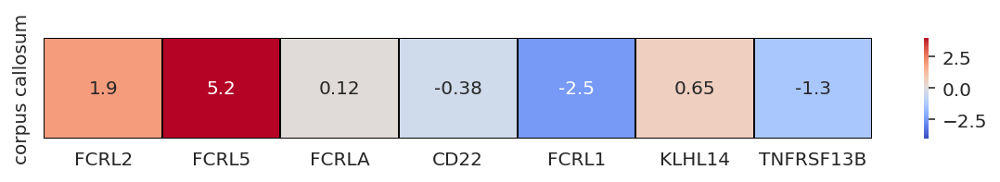

In [310]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE123496_3.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

## internal capsule

In [311]:
cells_GSE123496_4 = cells_GSE123496.loc[cells_GSE123496.Tissue_name == 'internal capsule']
cells_GSE123496_4

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX5122434,SRR8307933,GSE123496,internal capsule,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505490,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 1,F,57.6,NaN,31040210,polyA RNA,SINGLE,20996216.66,NaN,NaN,NaN,4.375000,NaN,NaN,NaN,59886.0,43444.0,58573.0,42221.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122439,SRR8307938,GSE123496,internal capsule,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505495,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 3,F,57.6,NaN,31040210,polyA RNA,SINGLE,29419057.44,NaN,NaN,NaN,4.958333,NaN,NaN,NaN,59897.0,43455.0,58584.0,42232.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122444,SRR8307943,GSE123496,internal capsule,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505500,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 3,F,57.6,NaN,31040210,polyA RNA,SINGLE,31451396.17,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59895.0,43453.0,58582.0,42230.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122449,SRR8307948,GSE123496,internal capsule,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505505,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 4,F,57.6,NaN,31040210,polyA RNA,SINGLE,30547481.33,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59899.0,43457.0,58586.0,42234.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122454,SRR8307953,GSE123496,internal capsule,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Multiple_sclerosis,GSM3505510,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 5,F,57.6,NaN,31040210,polyA RNA,SINGLE,24765920.91,NaN,NaN,NaN,4.958333,NaN,NaN,NaN,59911.0,43469.0,58598.0,42246.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122459,SRR8307958,GSE123496,internal capsule,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505515,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 6,F,56.2,NaN,31040210,polyA RNA,SINGLE,24933784.65,NaN,NaN,NaN,4.375000,NaN,NaN,NaN,59888.0,43446.0,58575.0,42223.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122464,SRR8307963,GSE123496,internal capsule,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505520,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 7,F,56.2,NaN,31040210,polyA RNA,SINGLE,28346560.03,NaN,NaN,NaN,5.833333,NaN,NaN,NaN,59909.0,43467.0,58596.0,42244.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122469,SRR8307968,GSE123496,internal capsule,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505525,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),KAPA Stranded RNA-Seq Library Preparation Kit (Roche),NaN,Donor 8,F,56.2,NaN,31040210,polyA RNA,SINGLE,28327648.16,NaN,NaN,NaN,5.250000,NaN,NaN,NaN,59915.0,43473.0,58602.0,42250.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX5122474,SRR8307973,GSE123496,internal capsule,NaN,Brain,Without_treatment,Without_therapy,Fresh-frozen,Healthy,GSM3505530,NaN,NaN,NaN,TRIzol™ Reagen

In [312]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE123496_4.Diagnosis.unique():
    dict_illness[illness] = cells_GSE123496_4[cells_GSE123496_4.Diagnosis == illness].index

dict_illness

{'Multiple_sclerosis': Index(['SRX5122434', 'SRX5122439', 'SRX5122444', 'SRX5122449', 'SRX5122454'], dtype='object', name='Sample'),
 'Healthy': Index(['SRX5122459', 'SRX5122464', 'SRX5122469', 'SRX5122474', 'SRX5122479'], dtype='object', name='Sample')}

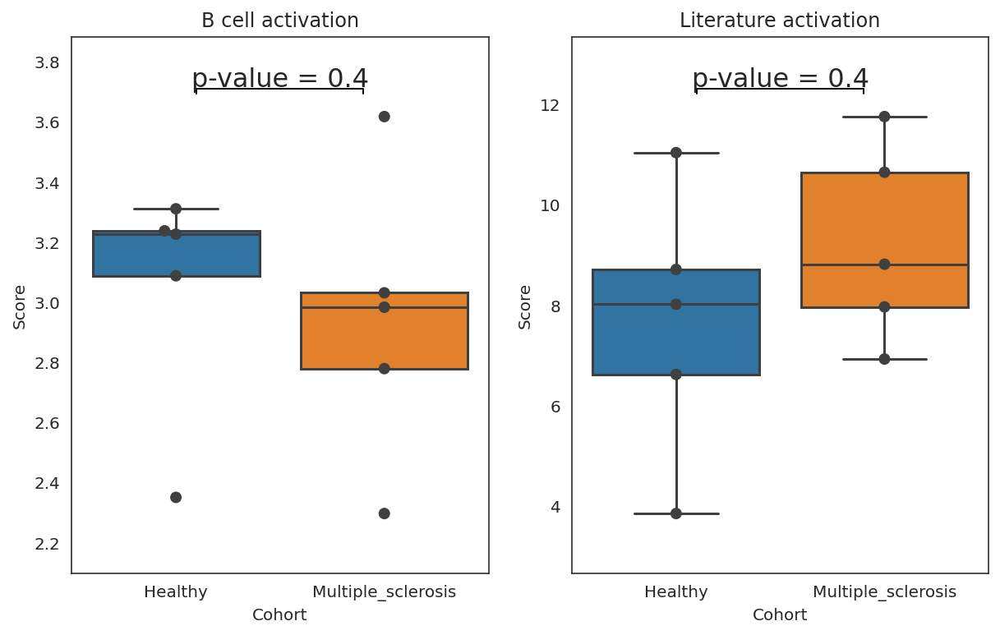

In [313]:
signature_analysis( data2 = expr_TPM[dict_illness['Healthy']],
                   data1 = expr_TPM[dict_illness['Multiple_sclerosis']],
                   label2 = 'Healthy', 
                   label1 = 'Multiple_sclerosis',
                  order = ['Healthy', 'Multiple_sclerosis'])

In [314]:
check = expr_TPM[dict_illness['Multiple_sclerosis']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Multiple_sclerosis']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

TNFRSF13B 0.7799331700874126
FCRL5 0.05213542761005391
KLHL14 0.0
FCRL1 0.0
CD22 281.9534504652419
FCRLA 0.9871046623580952
FCRL2 0.15544803949587643


In [315]:
expr_counts_GSE123496_4 = read_expressions(cells_GSE123496_4, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [316]:
#для всех генов

list_edgeR = []
control = 'Healthy'
interest = 'Multiple_sclerosis'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE123496_4, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[                     logFC    logCPM        PValue           FDR
 IGHG1             5.880299  5.504723  7.900481e-14  1.584994e-09
 IGKC              5.134343  4.795310  1.812660e-11  1.818279e-07
 HLA-DRB5          6.546844  4.921978  9.541556e-10  6.380757e-06
 IGKV2D-28         8.728211  0.163449  3.799442e-09  1.905610e-05
 IGLC3             7.232555  2.900347  7.885595e-09  3.164016e-05
 ...                    ...       ...           ...           ...
 XXbac-BPG32J3.20  0.000000 -3.683176  1.000000e+00  1.000000e+00
 ZCCHC5            0.000000 -3.683176  1.000000e+00  1.000000e+00
 ZFY               0.000000 -3.683176  1.000000e+00  1.000000e+00
 ZP4               0.000000 -3.683176  1.000000e+00  1.000000e+00
 ZPBP              0.000000 -3.683176  1.000000e+00  1.000000e+00
 
 [20062 rows x 4 columns]]

In [317]:
stimulation_expr_edgeR_GSE123496_4 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE123496_4.columns = ['internal capsule']
stimulation_expr_edgeR_GSE123496_4 = stimulation_expr_edgeR_GSE123496_4.loc[stimulation_expr_edgeR_GSE123496_4.index.isin(my_genes)]
stimulation_expr_edgeR_GSE123496_4.head()

,internal capsule
FCRL5,5.227791
TNFRSF13B,-1.338080
CD22,0.809262
FCRLA,0.531683
KLHL14,-0.443875


<AxesSubplot:>

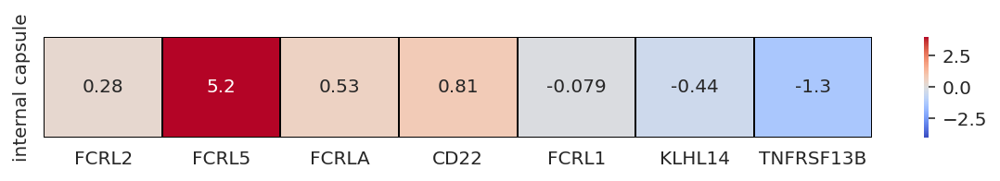

In [318]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE123496_4.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)

# GSE98422

In [246]:
cells_GSE98422 = cells[cells.Dataset == 'GSE98422']
cells_GSE98422

,Run,Dataset,Tissue_name,Extended_tissue_type,Organ,Stimulation,Therapy,Fixation,Diagnosis,GSM,Metastatic,Comment,Column_tissue_4,Rna_extraction_kit,Library_preparation_kit,Cells_isolation,Donor_id,Gender,Age,Age_range,PMID,Material_type,Layout,Readcounts,To_check,QC_bad,QC_good,QC_score,Who_checks,Decision,Expression_comment,Run_id,Sample_id,Run_tiledb_id,Sample_tiledb_id,Spike_in,Response,Material_sampling_time,Prior_medication,Prior_surgery,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRX2775111,SRR5494023,GSE98422,Renal_cells,human renal mesangial cells,Kidney,Without_stimulation,No_data,No_data,Healthy,GSM2595144,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),Illumina,NaN,T011,No_data,No_data,NaN,No_data,polyA RNA,PAIRED,15221292.77,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,65684.0,47746.0,63978.0,46189.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX2775112,SRR5494024,GSE98422,Renal_cells,human renal mesangial cells,Kidney,Without_stimulation,No_data,No_data,Healthy,GSM2595145,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),Illumina,NaN,T012,No_data,No_data,NaN,No_data,polyA RNA,PAIRED,17093515.32,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,65675.0,47737.0,63969.0,46180.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX2775113,SRR5494025,GSE98422,Renal_cells,human renal mesangial cells,Kidney,Without_stimulation,No_data,No_data,Healthy,GSM2595146,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),Illumina,NaN,T013,No_data,No_data,NaN,No_data,polyA RNA,PAIRED,13743389.89,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,65696.0,47758.0,63990.0,46201.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX2775114,SRR5494026,GSE98422,Renal_cells,human renal mesangial cells,Kidney,Without_stimulation,No_data,No_data,Healthy,GSM2595147,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),Illumina,NaN,T014,No_data,No_data,NaN,No_data,polyA RNA,PAIRED,14546612.70,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,65700.0,47762.0,63994.0,46205.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX2775115,SRR5494027,GSE98422,Renal_cells,human renal mesangial cells,Kidney,Without_stimulation,No_data,No_data,Healthy,GSM2595148,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),Illumina,NaN,T015,No_data,No_data,NaN,No_data,polyA RNA,PAIRED,16043713.08,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,65674.0,47736.0,63968.0,46179.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX2775116,SRR5494028,GSE98422,Renal_cells,human renal mesangial cells,Kidney,Without_stimulation,No_data,No_data,Healthy,GSM2595149,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),Illumina,NaN,T017,No_data,No_data,NaN,No_data,polyA RNA,PAIRED,16241996.41,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,65687.0,47749.0,63981.0,46192.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX2775117,SRR5494029,GSE98422,Renal_cells,human renal mesangial cells,Kidney,Without_stimulation,No_data,No_data,Healthy,GSM2595150,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),Illumina,NaN,T018,No_data,No_data,NaN,No_data,polyA RNA,PAIRED,16802309.33,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,65699.0,47761.0,63993.0,46204.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX2775118,SRR5494030,GSE98422,Renal_cells,human renal mesangial cells,Kidney,Without_stimulation,No_data,No_data,Systemic_lupus_erythematosus_with_kidney_involvement,GSM2595151,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),Illumina,NaN,T4813,No_data,No_data,NaN,No_data,polyA RNA,PAIRED,15704491.35,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,65691.0,47753.0,63985.0,46196.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX2775119,SRR5494031,GSE98422,Renal_cells,human renal mesangial cells,Kidney,Without_stimulation,No_data,No_data,Systemic_lupus_erythematosus_with_kidney_involvement,GSM2595152,NaN,NaN,NaN,TRIzol™ Reagent (Invitrogen),Illumina,NaN,T4814,No_data,No_data,NaN,No_data,polyA RNA,PAIRED,14177179.43,NaN,NaN,NaN,7.000000,NaN,NaN,NaN,65701.0,47763.0,63995.0,46206.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [247]:
cells_GSE98422.Extended_tissue_type.value_counts()

human renal mesangial cells    27
Name: Extended_tissue_type, dtype: int64

In [248]:
cells_GSE98422.Stimulation.value_counts()

Without_stimulation    27
Name: Stimulation, dtype: int64

In [249]:
cells_GSE98422.Therapy.value_counts()

No_data    27
Name: Therapy, dtype: int64

In [250]:
cells_GSE98422.Diagnosis.value_counts()

Systemic_lupus_erythematosus_with_kidney_involvement    20
Healthy                                                 7 
Name: Diagnosis, dtype: int64

In [251]:
cells_GSE98422.Material_type.value_counts()

polyA RNA    27
Name: Material_type, dtype: int64

In [252]:
expr_TPM = read_expressions(cells_GSE98422, suf='-kallisto-Xena-gene-TPM_without_noncoding.tsv')
expr_TPM = read_renorm_expressions(expr_TPM)

In [253]:
all_deconv_GSE98422 = model.predict(expr_TPM[cells_GSE98422.index])
all_deconv_GSE98422.head()

Expressions OK


,SRX2775111,SRX2775112,SRX2775113,SRX2775114,SRX2775115,SRX2775116,SRX2775117,SRX2775118,SRX2775119,SRX2775120,SRX2775121,SRX2775122,SRX2775123,SRX2775124,SRX2775125,SRX2775126,SRX2775127,SRX2775128,SRX2775129,SRX2775130,SRX2775131,SRX2775132,SRX2775133,SRX2775134,SRX2775135,SRX2775136,SRX2775137
Other,0.822163,0.239749,0.889635,0.797929,0.841640,0.769925,0.902128,0.855666,0.822312,0.656438,0.741182,0.822045,0.806004,0.866060,0.881944,0.924245,0.864853,0.799759,0.784380,0.885635,0.872576,0.802447,0.807127,0.656120,0.738198,0.728241,0.599586
Basophils,0.000000,0.006869,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000199,0.000935,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000048,0.000000,0.000000,0.000000,0.000000,0.000102,0.000000,0.000070,0.001147,0.000000
CD27neg_Memory_B_cells,0.000011,0.000779,0.000000,0.000263,0.000402,0.000641,0.000000,0.000423,0.000123,0.000907,0.000414,0.000489,0.000055,0.000000,0.000123,0.000000,0.000149,0.000258,0.000065,0.000056,0.000000,0.000059,0.000000,0.001162,0.000000,0.000397,0.000106
CD57neg_Cytotoxic_NK_cells,0.000838,0.000047,0.000249,0.001068,0.000121,0.000000,0.000172,0.000223,0.000697,0.000000,0.000000,0.001351,0.000385,0.000133,0.001193,0.000000,0.000223,0.000790,0.001244,0.001700,0.001826,0.003028,0.000000,0.000000,0.000000,0.000000,0.000000
CD57pos_Cytotoxic_NK_cells,0.005247,0.000242,0.000603,0.010890,0.004528,0.001551,0.000583,0.001922,0.012322,0.003533,0.004292,0.005087,0.008269,0.002811,0.000934,0.002373,0.003220,0.004493,0.007552,0.004881,0.003926,0.008966,0.002339,0.001930,0.006191,0.000219,0.003262


In [254]:
all_deconv_GSE98422['Mediana'] = 'nan'

for cell in all_deconv_GSE98422.index:
    counter = []
    for ind in cells_GSE98422.index:
        counter.append(all_deconv_GSE98422[ind][cell])
    all_deconv_GSE98422['Mediana'][cell] = my_median(counter)  

all_deconv_GSE98422.head()

,SRX2775111,SRX2775112,SRX2775113,SRX2775114,SRX2775115,SRX2775116,SRX2775117,SRX2775118,SRX2775119,SRX2775120,SRX2775121,SRX2775122,SRX2775123,SRX2775124,SRX2775125,SRX2775126,SRX2775127,SRX2775128,SRX2775129,SRX2775130,SRX2775131,SRX2775132,SRX2775133,SRX2775134,SRX2775135,SRX2775136,SRX2775137,Mediana
Other,0.822163,0.239749,0.889635,0.797929,0.841640,0.769925,0.902128,0.855666,0.822312,0.656438,0.741182,0.822045,0.806004,0.866060,0.881944,0.924245,0.864853,0.799759,0.784380,0.885635,0.872576,0.802447,0.807127,0.656120,0.738198,0.728241,0.599586,0.807127
Basophils,0.000000,0.006869,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000199,0.000935,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000048,0.000000,0.000000,0.000000,0.000000,0.000102,0.000000,0.000070,0.001147,0.000000,0
CD27neg_Memory_B_cells,0.000011,0.000779,0.000000,0.000263,0.000402,0.000641,0.000000,0.000423,0.000123,0.000907,0.000414,0.000489,0.000055,0.000000,0.000123,0.000000,0.000149,0.000258,0.000065,0.000056,0.000000,0.000059,0.000000,0.001162,0.000000,0.000397,0.000106,0.000122623
CD57neg_Cytotoxic_NK_cells,0.000838,0.000047,0.000249,0.001068,0.000121,0.000000,0.000172,0.000223,0.000697,0.000000,0.000000,0.001351,0.000385,0.000133,0.001193,0.000000,0.000223,0.000790,0.001244,0.001700,0.001826,0.003028,0.000000,0.000000,0.000000,0.000000,0.000000,0.000223209
CD57pos_Cytotoxic_NK_cells,0.005247,0.000242,0.000603,0.010890,0.004528,0.001551,0.000583,0.001922,0.012322,0.003533,0.004292,0.005087,0.008269,0.002811,0.000934,0.002373,0.003220,0.004493,0.007552,0.004881,0.003926,0.008966,0.002339,0.001930,0.006191,0.000219,0.003262,0.00353281


In [255]:
fig, ax = plt.subplots(figsize=(90, 30))
plt.ylabel('ylabel', fontsize=80)
sns.barplot(x=all_deconv_GSE98422['Mediana'].index, y=all_deconv_GSE98422['Mediana'], ax=ax)

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(50)
    
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(40)
    
plt.xticks(rotation=-90)
plt.title('Deconvolution median (GSE98422)', fontsize=100)
ax.get_xticklabels()[2].set_color("red")
ax.get_xticklabels()[8].set_color("red")
ax.get_xticklabels()[13].set_color("red")
ax.get_xticklabels()[18].set_color("red")
ax.get_xticklabels()[20].set_color("red")
ax.get_xticklabels()[21].set_color("red")
ax.get_xticklabels()[28].set_color("red")
ax.get_xticklabels()[36].set_color("red")

In [256]:
# в словарь записывает, какие сэмплы к каким стимуляциям относятся

dict_illness = {}
for illness in cells_GSE98422.Diagnosis.unique():
    dict_illness[illness] = cells_GSE98422[cells_GSE98422.Diagnosis == illness].index

dict_illness

{'Healthy': Index(['SRX2775111', 'SRX2775112', 'SRX2775113', 'SRX2775114', 'SRX2775115',
        'SRX2775116', 'SRX2775117'],
       dtype='object', name='Sample'),
 'Systemic_lupus_erythematosus_with_kidney_involvement': Index(['SRX2775118', 'SRX2775119', 'SRX2775120', 'SRX2775121', 'SRX2775122',
        'SRX2775123', 'SRX2775124', 'SRX2775125', 'SRX2775126', 'SRX2775127',
        'SRX2775128', 'SRX2775129', 'SRX2775130', 'SRX2775131', 'SRX2775132',
        'SRX2775133', 'SRX2775134', 'SRX2775135', 'SRX2775136', 'SRX2775137'],
       dtype='object', name='Sample')}

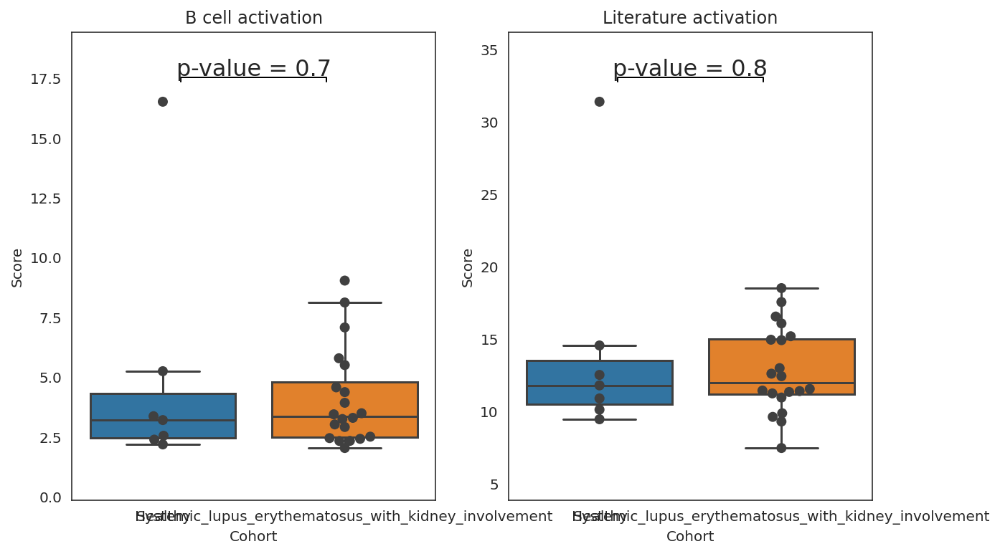

In [257]:
signature_analysis( data2 = expr_TPM[dict_illness['Healthy']],
                   data1 = expr_TPM[dict_illness['Systemic_lupus_erythematosus_with_kidney_involvement']],
                   label2 = 'Healthy', 
                   label1 = 'Systemic_lupus_erythematosus_with_kidney_involvement',
                  order = ['Healthy', 'Systemic_lupus_erythematosus_with_kidney_involvement'])

In [258]:
check = expr_TPM[dict_illness['Systemic_lupus_erythematosus_with_kidney_involvement']]
check1 = check.loc[check.index.isin(my_genes)]

for ind in check1.index:
    counter = []
    for col in dict_illness['Systemic_lupus_erythematosus_with_kidney_involvement']:
        counter.append(check1[col][ind])
    print(ind, my_median(counter))

TNFRSF13B 0.2582053775968357
FCRL5 1.2920629142334277
KLHL14 7.287359049012149
FCRL1 0.18948075619053772
CD22 1.6792496750454378
FCRLA 0.5321935840671252
FCRL2 0.428841472469184


In [261]:
expr_counts_GSE98422 = read_expressions(cells_GSE98422, suf='-kallisto-Xena-gene-est_counts_without_noncoding.tsv')

In [262]:
#для всех генов

list_edgeR = []
control = 'Healthy'
interest = 'Systemic_lupus_erythematosus_with_kidney_involvement'
DE = calculate_diff_expr_between_two_group(
                            expr_counts_GSE98422, 
                            dict_illness[control], 
                            dict_illness[interest], '')
list_edgeR.append(DE)

list_edgeR

[                     logFC    logCPM        PValue           FDR
 DUSP1            -3.630360  7.254415  6.078448e-54  1.219458e-49
 FOS              -6.587160  8.032891  7.700621e-49  7.724493e-45
 EGR1             -5.084202  7.466881  3.020398e-36  2.019841e-32
 NR4A2            -4.181618  3.546223  1.963029e-35  9.845571e-32
 FOSB             -8.030803  6.570009  7.466129e-35  2.995710e-31
 ...                    ...       ...           ...           ...
 XXbac-BPG32J3.19  0.000000 -2.966737  1.000000e+00  1.000000e+00
 ZCCHC13           0.000000 -2.966737  1.000000e+00  1.000000e+00
 ZIC4              0.000000 -2.966737  1.000000e+00  1.000000e+00
 ZNF645            0.000000 -2.966737  1.000000e+00  1.000000e+00
 ZNRF4             0.000000 -2.966737  1.000000e+00  1.000000e+00
 
 [20062 rows x 4 columns]]

In [263]:
stimulation_expr_edgeR_GSE98422 = pd.concat([x[['logFC']] for x in list_edgeR], axis=1)
stimulation_expr_edgeR_GSE98422.columns = ['GSE98422']
stimulation_expr_edgeR_GSE98422 = stimulation_expr_edgeR_GSE98422.loc[stimulation_expr_edgeR_GSE98422.index.isin(my_genes)]
stimulation_expr_edgeR_GSE98422.head()

,GSE98422
CD22,-1.133168
FCRL1,-1.972686
FCRLA,-1.098584
FCRL2,-0.729478
TNFRSF13B,-0.598021


<AxesSubplot:>

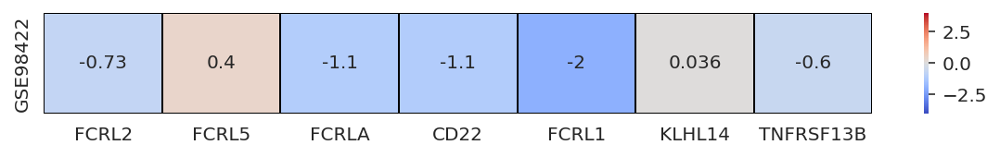

In [264]:
plt.figure(figsize=(10,1))
plt.rc('ytick', labelsize=10)
plt.rc('xtick', labelsize=10)
sns.heatmap(stimulation_expr_edgeR_GSE98422.loc[my_genes, :].T, annot = True, vmin=-4, vmax=4, center =0,
                cmap= 'coolwarm',  linewidths=1, linecolor='black', xticklabels=True, cbar=True)